In [1]:
import os, sys
import numpy as np
import matplotlib.pyplot as plt

In [2]:
%matplotlib notebook

In [3]:
sys.path.append('../readmaroc')

In [4]:
from maroc_data import MarocData

In [5]:
from functools import partial

In [6]:
from scipy.stats import norm

In [7]:
input_dat = '../data/0806/Run000092044.dat'

In [8]:
marocdata = MarocData(input_dat)

In [9]:
y_offset = [12000, 10000, 8000, 4000, 2000]

plt.figure(figsize=(12,10))
for i, triplet in enumerate(np.arange(1,16).reshape(5,3)):
    for j, board in enumerate(triplet):
        if board in marocdata.active_boards:
            plt.plot(np.arange(0+(j*320), 320+320*j), 
                     (marocdata.get_board(board).get_event(584).signal)+y_offset[i])
        plt.text((320+320*j-0+(j*320))/2, y_offset[i], 'board {}'.format(board), size='small'
                )
plt.title('y layers')
plt.yticks(y_offset, ['layer 0','layer 1', 'layer 2', 'layer 3', 'layer 4'], size='large')
plt.xticks([0, 320, 640, 960])
plt.xlabel('strips', size='large')
plt.show()

plt.figure(figsize=(12,10))
for i, triplet in enumerate(np.arange(16,31).reshape(5,3)):
    for j, board in enumerate(triplet):
        if board in marocdata.active_boards:
            plt.plot(np.arange(0+(j*320), 320+320*j), 
                     (marocdata.get_board(board).get_event(53).signal)+y_offset[i])
        plt.text((320+320*j-0+(j*320))/2, y_offset[i], 'board {}'.format(board), size='small')
plt.title('x layers')
plt.yticks(y_offset, ['layer 0','layer 1', 'layer 2', 'layer 3', 'layer 4'], size='large')
plt.xticks([0, 320, 640, 960])
plt.xlabel('strips', size='large')
plt.show()

In [10]:
def plot_event(evt, marocdata):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,10), sharey=True, sharex=True)
    for i, (triplet_y, triplet_x) in enumerate(zip(np.arange(1, 16).reshape(5, 3), 
                                                   np.arange(16,31).reshape(5,3))):
        for j, (board_y, board_x) in enumerate(zip(triplet_y, triplet_x)):
            if board_y in marocdata.active_boards:
                if evt in marocdata.get_board(board_y):
                    signal = marocdata.get_board(board_y).get_event(evt).signal
                    ax1.text((320+320*j-0+(j*320))/2 -150, y_offset[i]-250, 'board {}, TS: {} '.format(board_y, marocdata.get_board(board_y).get_event(evt).TS), size='small')
                    if np.max(signal)>2000:
                        signal = signal*0.45
                    ax1.plot(np.arange(0+(j*320), 320+320*j), 
                             (signal)+y_offset[i], color='blue', linewidth=1)
                    ax1.axvline(320*(j+1), linestyle='--', linewidth=.75, color='grey', alpha=.5)
                else:
                    pass
            if board_x in marocdata.active_boards:
                if evt in marocdata.get_board(board_x):
                    signal = marocdata.get_board(board_x).get_event(evt).signal
                    ax2.text((320+320*j-0+(j*320))/2 -150, y_offset[i]-250, 'board {}, TS:{} '.format(board_x, marocdata.get_board(board_x).get_event(evt).TS), size='small')
                    if np.max(signal)>2000:
                        signal = signal*0.45
                    ax2.plot(np.arange(0+(j*320), 320+320*j), 
                             (signal)+y_offset[i], color='red', linewidth=1)
                    ax2.axvline(320*(j+1), linestyle='--', linewidth=.75, color='grey', alpha=.5)
                else:
                    pass
            
    ax1.set_title('y layers', size='x-large')
    ax2.set_title('x layers', size='x-large')
    plt.yticks(y_offset, ['layer 0','layer 1', 'layer 2', 'layer 3', 'layer 4'], size='x-large')
    plt.xticks([0, 320, 640, 960])
    fig.text(.5, .05, 'strips', size='large')
    fig.text(.5, .95, 'Evt {}'.format(evt), size='large')
    plt.ylim(1000, 13000)
    return fig, ax1, ax2




In [11]:
import matplotlib.backends.backend_pdf
pdf = matplotlib.backends.backend_pdf.PdfPages("output.pdf")
for evt in event_ids_over_theshold:
    fig, ax1, ax2 = plot_event(evt, marocdata)
    pdf.savefig(fig)
    plt.close(fig)
pdf.close()
plt.close()

NameError: name 'event_ids_over_theshold' is not defined

In [ ]:
for evt in event_ids_over_theshold:
    fig, ax1, ax2 = plot_event(evt, marocdata)
    plt.show()

In [ ]:
input_sept = '../data/sept/Run000122950.dat'
marocdata_sept = MarocData(input_sept)


In [ ]:
len(event_ids_over_theshold)

In [ ]:
pdf = matplotlib.backends.backend_pdf.PdfPages("output_sept.pdf")
for evt in event_ids_over_theshold:
    fig, ax1, ax2 = plot_event(evt, marocdata_sept)
    pdf.savefig(fig)
    plt.close(fig)
pdf.close()
plt.close()

In [ ]:
from functools import partial
def overthreshold(marocdata, event_id):
    events = marocdata.get_event(event_id)
    count = 0
    for board_id, event in events:
        
        if event is None:
            continue
        board = marocdata.get_board(board_id)
        pedestal = board.avg_data
        noise = board.noise
        mu, std = norm.fit(noise)
        signal = event.signal
        if np.any(signal-pedestal>=200+(mu+5*std)):
            count+=1
    if count>=2:
        return True
    return False



In [ ]:
event_ids_over_theshold = list(filter(partial(overthreshold, marocdata), range(1, marocdata.max_evt+1)))

In [ ]:
len(event_ids_over_theshold)

In [ ]:
from scipy.signal import find_peaks

In [ ]:
peaks = find_peaks(data, height=100)

In [ ]:
np.any(peaks[1]['peak_heights']>600)

In [ ]:
plt.plot(range(320), data)
plt.plot(peaks[0], data[peaks[0]])
plt.show()

from functools import partial
def overthreshold_peaks(marocdata, event_id):
    events = marocdata.get_event(event_id)
    count=0
    for board_id, event in events:
        if event is None:
            continue
        board = marocdata.get_board(board_id)
        signal = event.signal
        peaks = find_peaks(signal, height=100)
        if np.any(peaks[1]['peak_heights']>600):
            count+=1
    if count>=2:
        return True
    return False

event_ids_over_theshold = list(filter(partial(overthreshold_peaks, marocdata), range(1, marocdata.max_evt+1)))

for evt in event_ids_over_theshold:
    fig, ax1, ax2 = plot_event(evt, marocdata)
    plt.show()

In [23]:
first = np.where(marocdata.n_events_per_board[:,1]==marocdata.max_evt)[0][0]
ts_clean_first = marocdata.get_board(first).clean_timestamps
indices_boards = []
indices_first = []
for board in marocdata.active_boards[marocdata.active_boards!=first]:
    sel_ts, idx_first, idx_board = np.intersect1d(marocdata.get_board(first).clean_timestamps, 
                         marocdata.get_board(board).clean_timestamps, return_indices=True)
    indices_boards.append(idx_board)
    indices_first.append(idx_first)
    print(board, idx_board.shape)

1 (1150,)
2 (829,)
3 (522,)
4 (491,)
5 (525,)
6 (828,)
7 (518,)
8 (831,)
9 (1149,)
10 (889,)
11 (906,)
12 (1181,)
13 (590,)
14 (304,)
15 (546,)
16 (515,)
17 (493,)
18 (1,)
19 (1167,)
20 (1105,)
22 (545,)
23 (1166,)
24 (1161,)
25 (876,)
26 (888,)
28 (543,)
29 (886,)
30 (887,)


In [13]:
sel_ts, idx_first, idx_28 = np.intersect1d(marocdata.get_board(first).clean_timestamps, 
               marocdata.get_board(28).clean_timestamps, return_indices=True)

In [14]:
marocdata.get_board(first).event_ids[idx_first]

array([   1,    3,    4,    6,    8,    9,   17,   18,   19,   21,   22,
         25,   27,   29,   33,   36,   39,   40,   41,   47,   49,   50,
         51,   52,   53,   59,   60,   64,   66,   68,   71,   76,   78,
         79,   81,   82,   86,   88,   91,   92,   93,   95,   96,   97,
         98,   99,  100,  101,  102,  104,  107,  109,  111,  112,  113,
        115,  116,  117,  120,  122,  123,  126,  127,  129,  131,  132,
        133,  135,  139,  145,  147,  149,  156,  157,  159,  160,  161,
        164,  165,  167,  168,  169,  172,  173,  174,  175,  178,  179,
        180,  181,  184,  185,  186,  188,  189,  190,  191,  193,  194,
        195,  197,  200,  205,  206,  207,  211,  212,  213,  217,  218,
        221,  230,  232,  234,  236,  237,  241,  242,  245,  246,  250,
        251,  254,  256,  257,  259,  260,  261,  262,  263,  268,  269,
        270,  271,  274,  275,  278,  279,  281,  284,  285,  287,  291,
        292,  295,  296,  297,  301,  303,  307,  3

In [15]:
marocdata.get_board(28).event_ids[idx_first]

array([   1,    3,    4,    6,    8,    9,   17,   18,   19,   21,   22,
         25,   27,   29,   33,   36,   39,   40,   41,   47,   49,   50,
         51,   52,   53,   59,   60,   64,   66,   68,   71,   74,   76,
         77,   79,   80,   84,   86,   89,   90,   91,   93,   94,   95,
         96,   97,   98,   99,  100,  102,  105,  107,  109,  110,  111,
        113,  114,  115,  118,  120,  121,  124,  125,  127,  129,  130,
        131,  133,  137,  143,  145,  147,  154,  155,  157,  158,  159,
        162,  163,  165,  166,  167,  170,  171,  172,  173,  176,  177,
        178,  179,  182,  183,  184,  186,  187,  188,  189,  191,  192,
        193,  195,  198,  203,  204,  205,  209,  210,  211,  215,  216,
        219,  228,  230,  232,  234,  235,  239,  240,  243,  244,  248,
        249,  252,  254,  255,  257,  258,  259,  260,  261,  266,  267,
        268,  269,  272,  273,  276,  277,  279,  282,  283,  285,  289,
        290,  293,  294,  295,  299,  301,  305,  3

In [21]:
indices_first

[array([   1,    2,    3, ..., 1186, 1187, 1188]),
 array([   1,    3,    4,    6,    8,    9,   10,   11,   14,   15,   16,
          17,   18,   19,   20,   21,   22,   23,   25,   26,   27,   28,
          29,   32,   33,   35,   36,   39,   40,   41,   42,   43,   47,
          48,   49,   50,   51,   52,   53,   57,   59,   60,   61,   62,
          63,   64,   66,   68,   70,   71,   74,   75,   76,   77,   79,
          80,   81,   83,   84,   86,   88,   89,   90,   91,   92,   93,
          94,   95,   96,   97,   98,   99,  100,  102,  105,  106,  107,
         109,  110,  111,  112,  113,  114,  115,  116,  119,  120,  121,
         124,  125,  126,  127,  128,  129,  130,  131,  133,  134,  136,
         137,  142,  143,  145,  147,  149,  153,  154,  155,  157,  158,
         159,  160,  162,  163,  165,  166,  167,  169,  170,  171,  172,
         173,  175,  176,  177,  178,  179,  182,  183,  184,  185,  186,
         187,  188,  189,  191,  192,  193,  195,  197,  198,

In [27]:
marocdata.get_board(8).get_event(548).TS - marocdata.get_board(8).get_event(1).TS

1214984643

In [28]:
marocdata.get_board(9).get_event(548).TS - marocdata.get_board(9).get_event(1).TS

1214984643

In [10]:
clean_ts_tot = []
for board in marocdata.active_boards:
    clean_ts = marocdata.get_board(board).clean_timestamps
    clean_ts_tot.append(clean_ts)
clean_ts_tot = np.hstack(clean_ts_tot)

In [11]:
marocdata.get_clean_ts()

[4273783853          0    5806702 ... 2574290915 2574887104 2579265437]
[4273783853          0    5806702 ... 2574290915 2574887104 2579265437]


[(1,
  array([4192547028,          0,     560399, ..., 2572197710, 2574851315,
         2575447503], dtype=uint32)),
 (2,
  array([4155181435,          0,     560400, ..., 2572197711, 2574851315,
         2575447504], dtype=uint32)),
 (3,
  array([4250240749,          0,     560400, ..., 2572197711, 2574851315,
         2575447504], dtype=uint32)),
 (4,
  array([4055412391,          0,     560400, ..., 2572197711, 2574851315,
         2575447504], dtype=uint32)),
 (5,
  array([4010752061,          0,     560400, ..., 2572197711, 2574851315,
         2575447504], dtype=uint32)),
 (6,
  array([3948555251,          0,     560400, ..., 2572197711, 2574851315,
         2575447504], dtype=uint32)),
 (7,
  array([3902555260,          0,     560400, ..., 2575447504, 2579825837,
         2581979960], dtype=uint32)),
 (8,
  array([3857454605,          0,     560400, ..., 2574851315, 2575447504,
         2579825837], dtype=uint32)),
 (9,
  array([3431225627,          0,     560399, ..., 257219771

In [12]:
plt.hist(np.unique(clean_ts_tot, bins=1000)
plt.show()

/usr/local/lib/python3.9/site-packages/numpy/core/_asarray.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order, subok=True)


ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [ ]:

evt = np.where((marocdata.get_board(board_y).clean_timestamps==ts) 

In [46]:
marocdata.get_board(8).clean_timestamps[2]

560400

In [47]:
marocdata.get_board(9).clean_timestamps[2]

560399

In [ ]:
np.where(marocdata.get_board(8).clean_timestamps==560400)

In [ ]:
np.where(marocdata.get_board(8).clean_timestamps[2])

In [90]:
def plot_event_ts(ts, marocdata):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,8), sharey=True, sharex=True)
    evt = None
    for i, (triplet_y, triplet_x) in enumerate(zip(np.arange(1, 16).reshape(5, 3), 
                                                   np.arange(16,31).reshape(5,3))):
        for j, (board_y, board_x) in enumerate(zip(triplet_y, triplet_x)):
            if board_y in marocdata.active_boards:
                yboard = marocdata.get_board(board_y)
                tts = ts if ts in yboard.clean_timestamps else ts+1 if ts+1 in yboard.clean_timestamps else None
                if tts is None: 
                    continue 
                evt = np.where((yboard.clean_timestamps==tts))[0][0] 
                print(evt)
                if evt in yboard:
                    signal = yboard.get_event(evt).signal
                    ax1.text((320+320*j-0+(j*320))/2 -150, 
                             y_offset[i]-250, 'b: {}, TS: {} '.format(board_y, tts), size='small')
                    if np.max(signal)>2000:
                        signal = signal*0.45
                    ax1.plot(np.arange(0+(j*320), 320+320*j), 
                             (signal)+y_offset[i], color='blue', linewidth=1)
                    ax1.axvline(320*(j+1), linestyle='--', linewidth=.75, color='grey', alpha=.5)
               
            if board_x in marocdata.active_boards:
                xboard = marocdata.get_board(board_x)
                tts = ts if ts in xboard.clean_timestamps else ts+1 if ts+1 in xboard.clean_timestamps else None
                if tts is None: 
                    continue
                evt = np.where((xboard.clean_timestamps==tts))[0][0]
                if evt in xboard:
                    signal = xboard.get_event(evt).signal
                    ax2.text((320+320*j-0+(j*320))/2 -150, 
                             y_offset[i]-250, 'b: {}, TS:{} '.format(board_x, tts), size='small')
                    if np.max(signal)>2000:
                        signal = signal*0.45
                    ax2.plot(np.arange(0+(j*320), 320+320*j), 
                             (signal)+y_offset[i], color='red', linewidth=1)
                    ax2.axvline(320*(j+1), linestyle='--', linewidth=.75, color='grey', alpha=.5)
            
    if (evt is None):
        return None # skip
    ax1.set_title('y layers', size='x-large')
    ax2.set_title('x layers', size='x-large')
    plt.yticks(y_offset, ['layer 0','layer 1', 'layer 2', 'layer 3', 'layer 4'], size='x-large')
    plt.xticks([0, 320, 640, 960])
    fig.text(.5, .05, 'strips', size='large')
    fig.text(.5, .95, 'Evt {}'.format(evt), size='large')
    plt.ylim(1000, 13000)
    plt.xlim(-100,1060)
    return fig, ax1, ax2

TS  0 

<IPython.core.display.Javascript object>


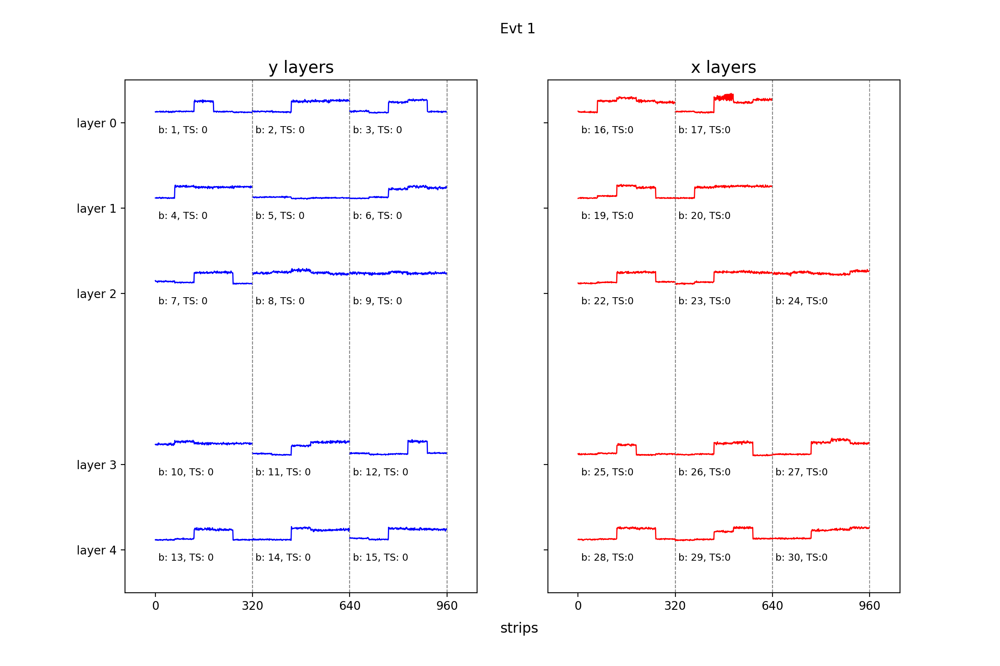

1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
DONE
TS  560399 

<IPython.core.display.Javascript object>


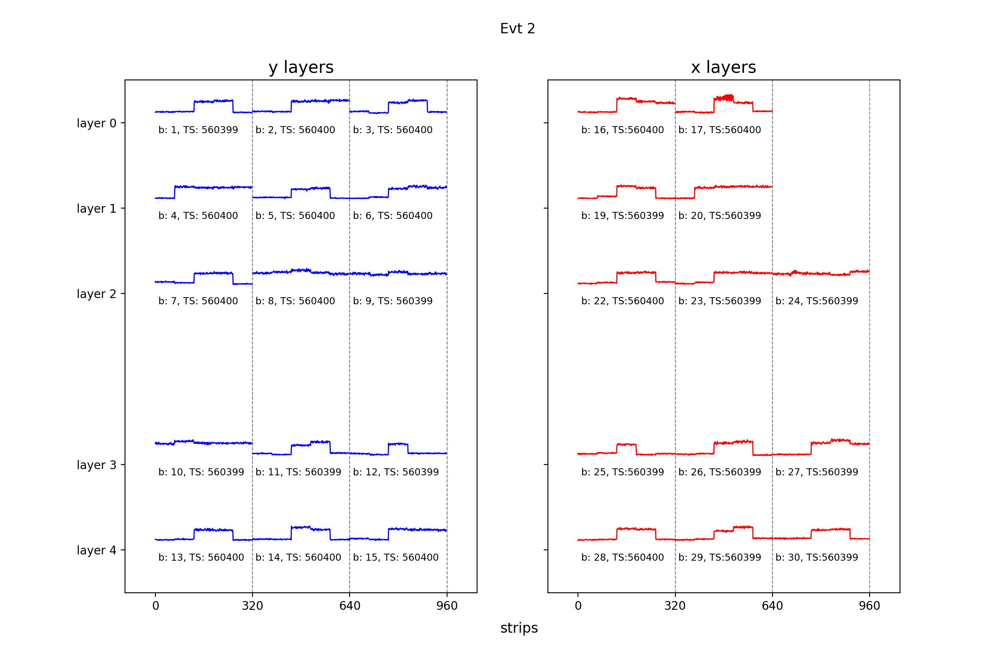

2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
DONE
SKIPPING 560400
TS  5806702 

<IPython.core.display.Javascript object>


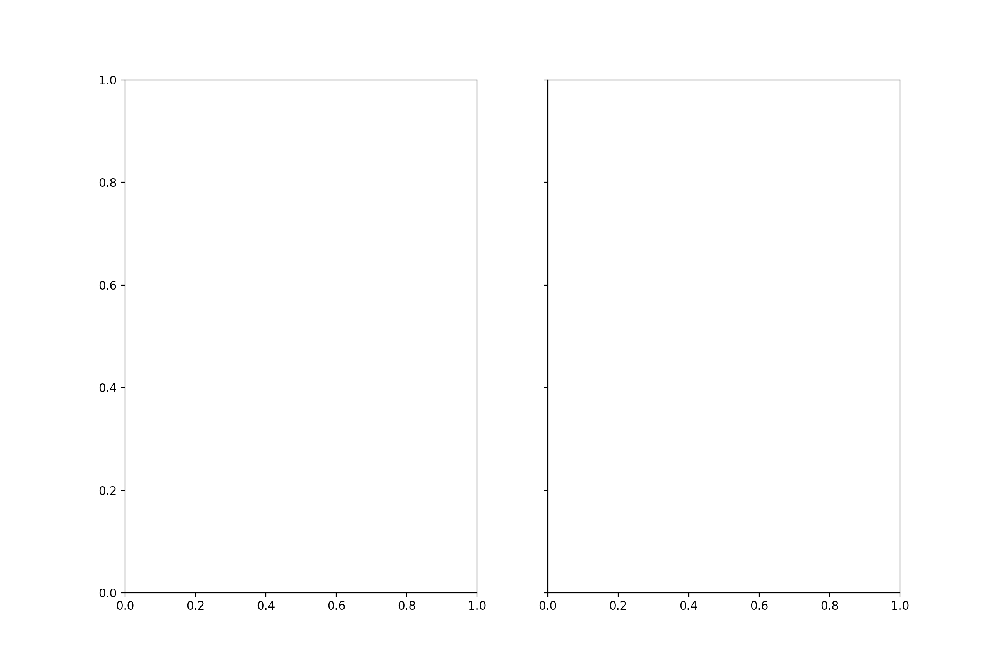

TS  6367101 

<IPython.core.display.Javascript object>


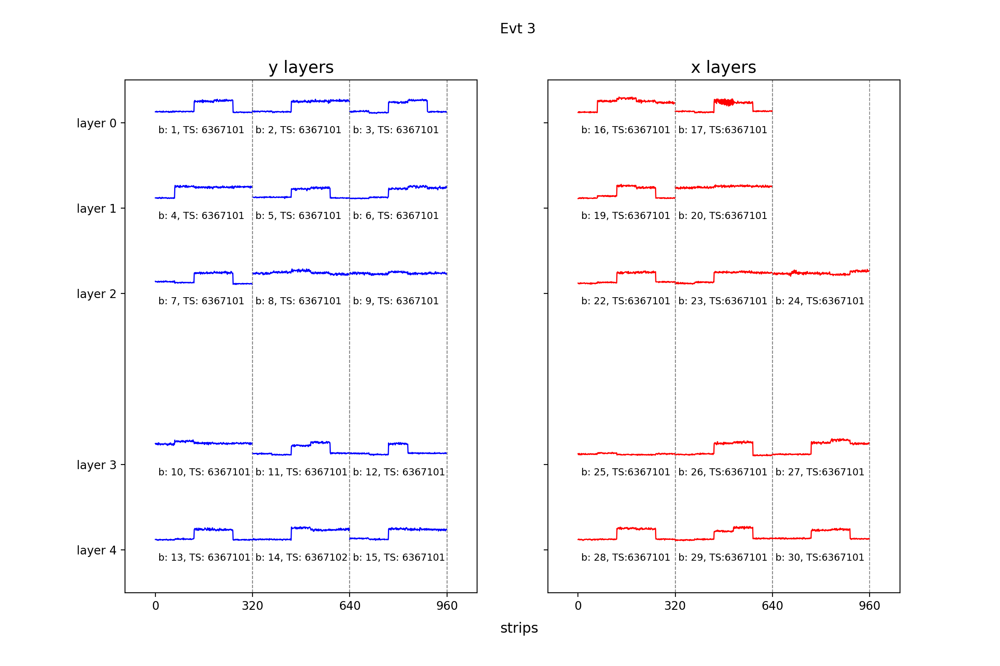

3
3
3
3
3
3
3
3
3
3
3
3
3
3
3
DONE
SKIPPING 6367102
TS  6873639 

<IPython.core.display.Javascript object>


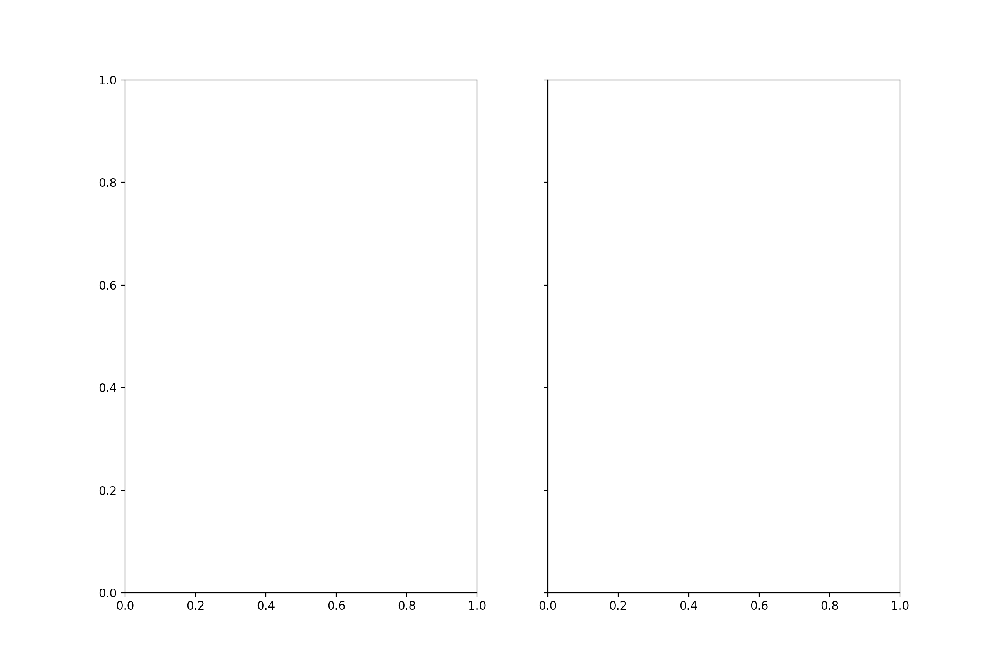

TS  7434038 

<IPython.core.display.Javascript object>


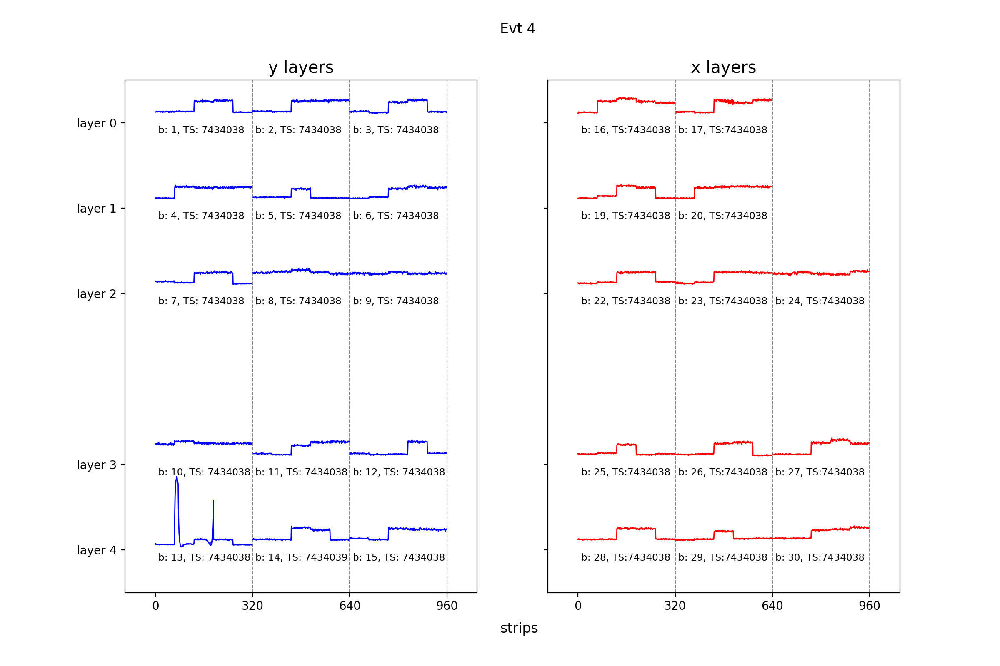

4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
DONE
SKIPPING 7434039
TS  12703194 

<IPython.core.display.Javascript object>


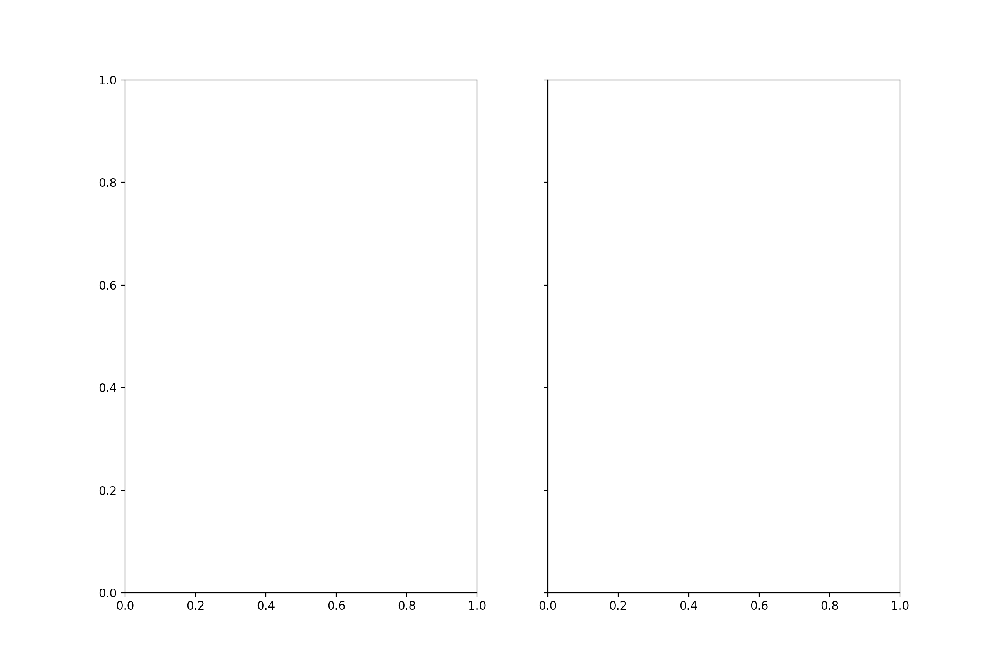

In [91]:
last_ts = None
for i, ts in enumerate(np.unique(clean_ts_tot)):
    if (i == 10):
        break
    if (last_ts is not None and last_ts+1 == ts):
        print("SKIPPING {}".format(ts))
        continue
    print("TS ", ts, end=" ")
    plot_comps = plot_event_ts(ts, marocdata)
    if (plot_comps is None):    
        continue
    fig, ax1, ax2 = plot_comps
    print("DONE")
    plt.show()
    last_ts = ts

<IPython.core.display.Javascript object>


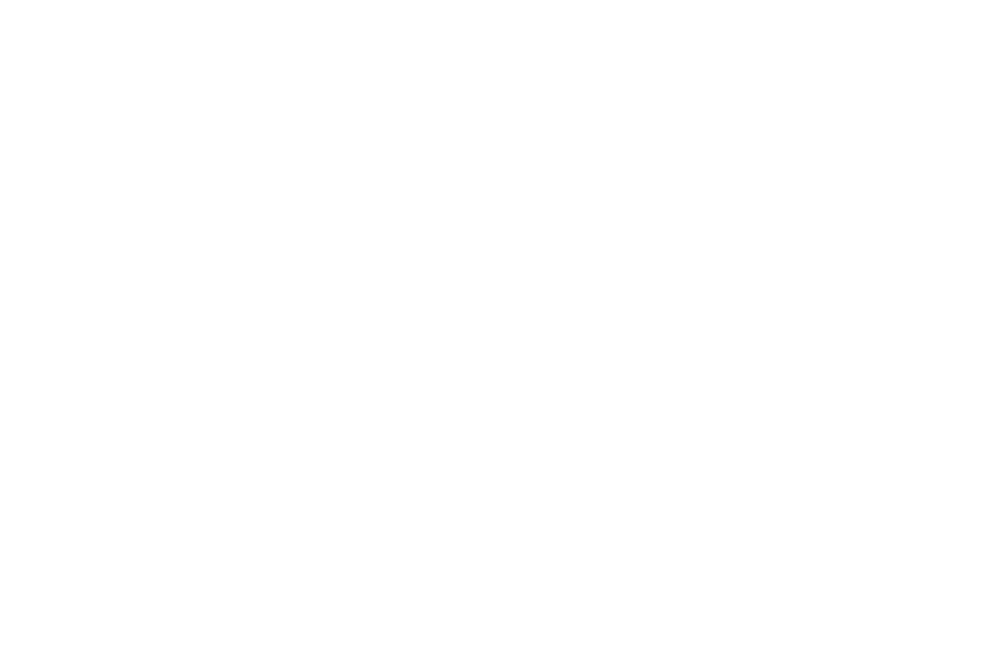

<IPython.core.display.Javascript object>


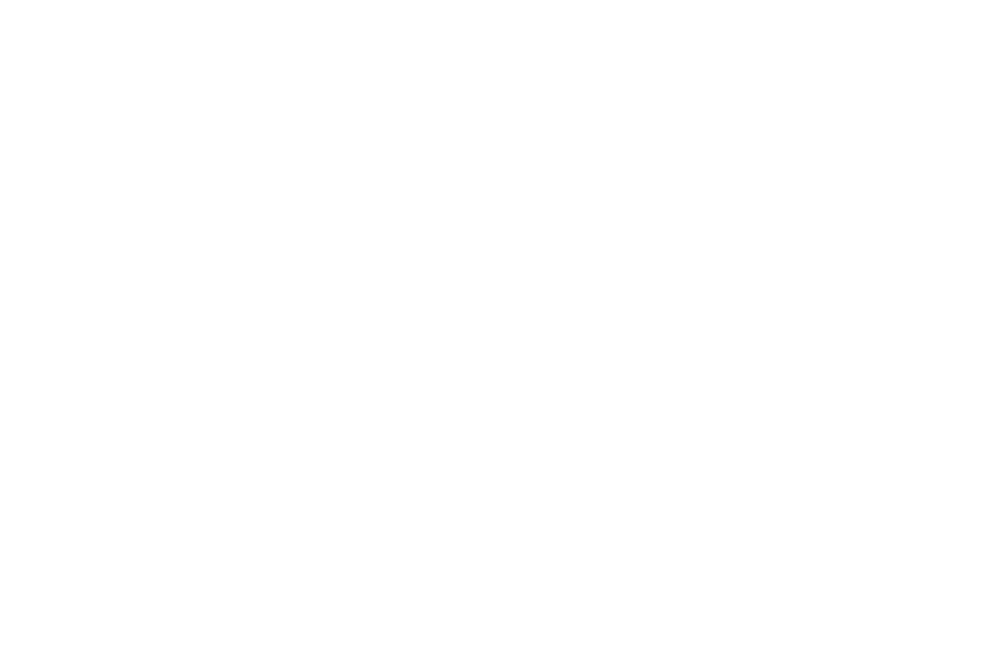

<IPython.core.display.Javascript object>


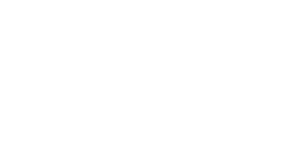

<IPython.core.display.Javascript object>


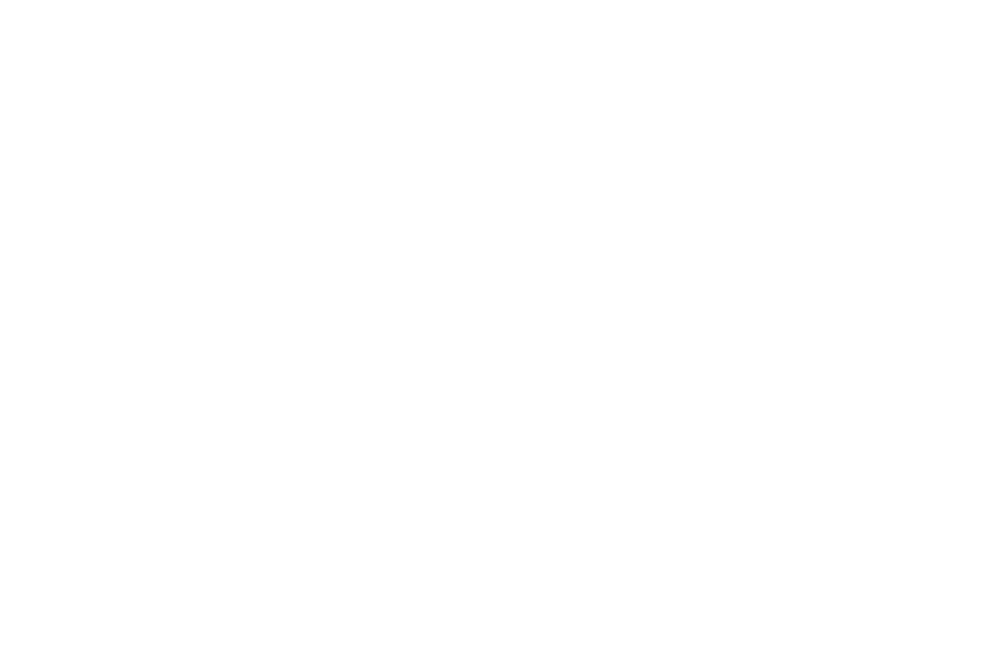

<IPython.core.display.Javascript object>


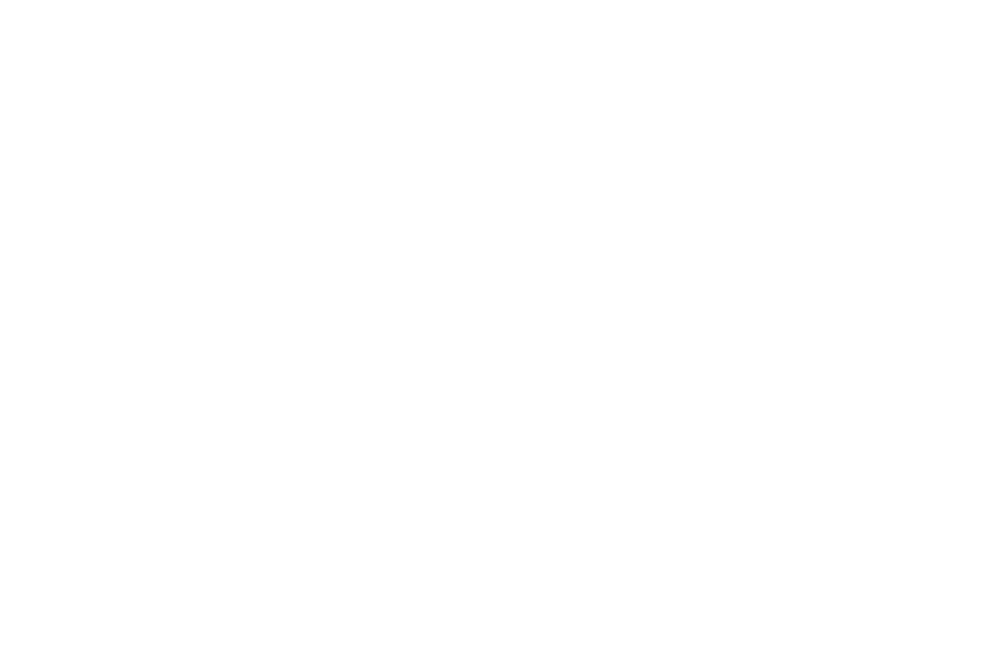

<IPython.core.display.Javascript object>


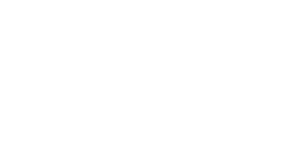

<IPython.core.display.Javascript object>


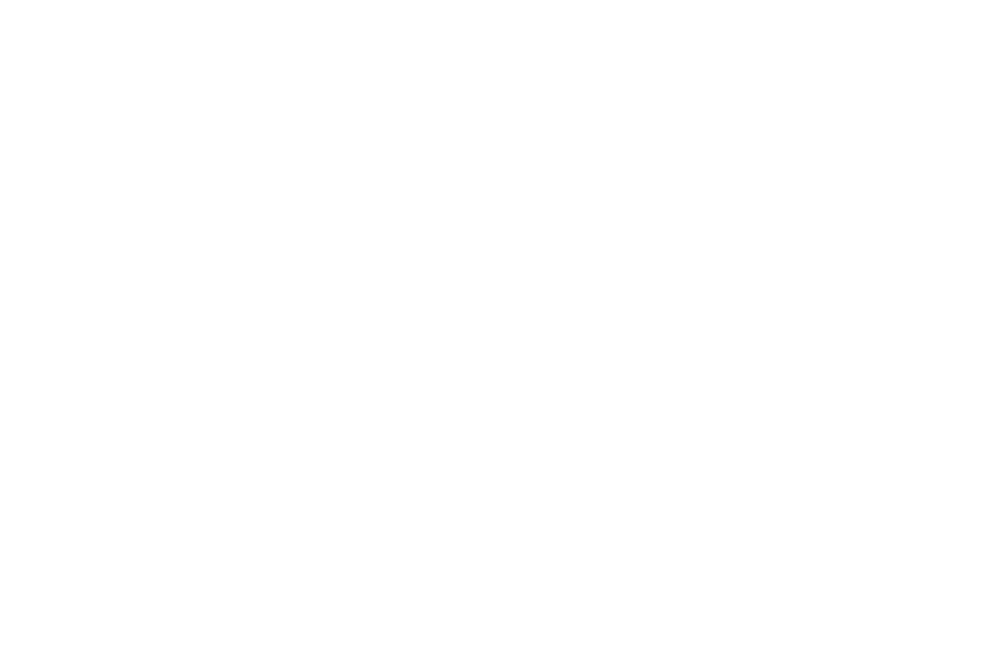

<IPython.core.display.Javascript object>


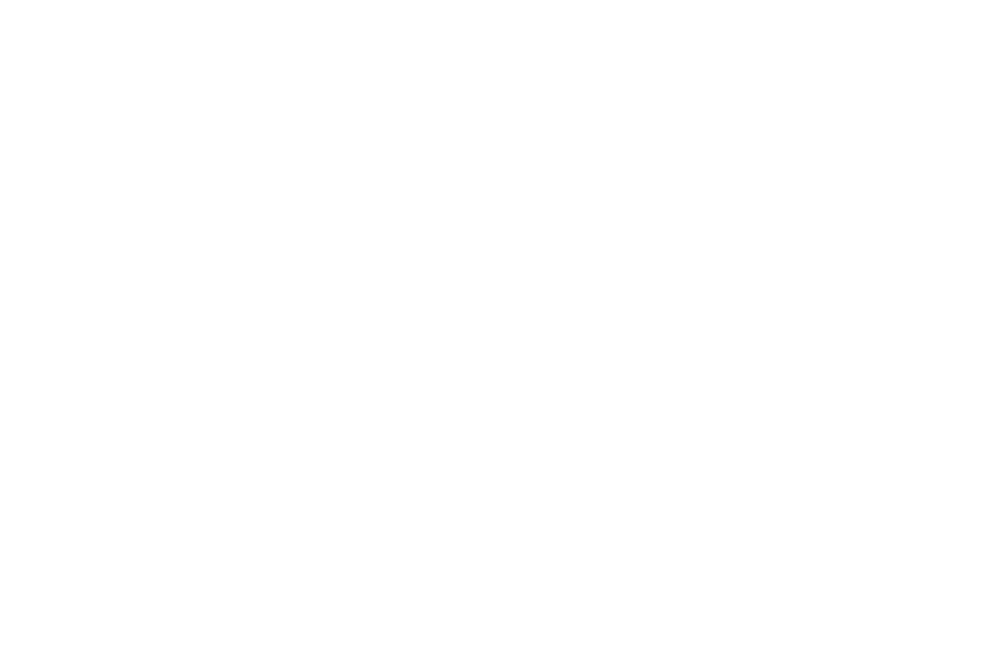

<IPython.core.display.Javascript object>


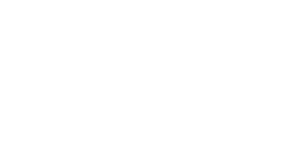

<IPython.core.display.Javascript object>


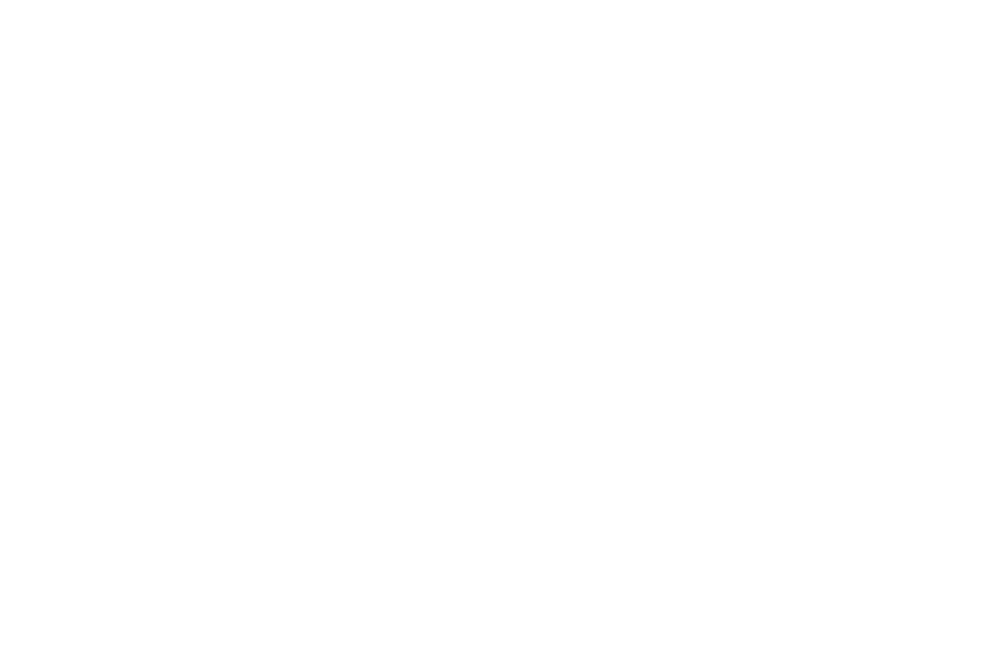

<IPython.core.display.Javascript object>


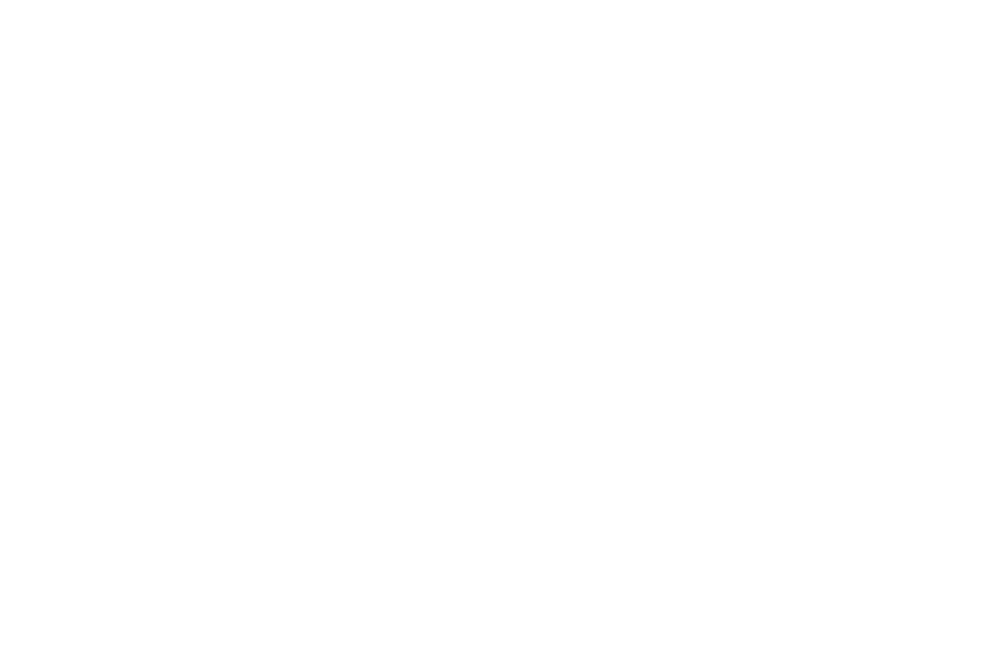

<IPython.core.display.Javascript object>


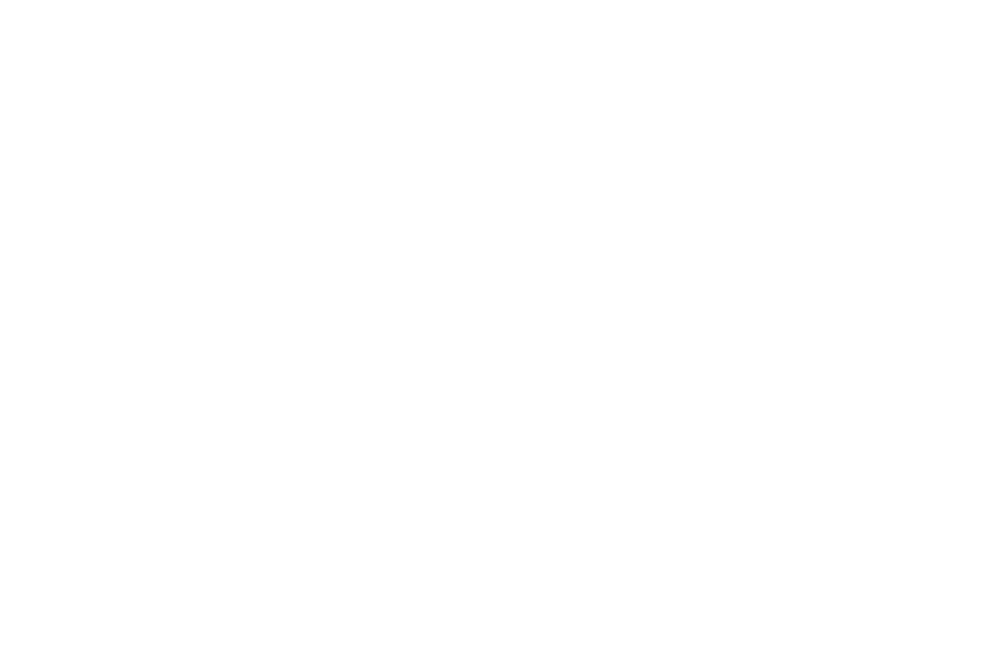

<IPython.core.display.Javascript object>


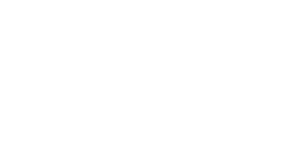

<IPython.core.display.Javascript object>


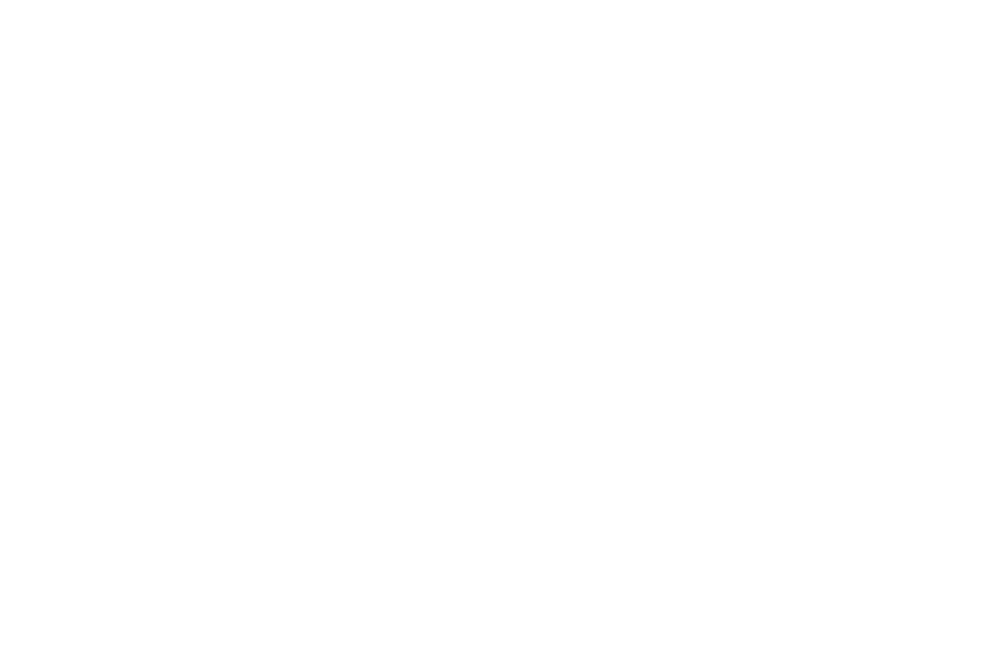

<IPython.core.display.Javascript object>


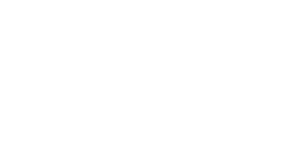

<IPython.core.display.Javascript object>


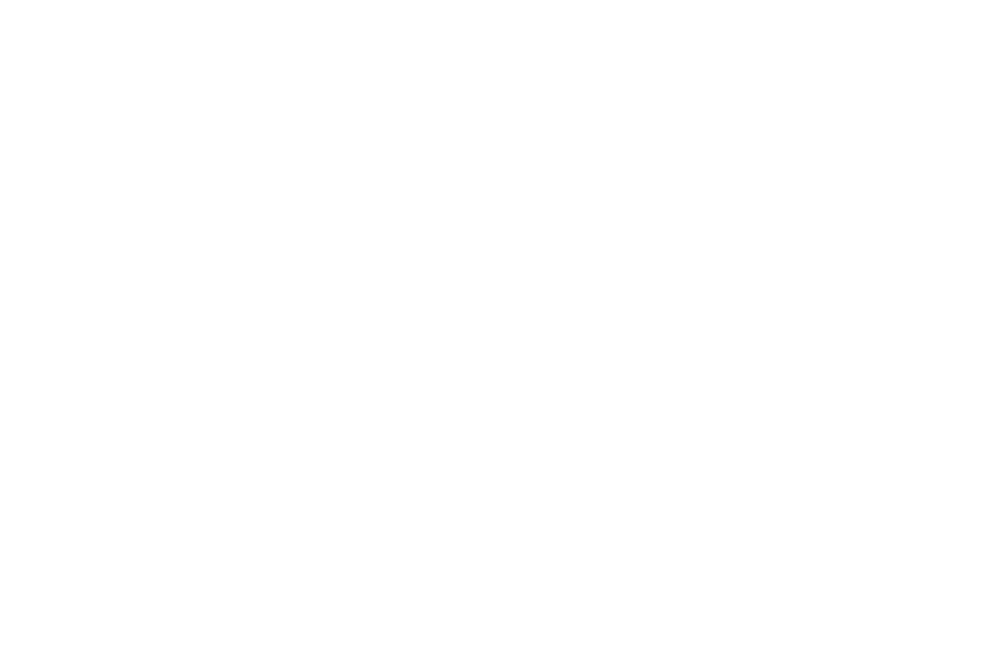

<IPython.core.display.Javascript object>


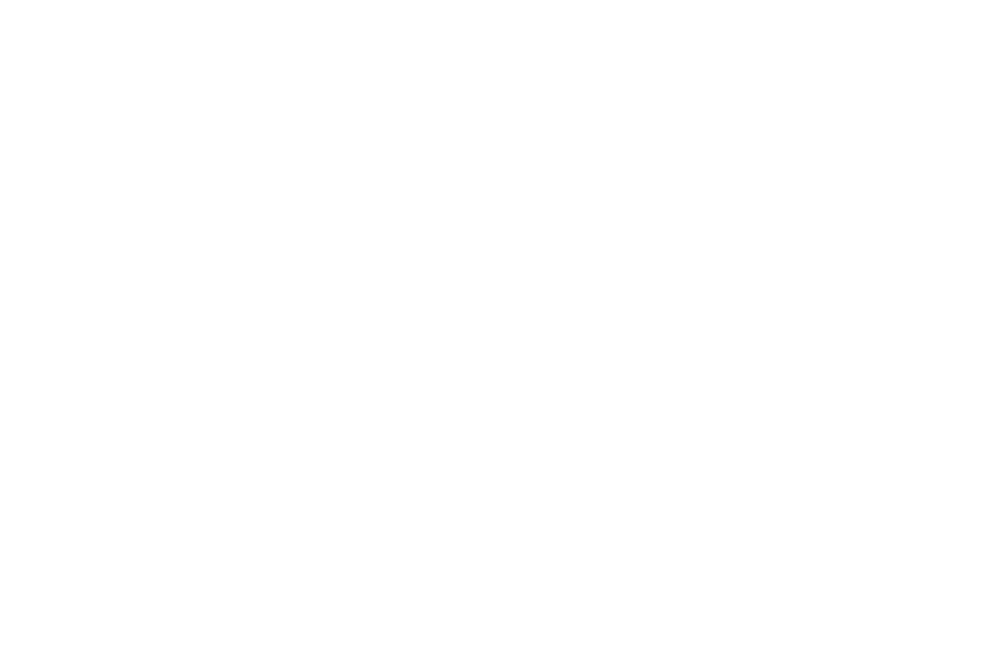

<IPython.core.display.Javascript object>


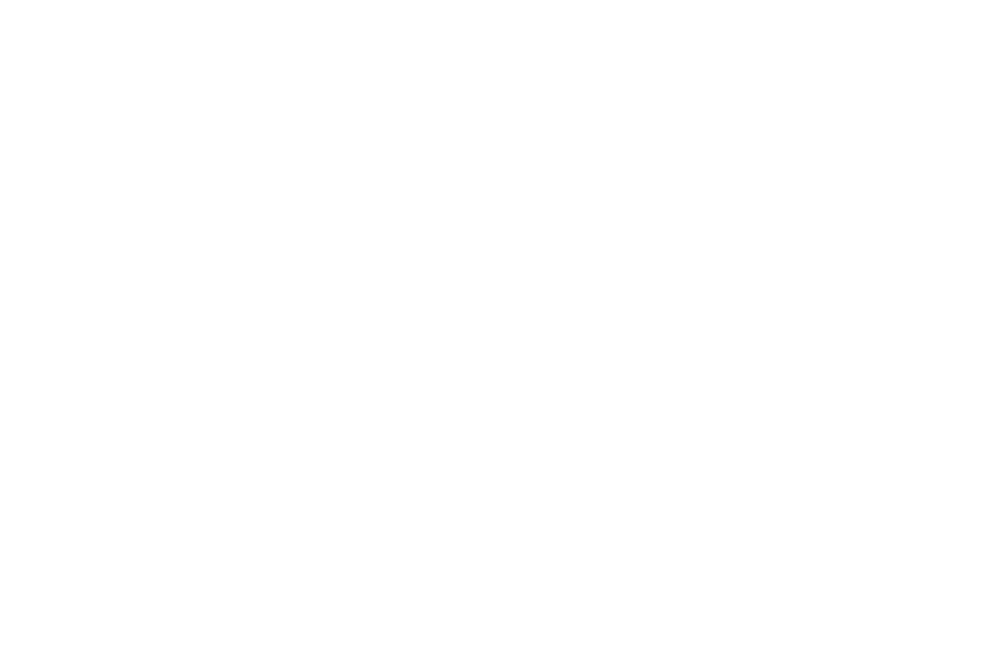

<IPython.core.display.Javascript object>


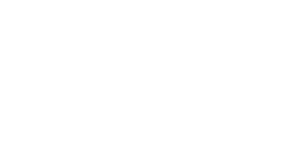

<IPython.core.display.Javascript object>


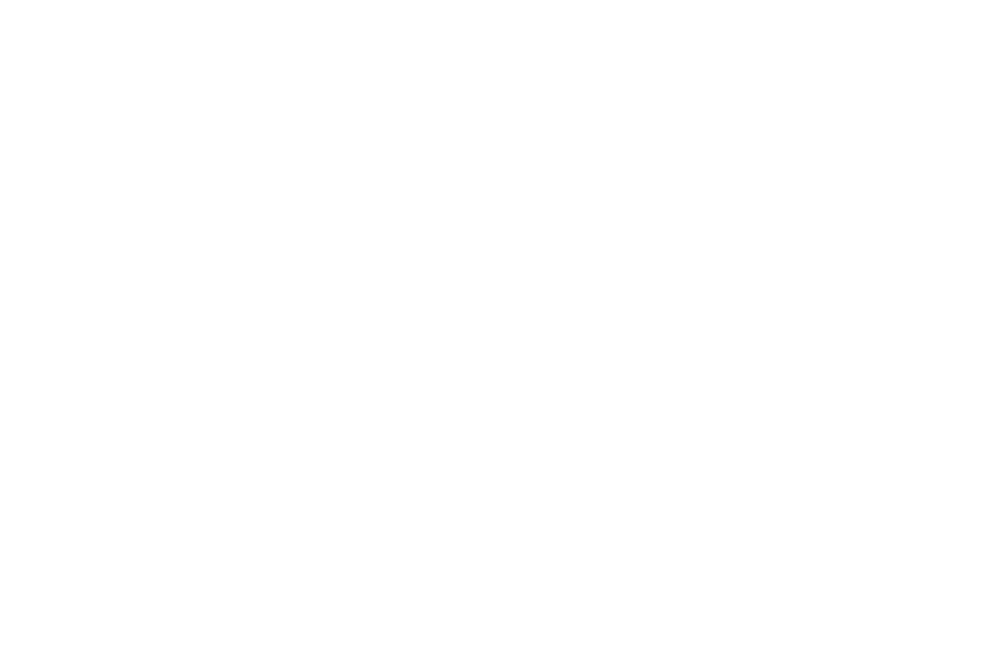

<IPython.core.display.Javascript object>


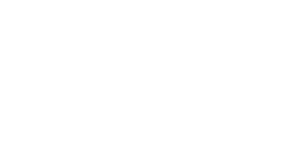

<IPython.core.display.Javascript object>


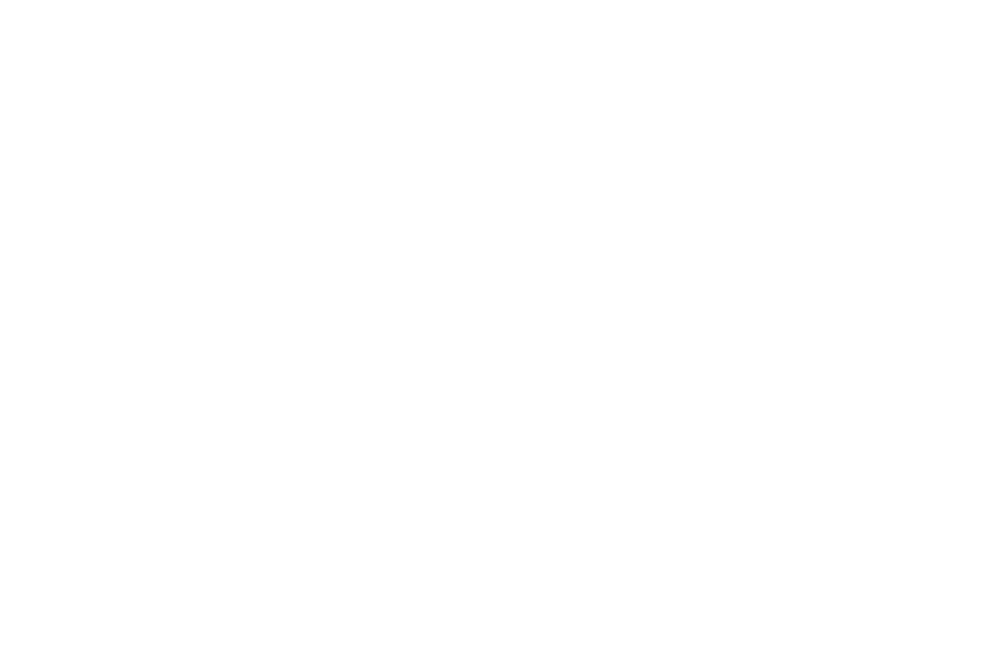

<IPython.core.display.Javascript object>


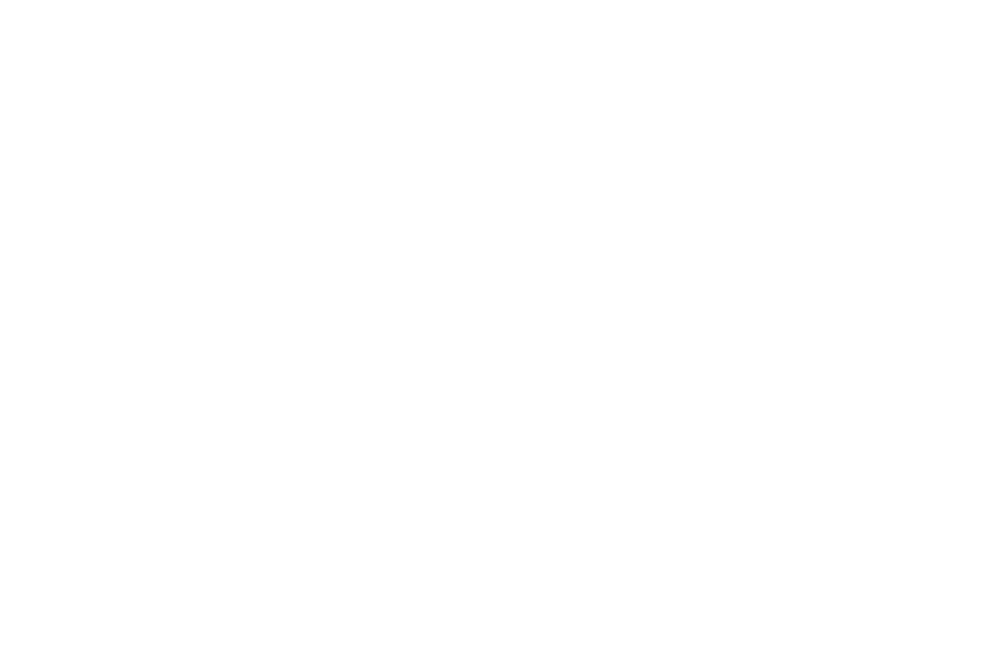

<IPython.core.display.Javascript object>


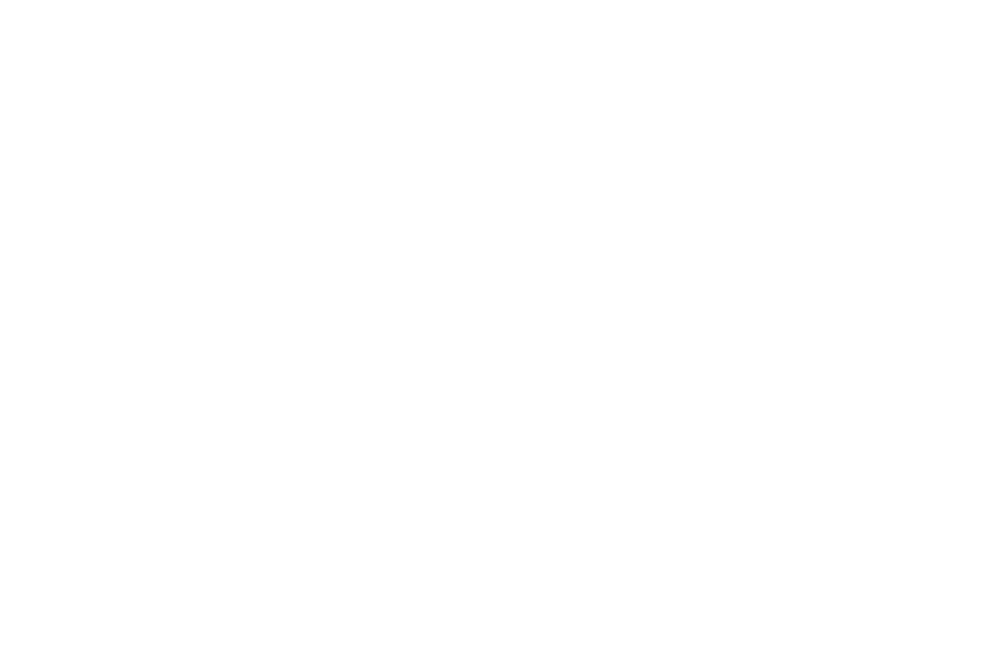

<IPython.core.display.Javascript object>


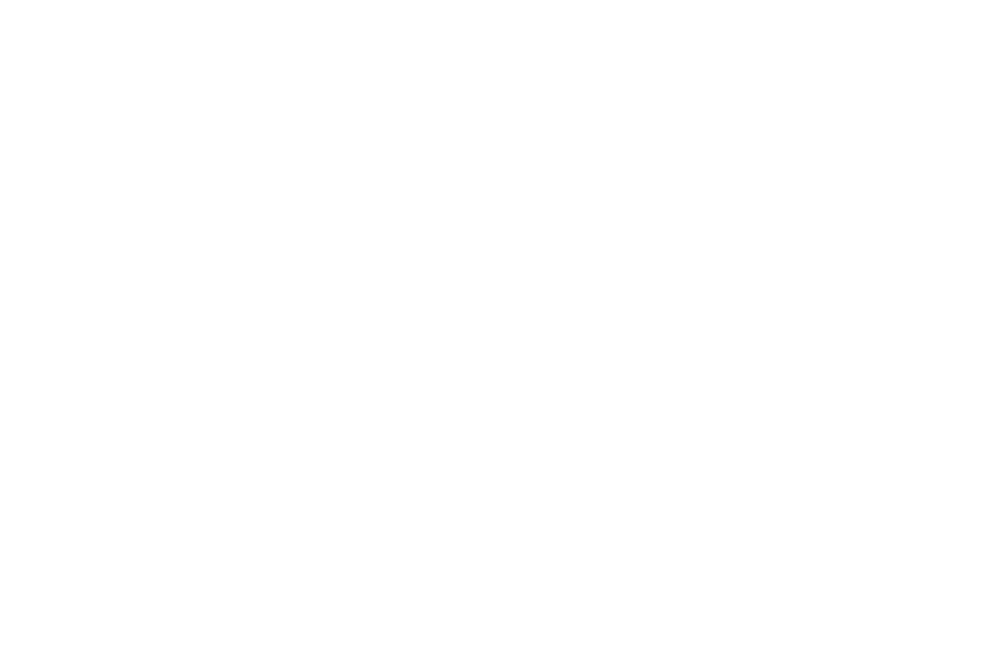

<IPython.core.display.Javascript object>


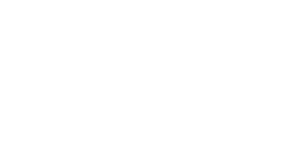

<IPython.core.display.Javascript object>


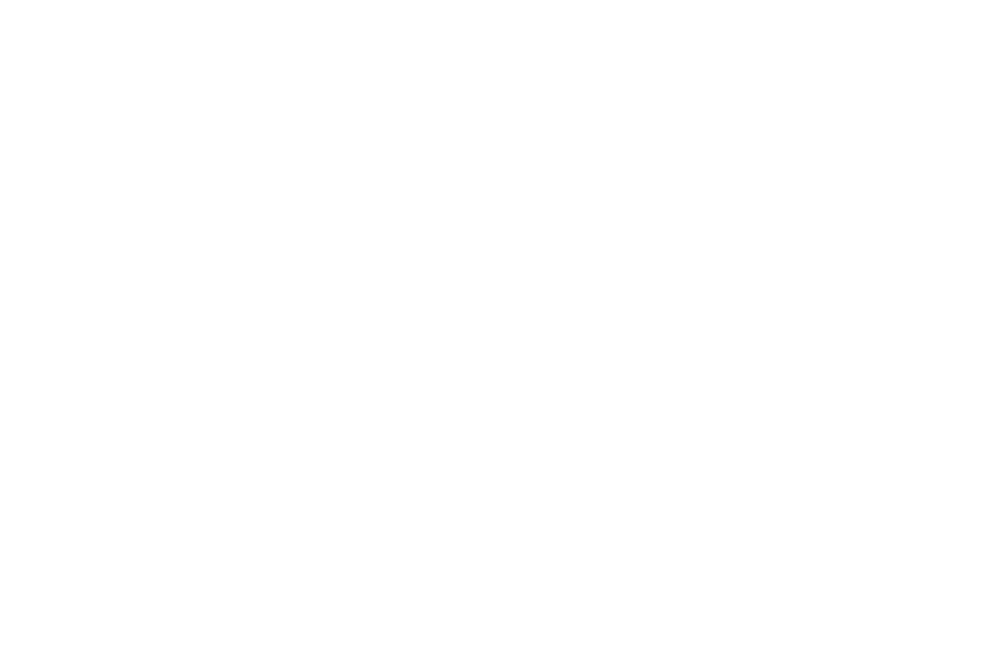

<IPython.core.display.Javascript object>


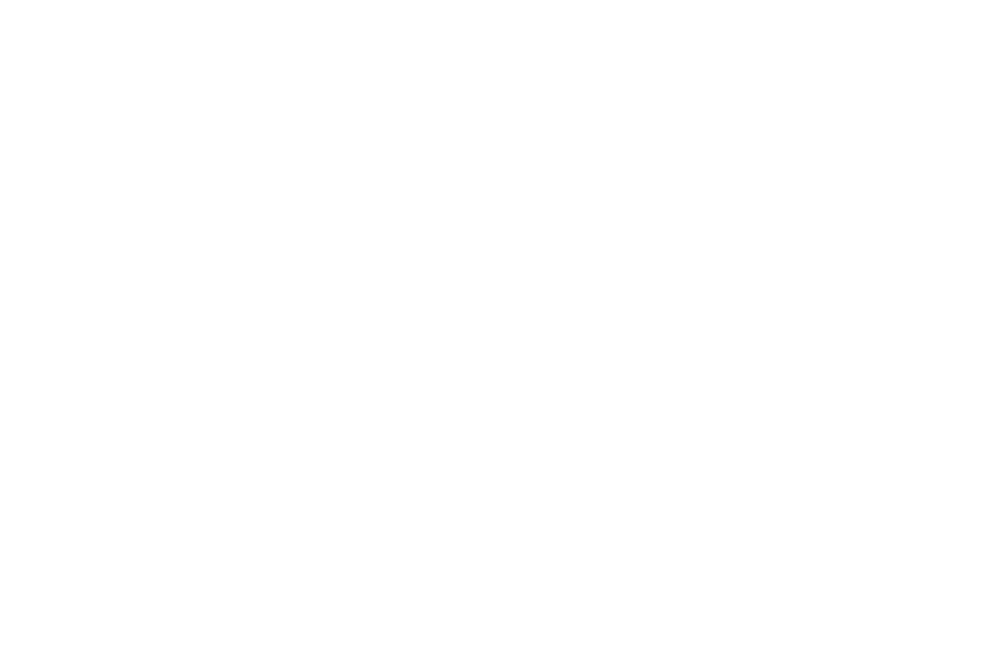

<IPython.core.display.Javascript object>


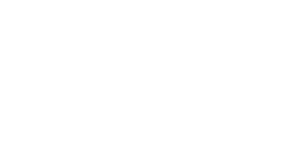

<IPython.core.display.Javascript object>


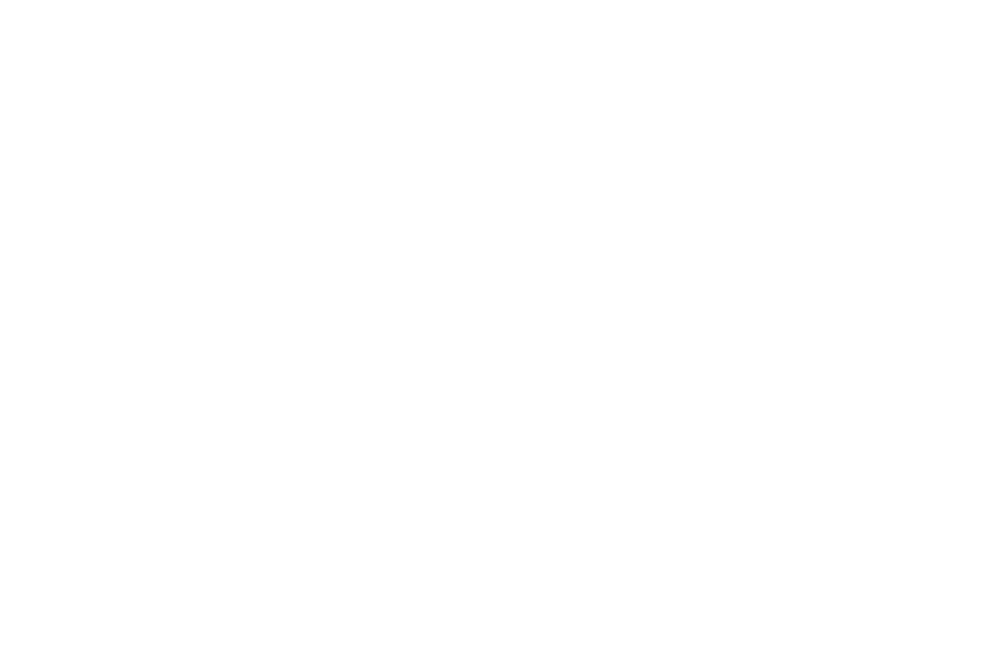

<IPython.core.display.Javascript object>


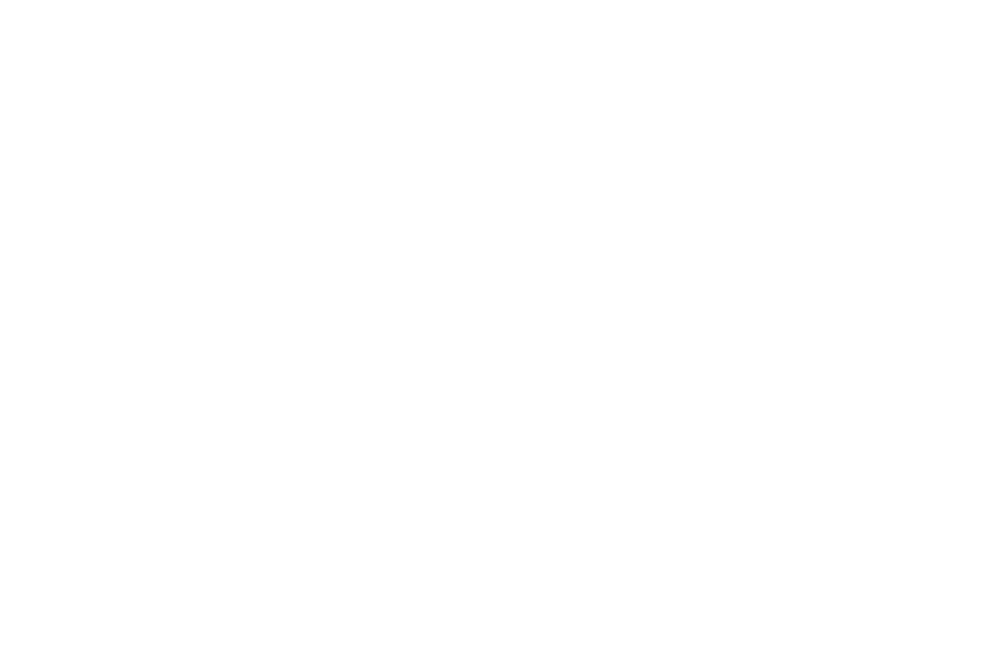

<IPython.core.display.Javascript object>


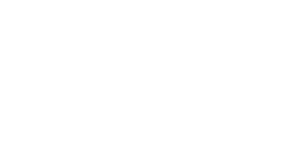

<IPython.core.display.Javascript object>


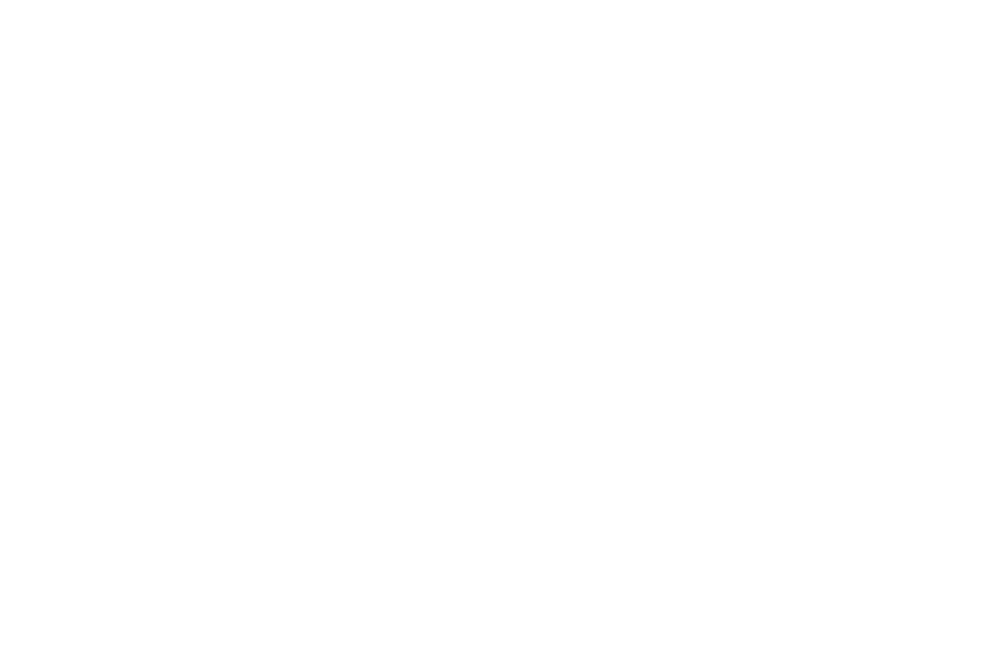

<IPython.core.display.Javascript object>


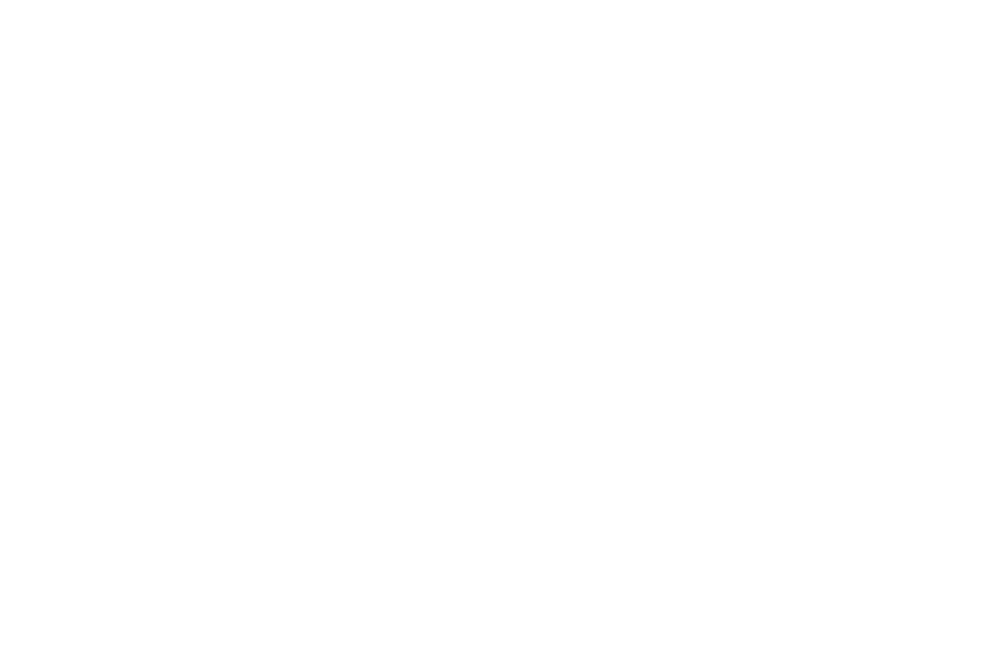

<IPython.core.display.Javascript object>


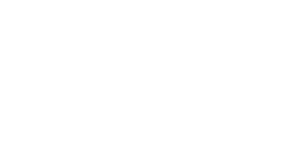

<IPython.core.display.Javascript object>


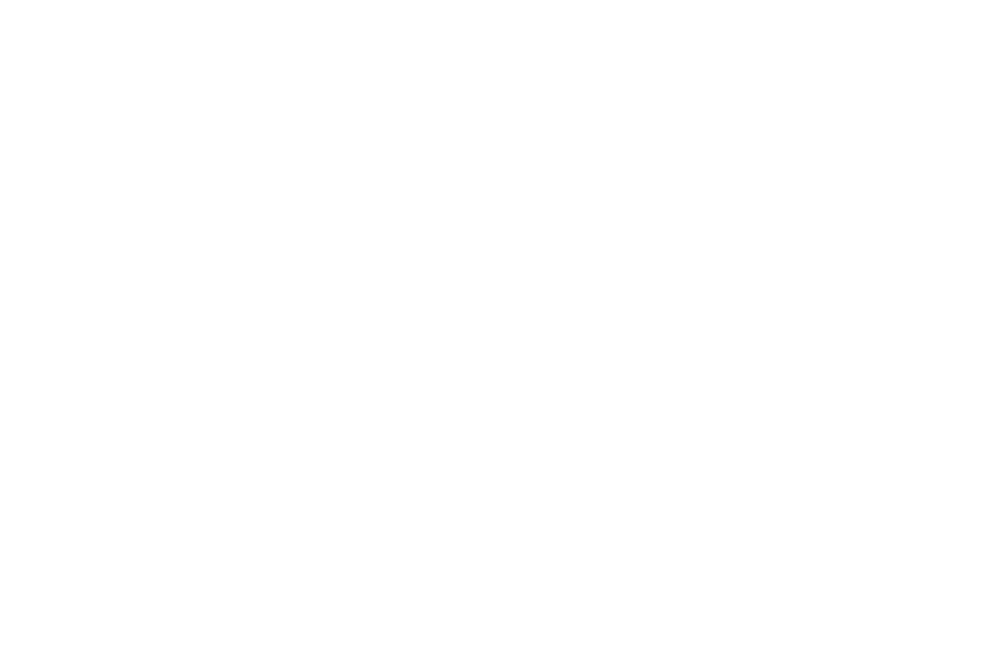

<IPython.core.display.Javascript object>


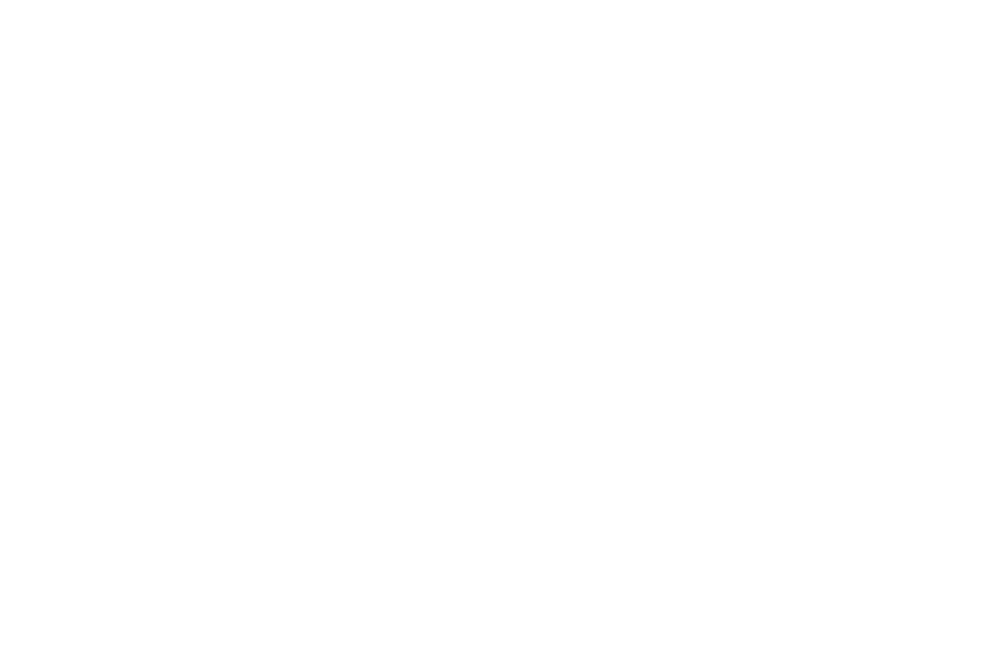

<IPython.core.display.Javascript object>


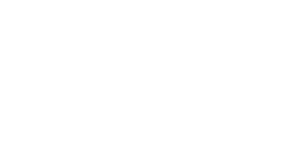

<IPython.core.display.Javascript object>


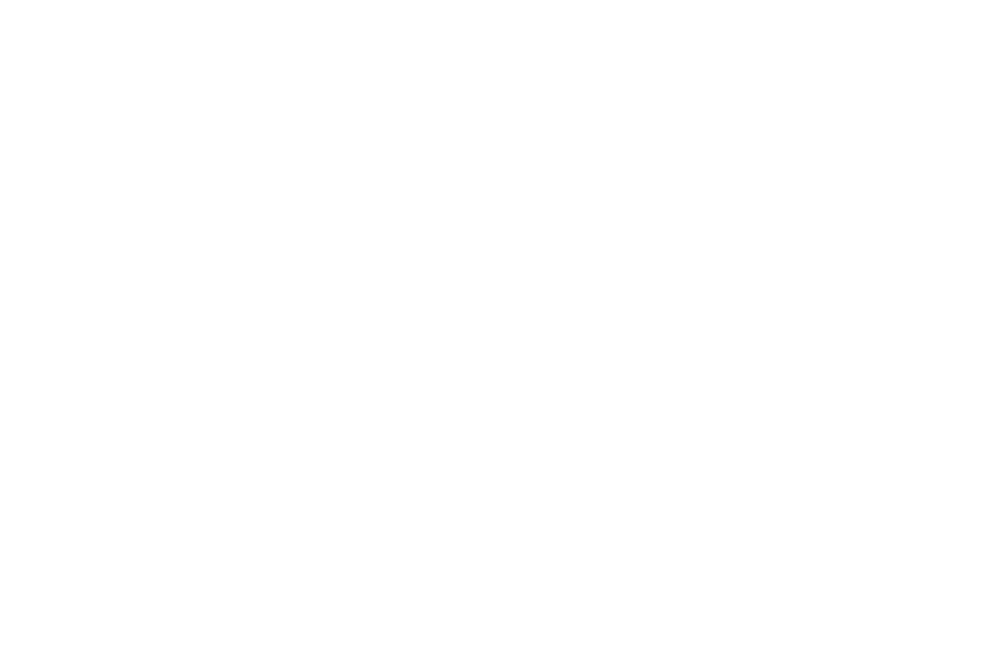

<IPython.core.display.Javascript object>


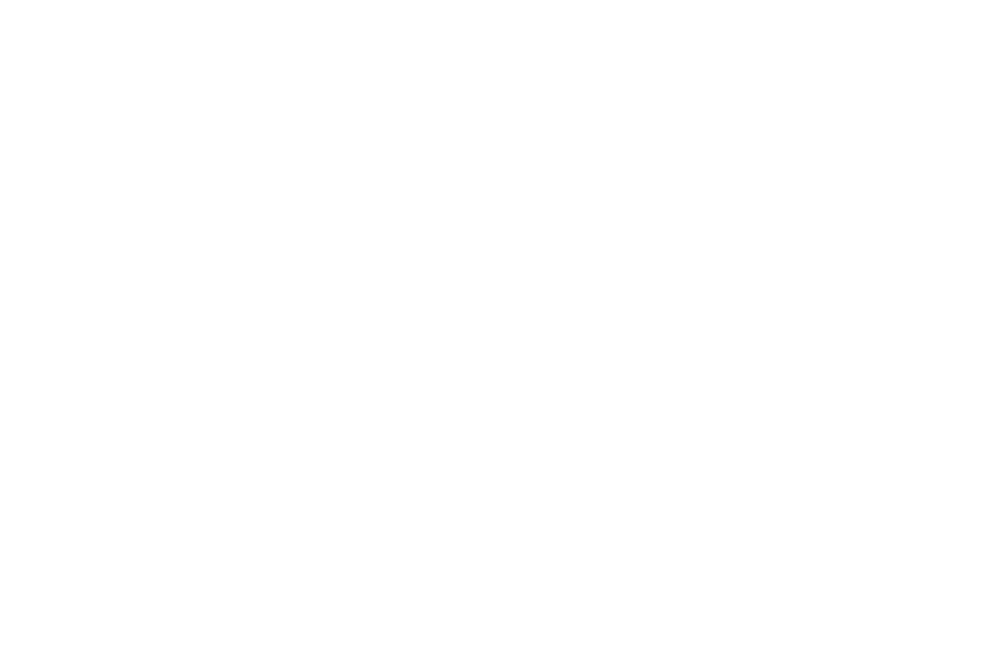

<IPython.core.display.Javascript object>


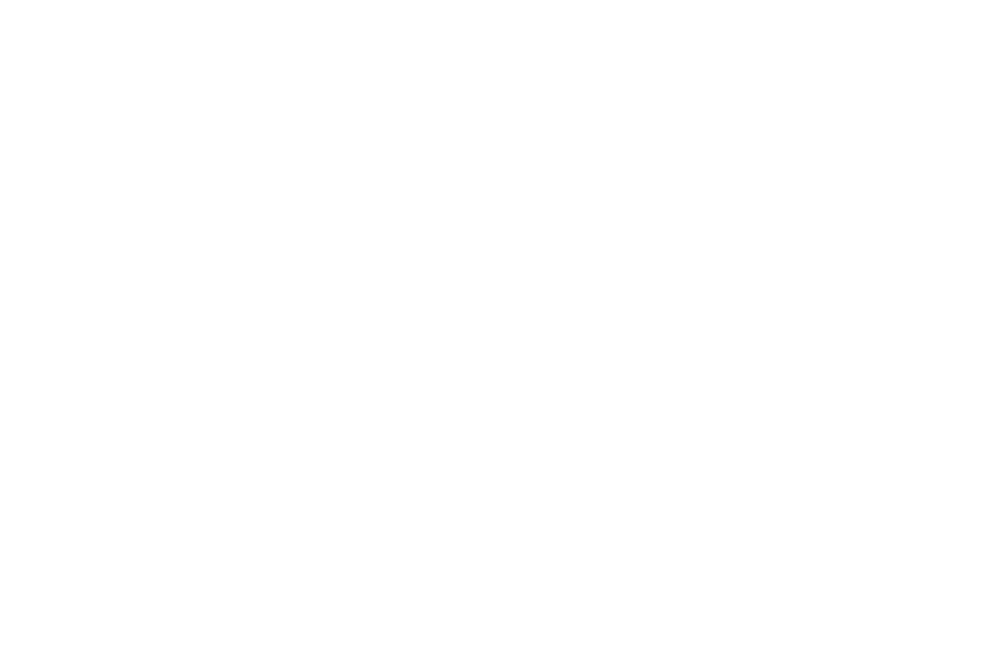

<IPython.core.display.Javascript object>


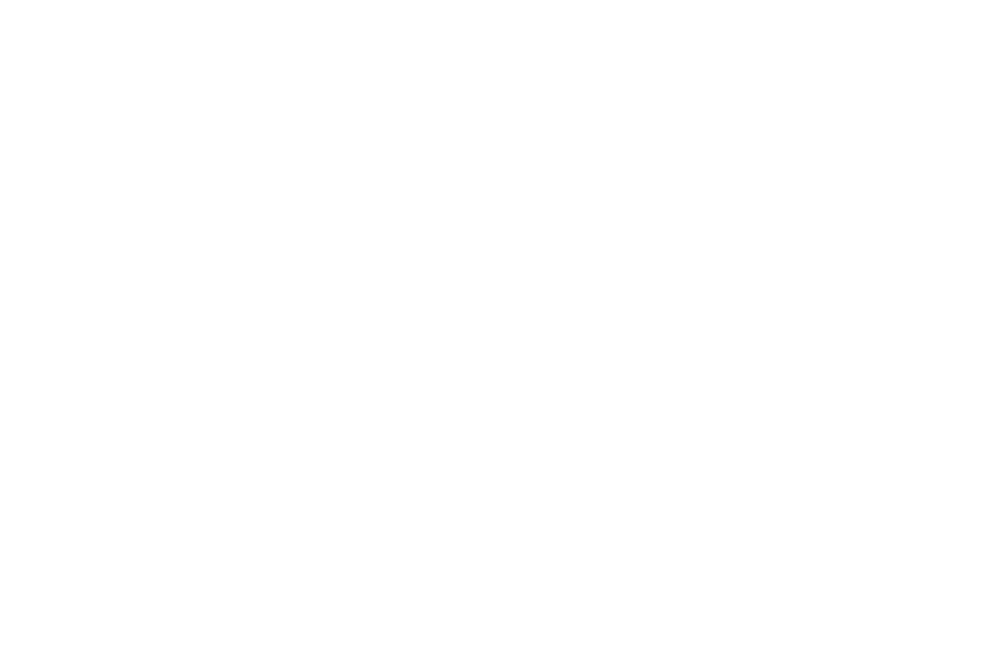

<IPython.core.display.Javascript object>


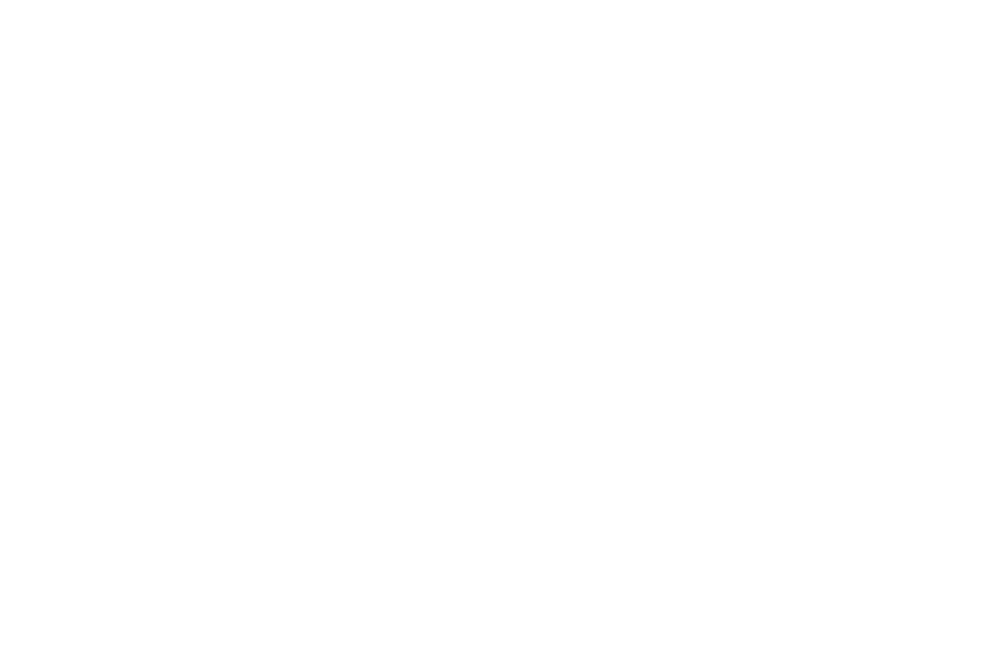

<IPython.core.display.Javascript object>


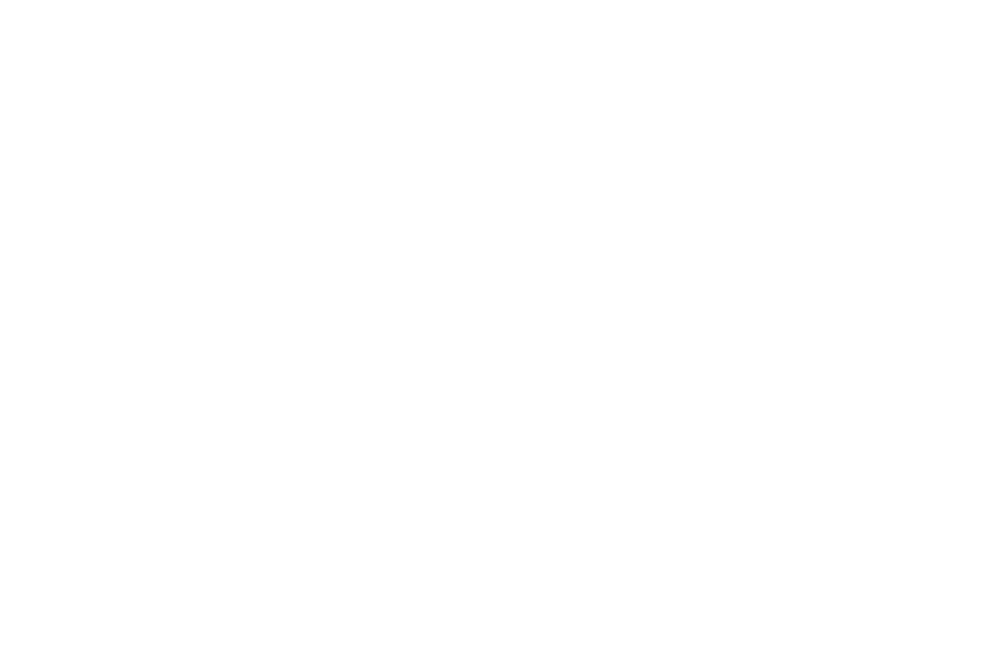

<IPython.core.display.Javascript object>


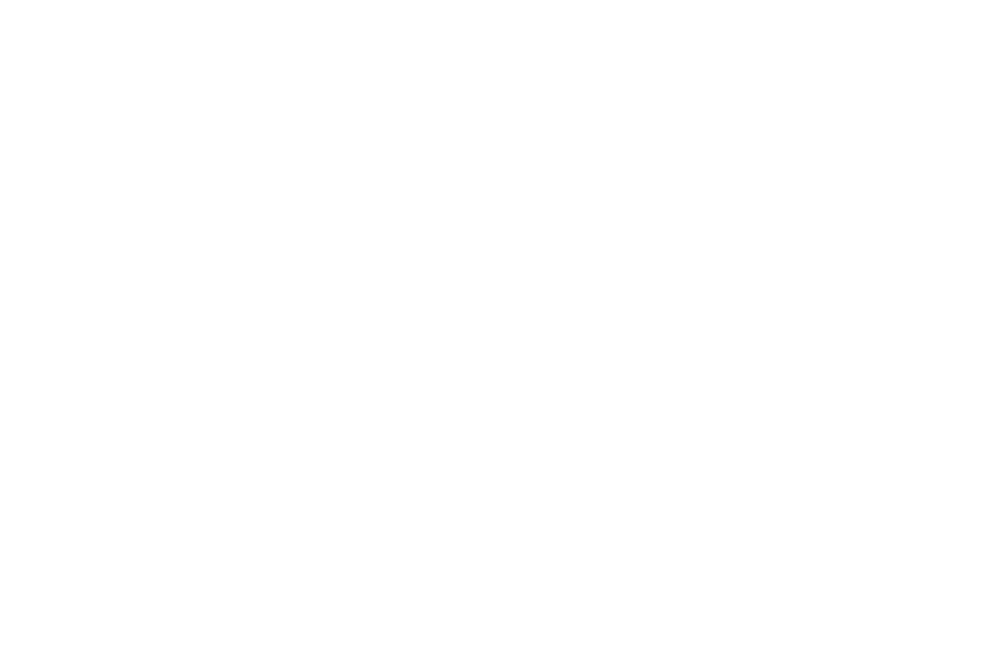

<IPython.core.display.Javascript object>


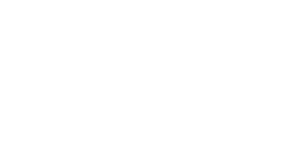

<IPython.core.display.Javascript object>


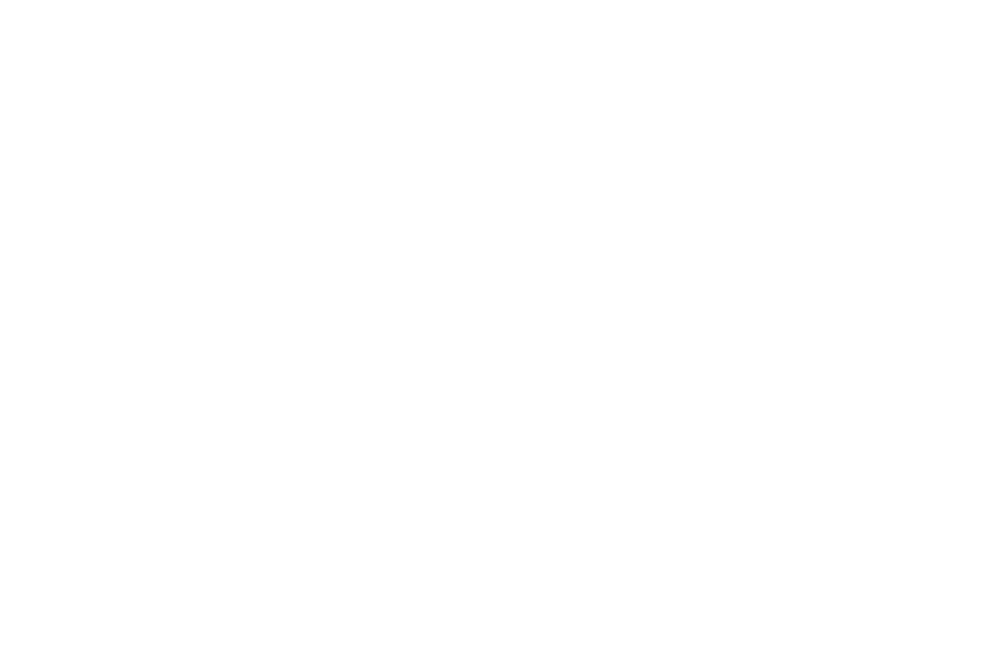

<IPython.core.display.Javascript object>


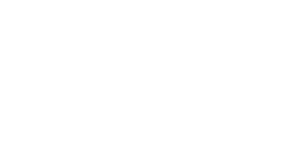

<IPython.core.display.Javascript object>


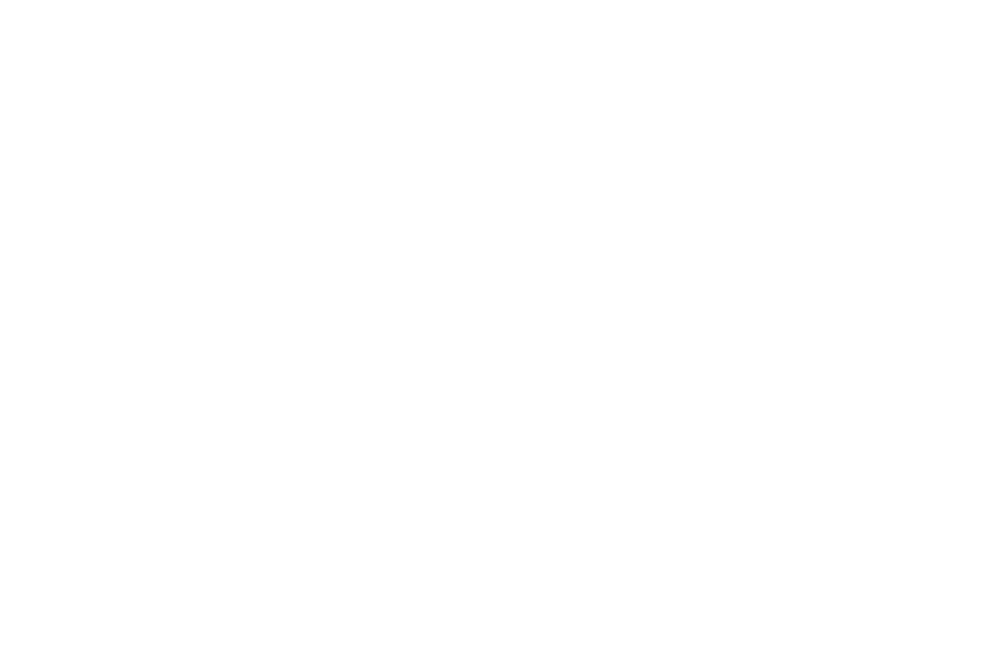

<IPython.core.display.Javascript object>


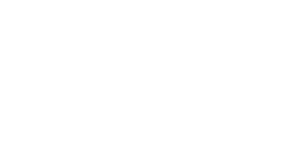

<IPython.core.display.Javascript object>


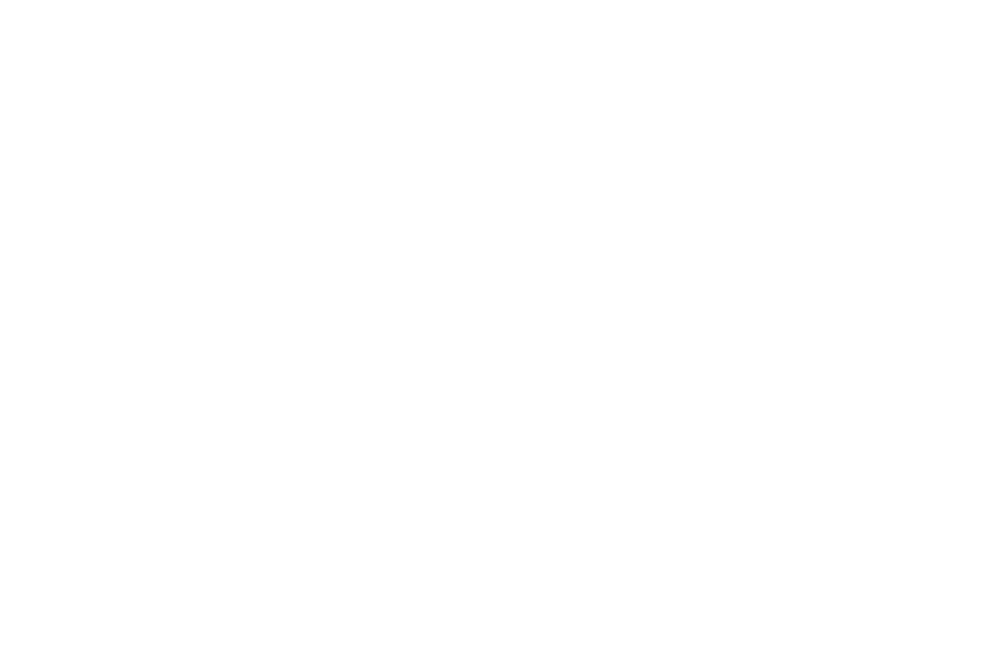

<IPython.core.display.Javascript object>


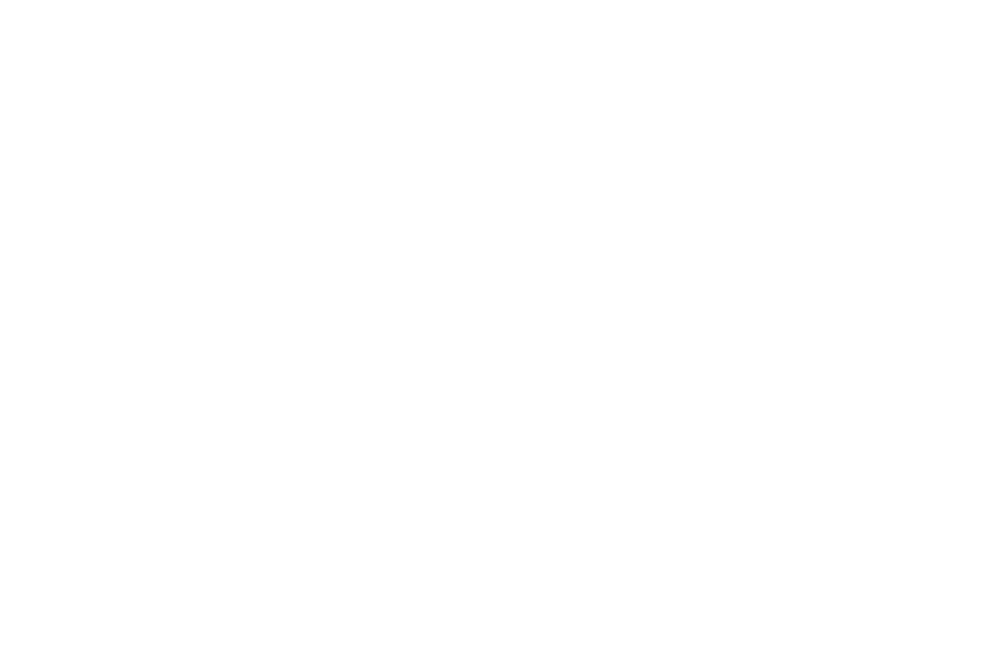

<IPython.core.display.Javascript object>


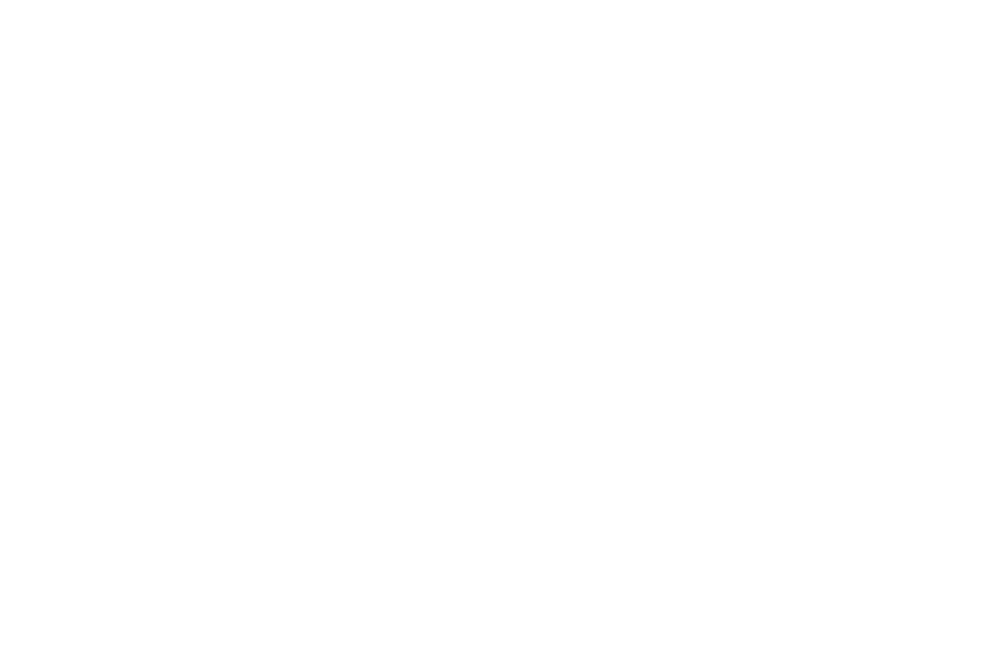

<IPython.core.display.Javascript object>


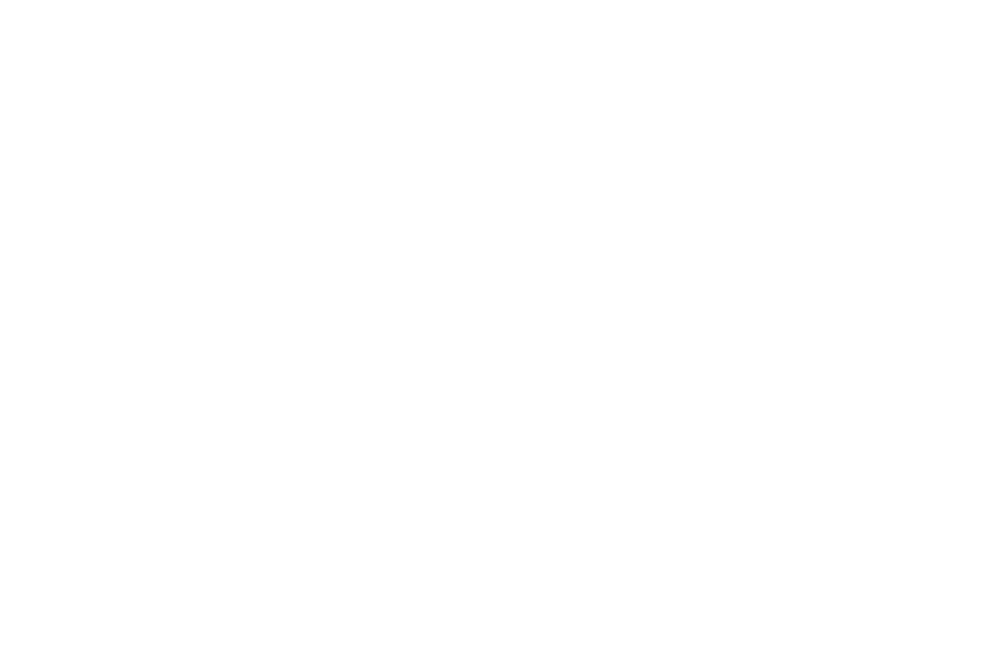

<IPython.core.display.Javascript object>


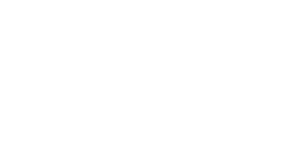

<IPython.core.display.Javascript object>


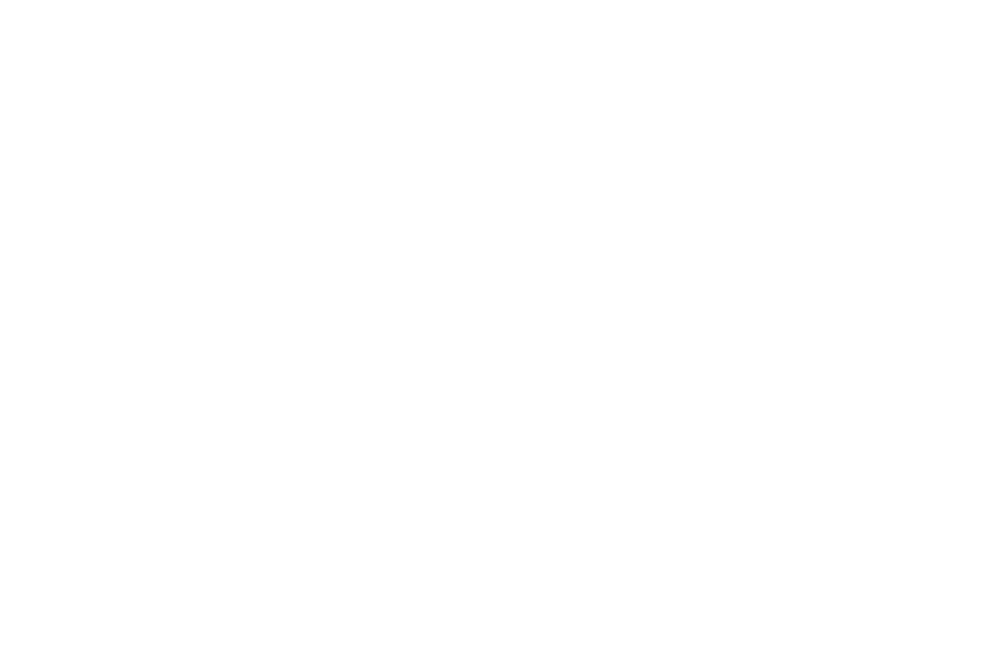

<IPython.core.display.Javascript object>


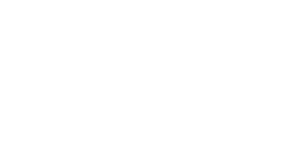

<IPython.core.display.Javascript object>


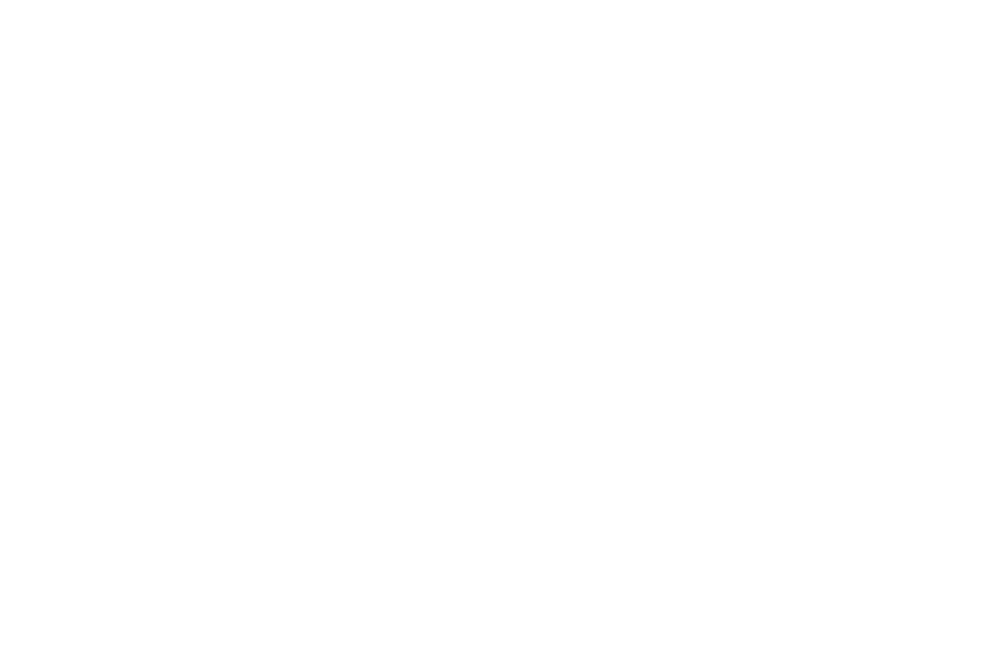

<IPython.core.display.Javascript object>


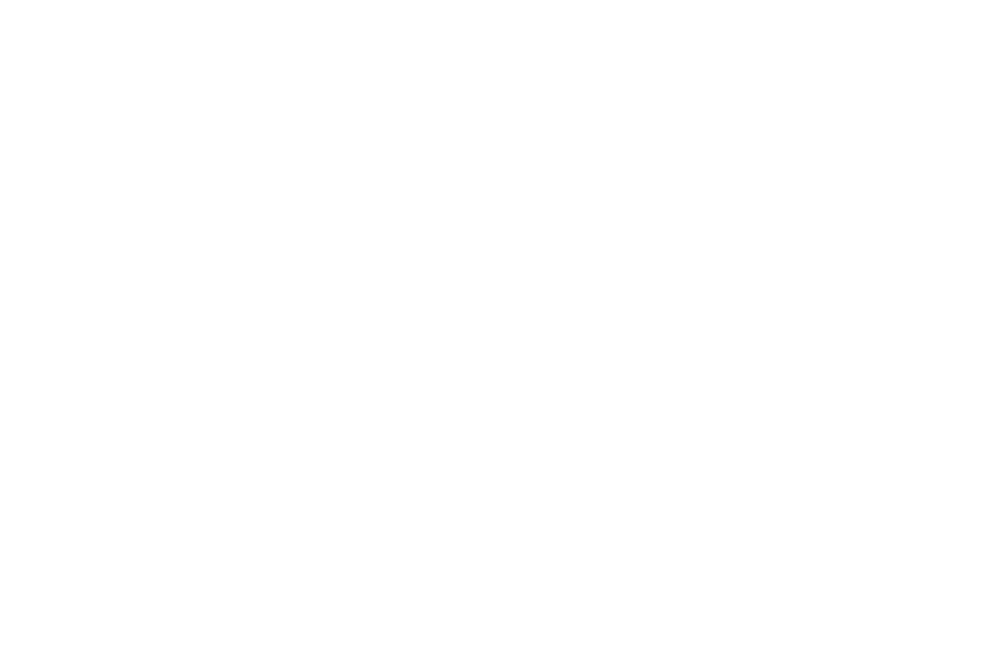

<IPython.core.display.Javascript object>


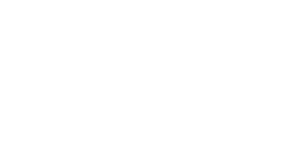

<IPython.core.display.Javascript object>


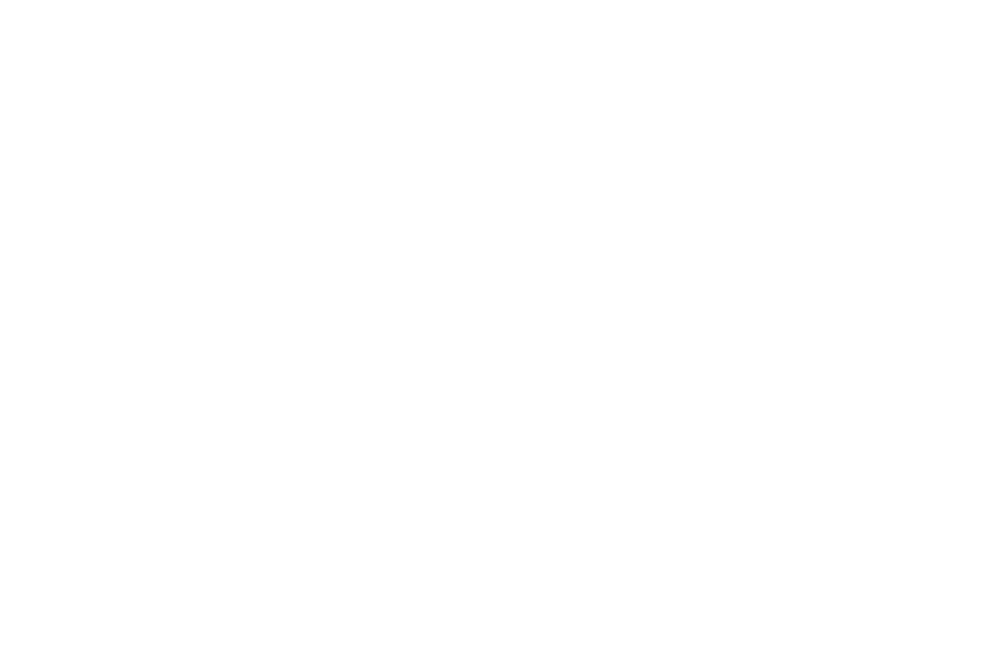

<IPython.core.display.Javascript object>


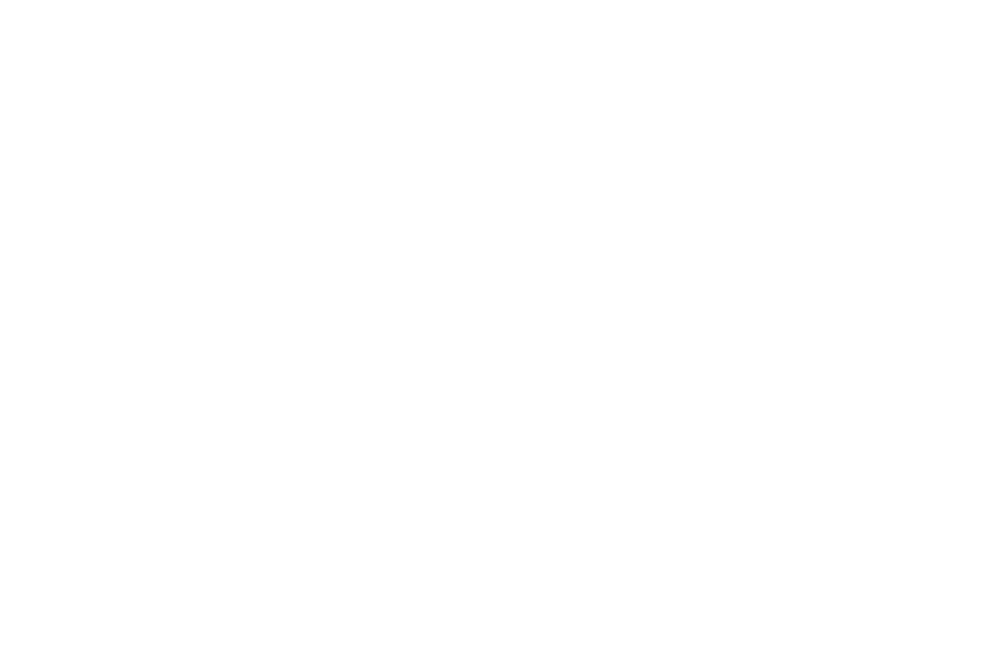

<IPython.core.display.Javascript object>


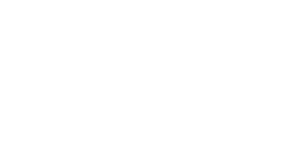

<IPython.core.display.Javascript object>


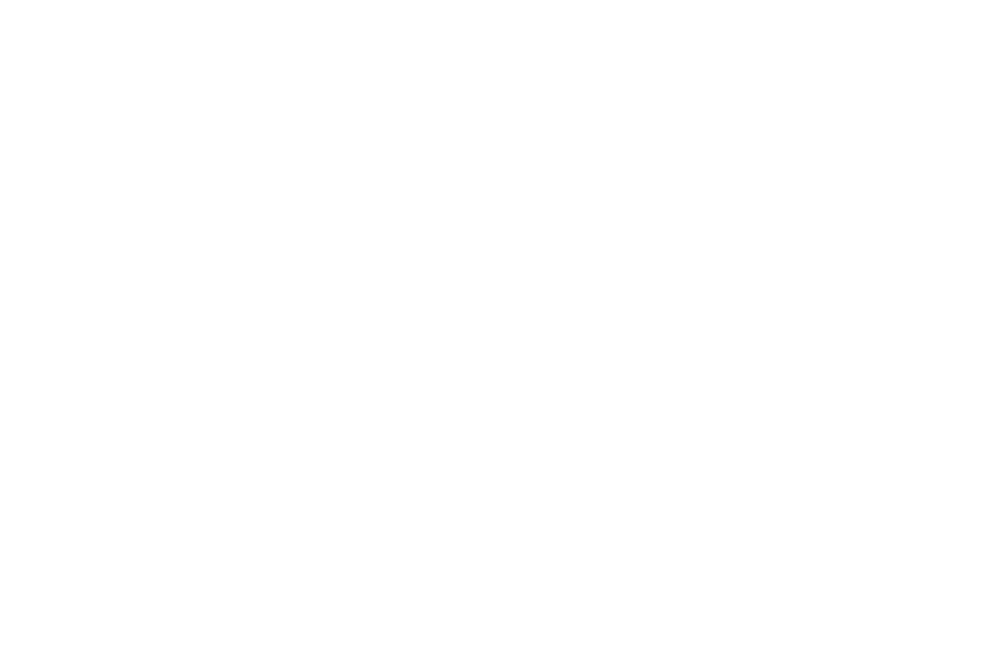

<IPython.core.display.Javascript object>


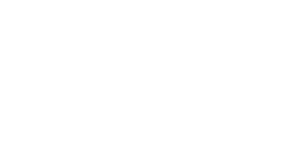

<IPython.core.display.Javascript object>


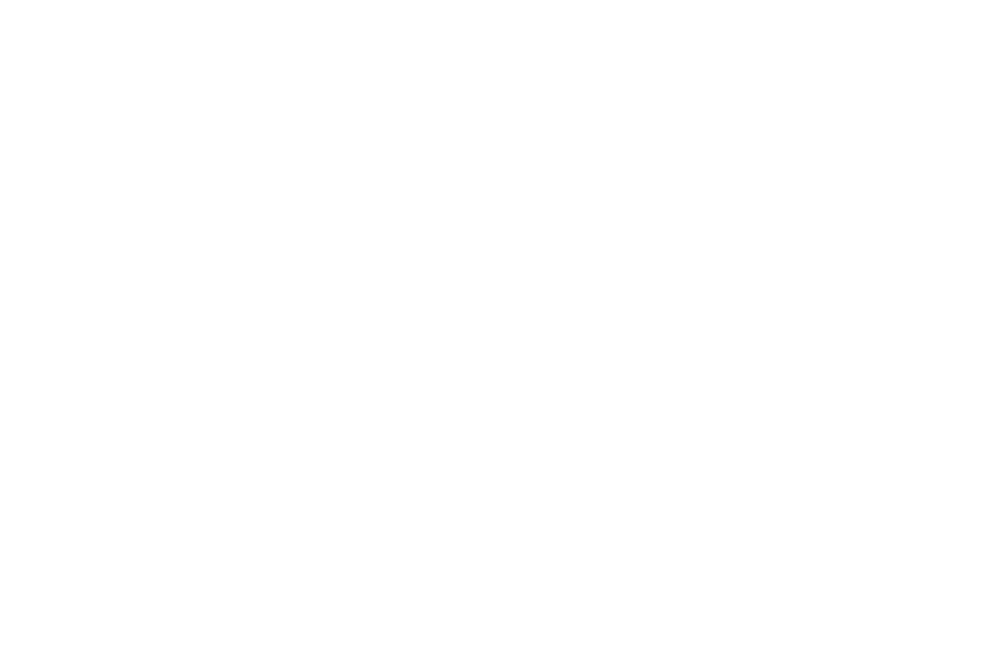

<IPython.core.display.Javascript object>


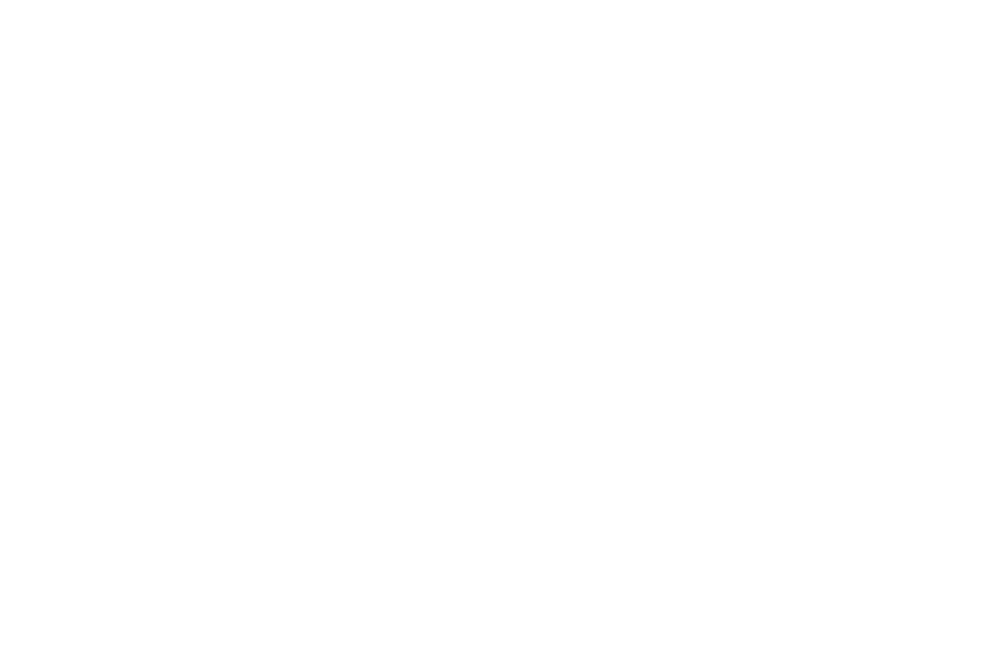

<IPython.core.display.Javascript object>


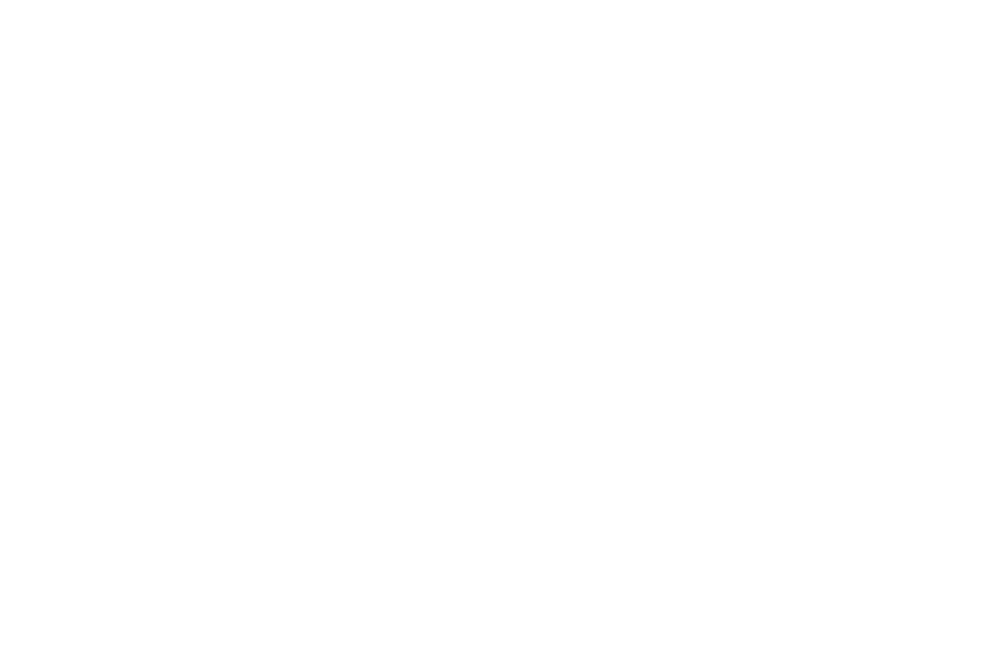

<IPython.core.display.Javascript object>


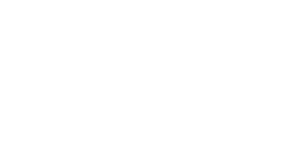

<IPython.core.display.Javascript object>


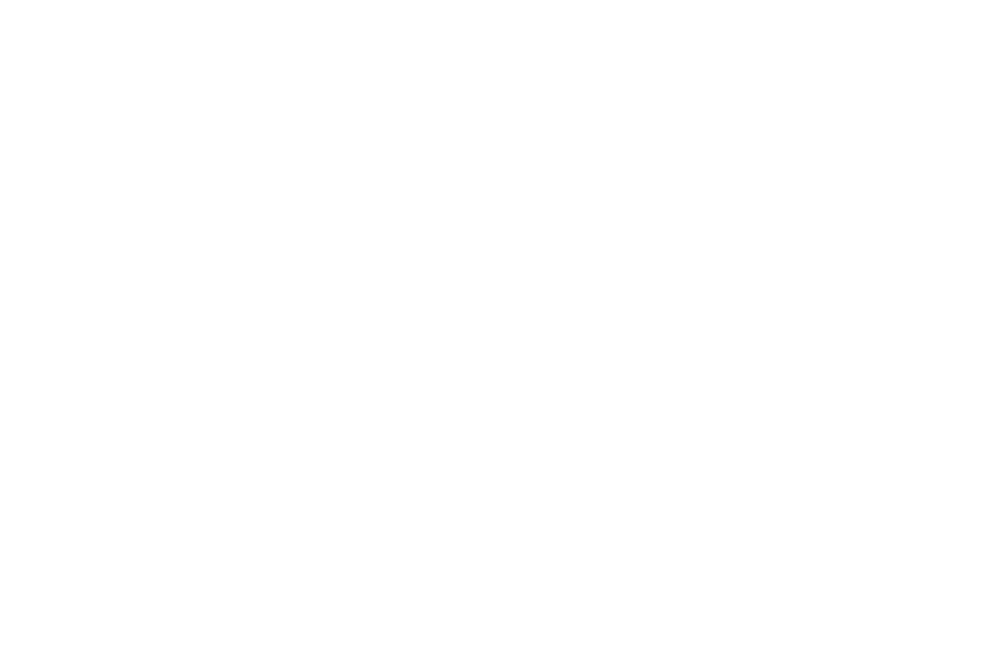

<IPython.core.display.Javascript object>


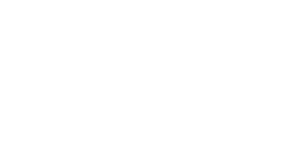

<IPython.core.display.Javascript object>


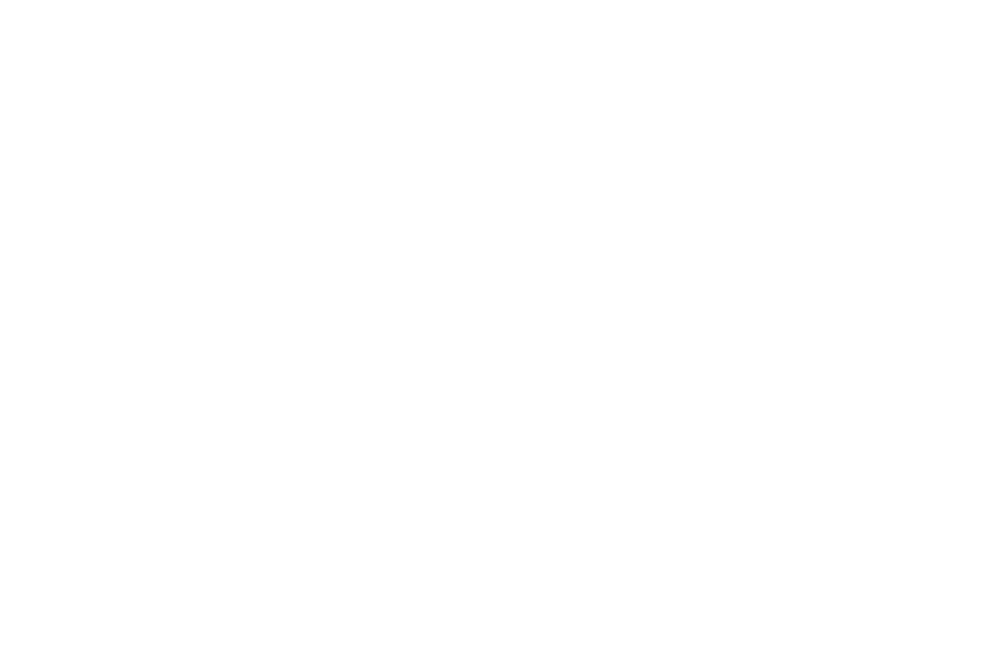

<IPython.core.display.Javascript object>


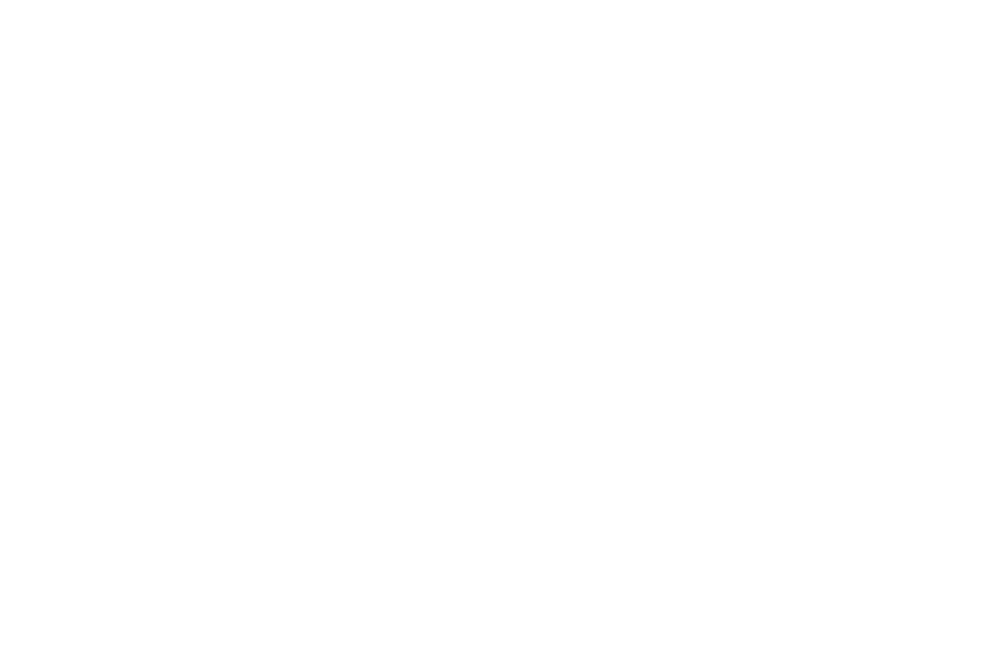

<IPython.core.display.Javascript object>


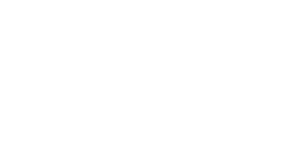

<IPython.core.display.Javascript object>


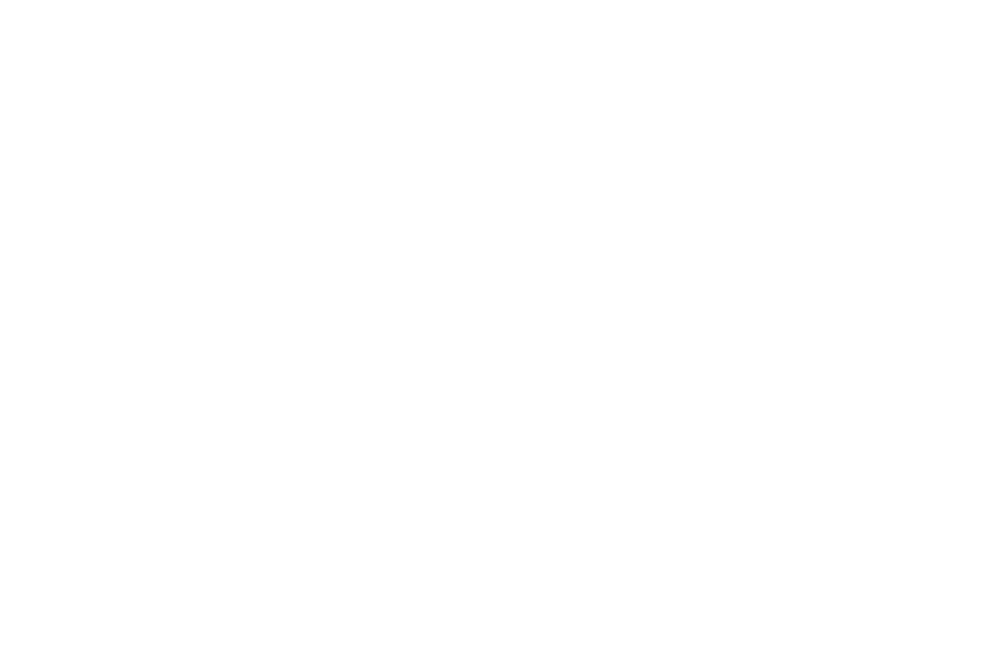

<IPython.core.display.Javascript object>


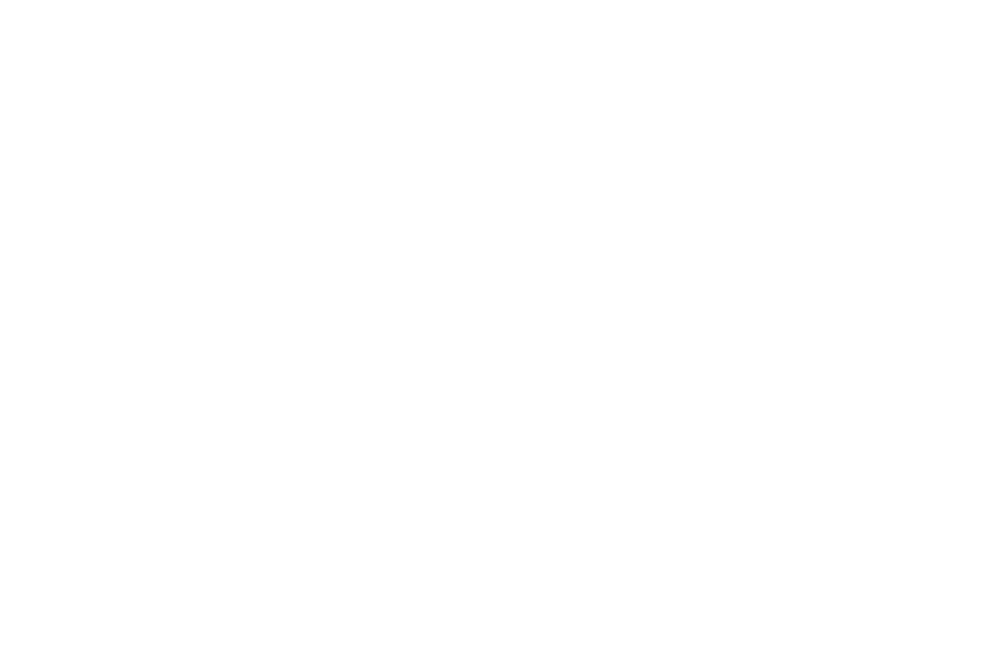

<IPython.core.display.Javascript object>


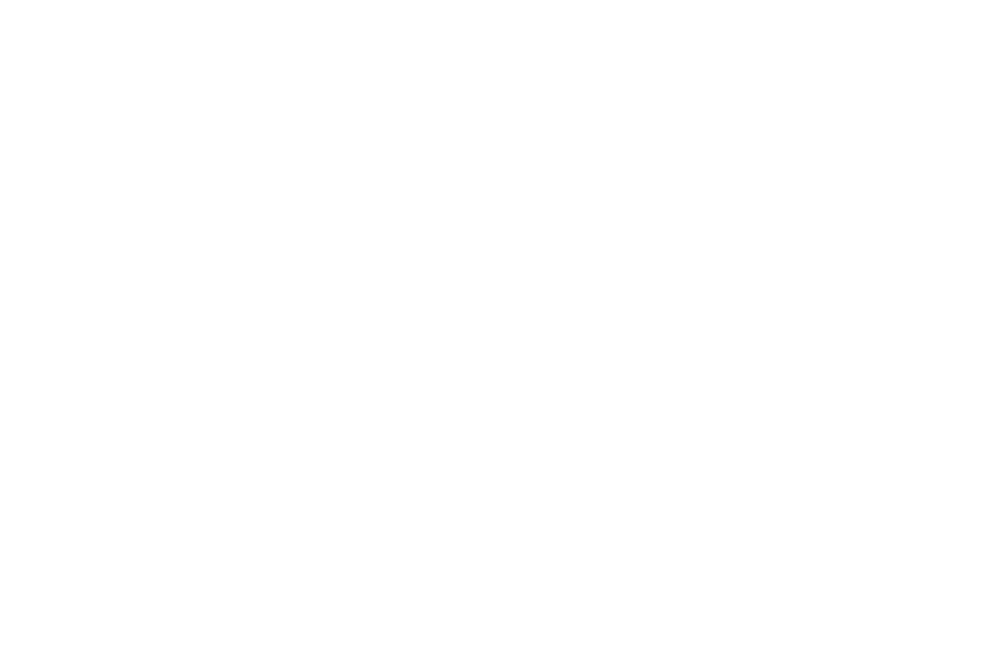

<IPython.core.display.Javascript object>


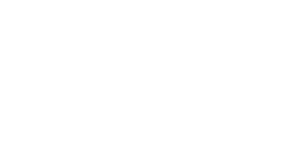

<IPython.core.display.Javascript object>


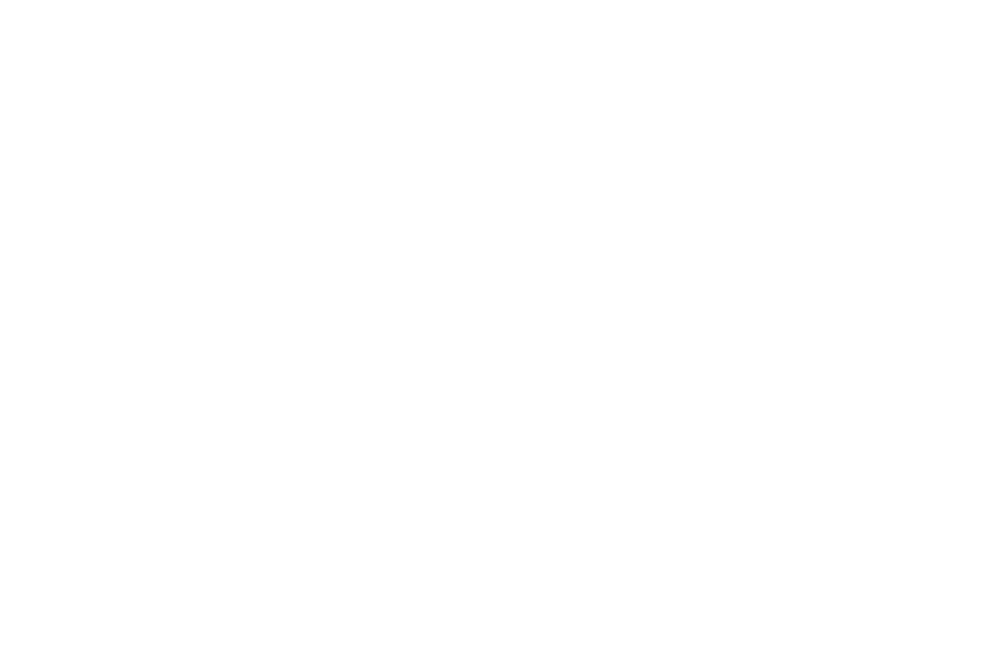

<IPython.core.display.Javascript object>


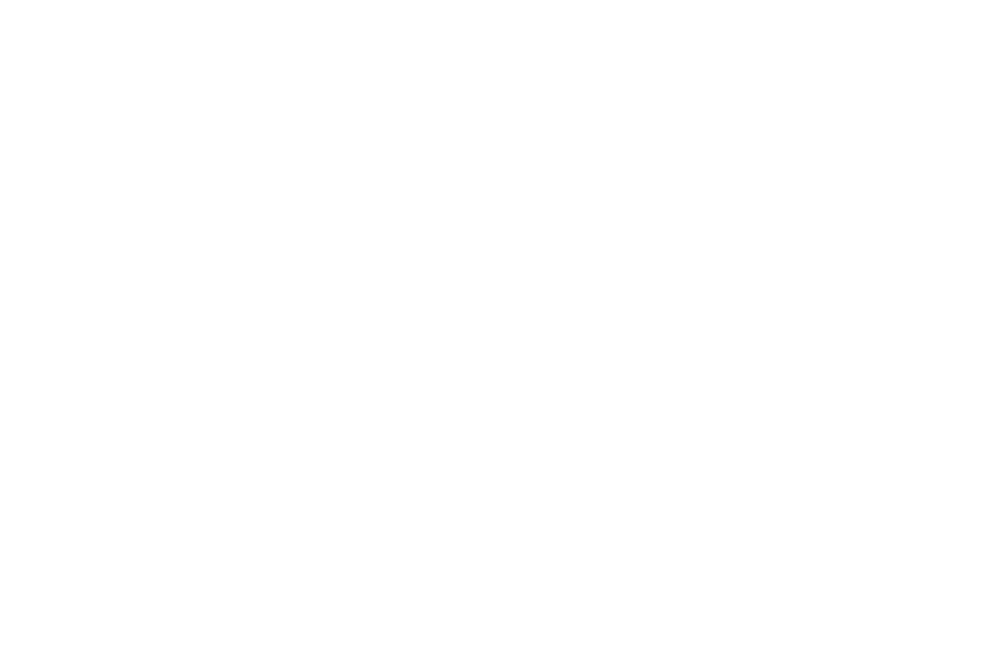

<IPython.core.display.Javascript object>


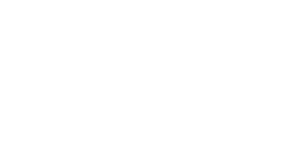

<IPython.core.display.Javascript object>


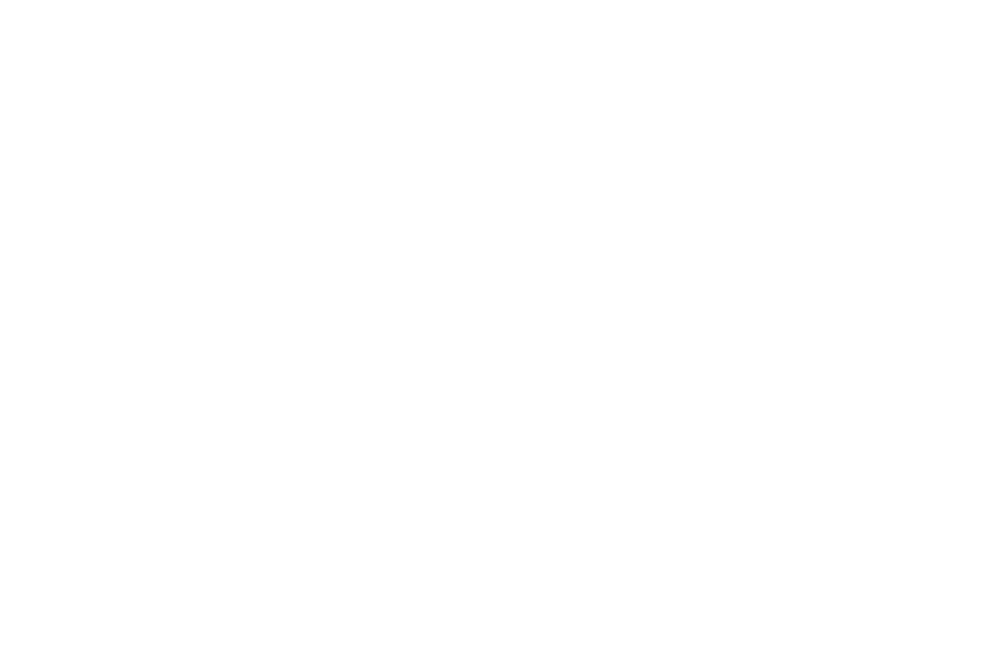

<IPython.core.display.Javascript object>


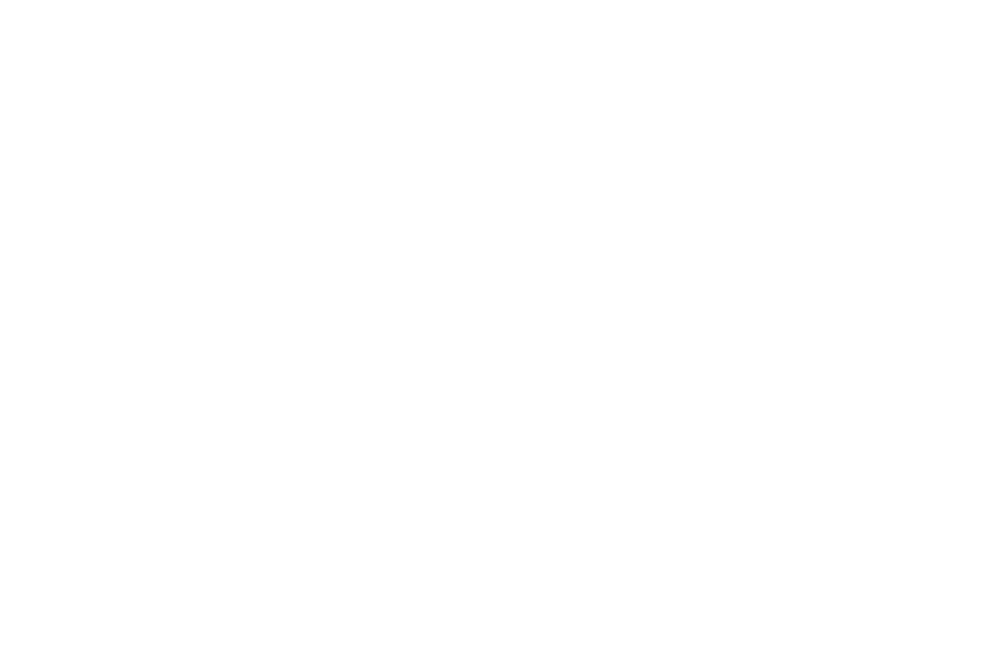

<IPython.core.display.Javascript object>


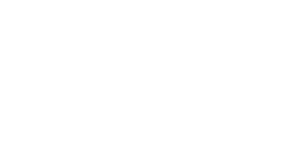

<IPython.core.display.Javascript object>


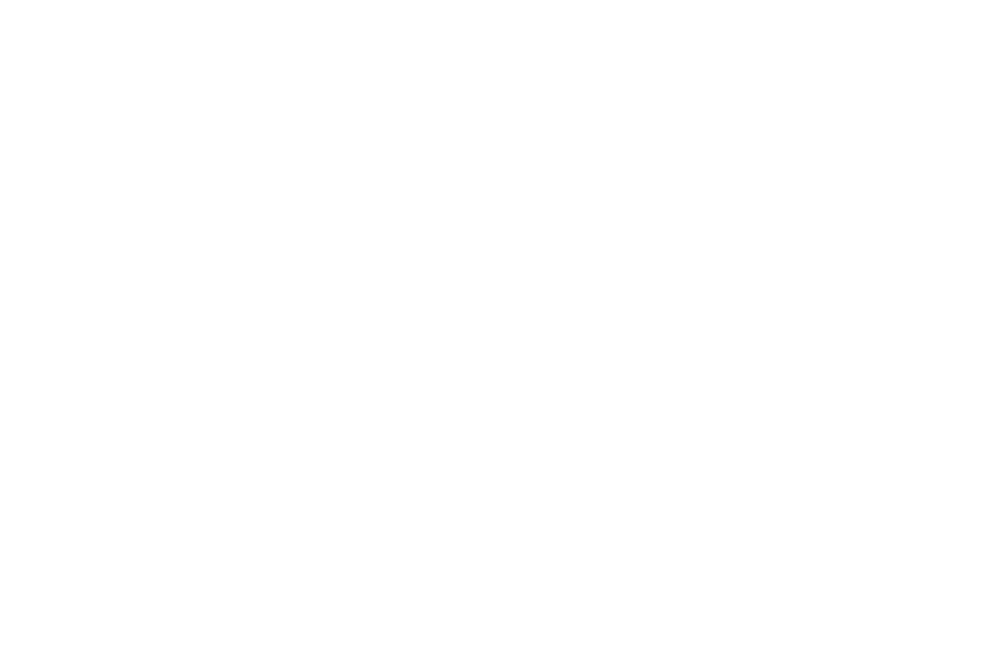

<IPython.core.display.Javascript object>


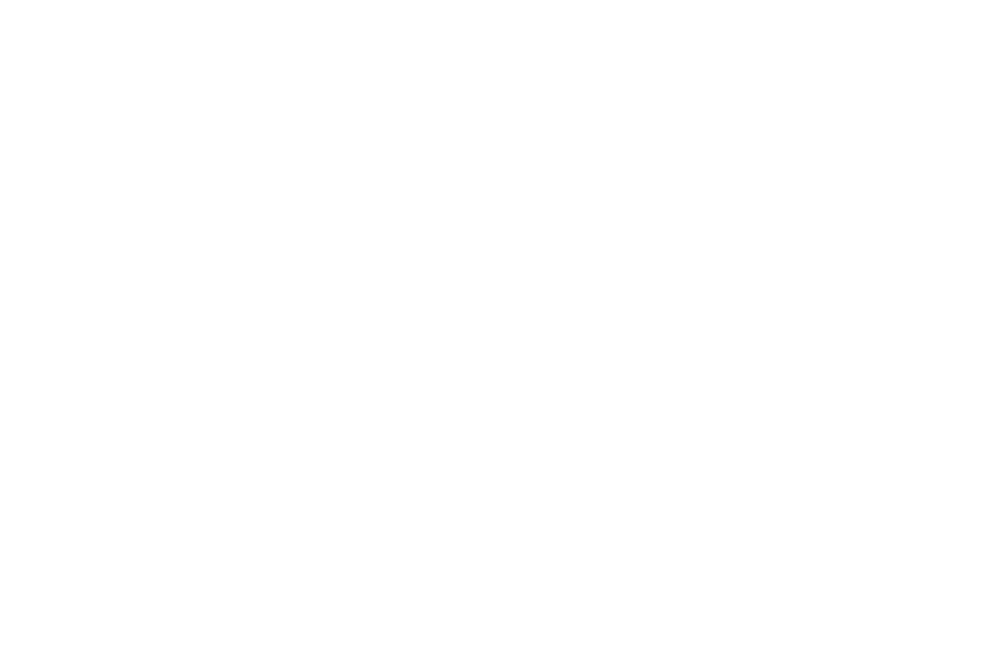

<IPython.core.display.Javascript object>


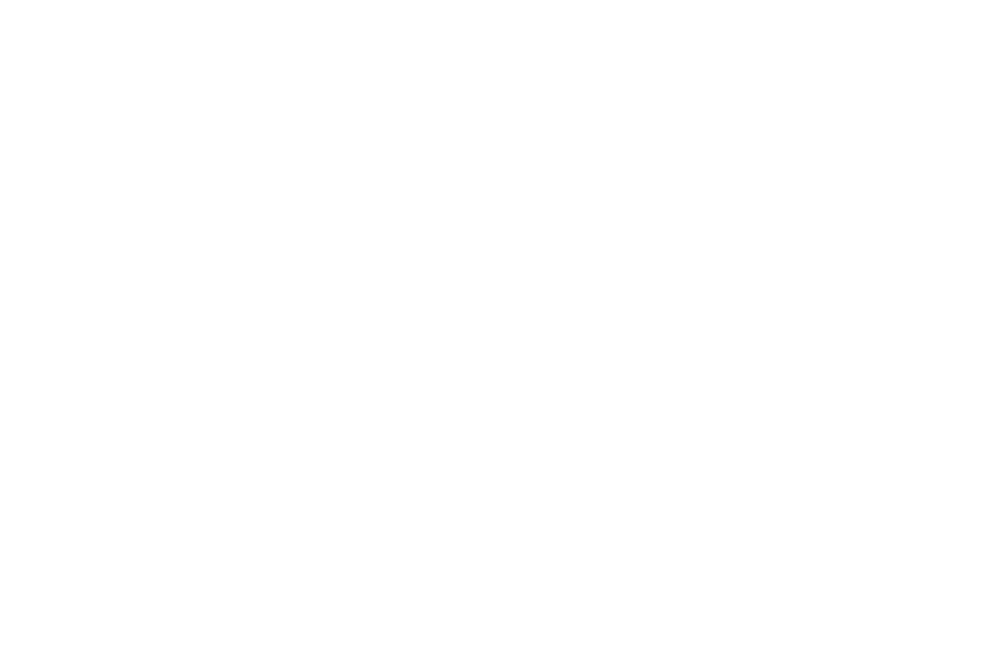

<IPython.core.display.Javascript object>


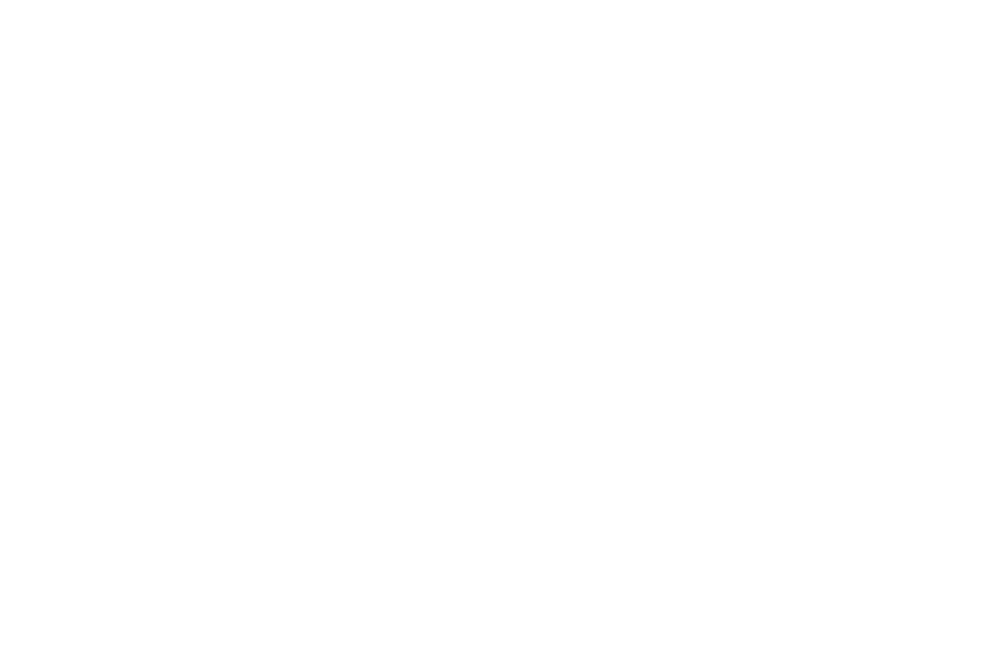

<IPython.core.display.Javascript object>


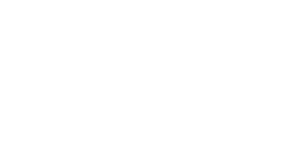

<IPython.core.display.Javascript object>


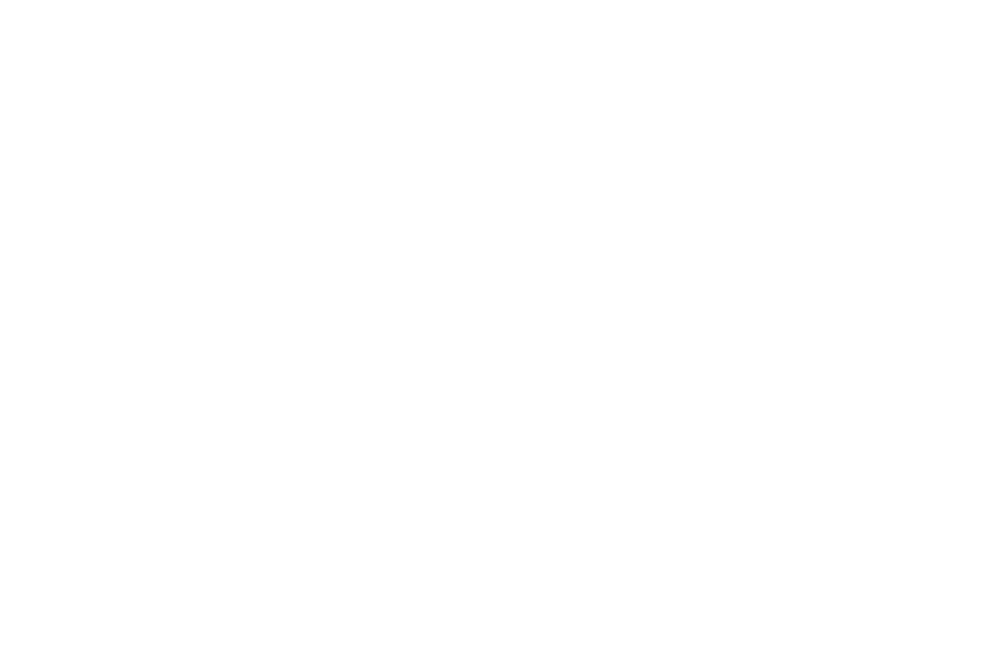

<IPython.core.display.Javascript object>


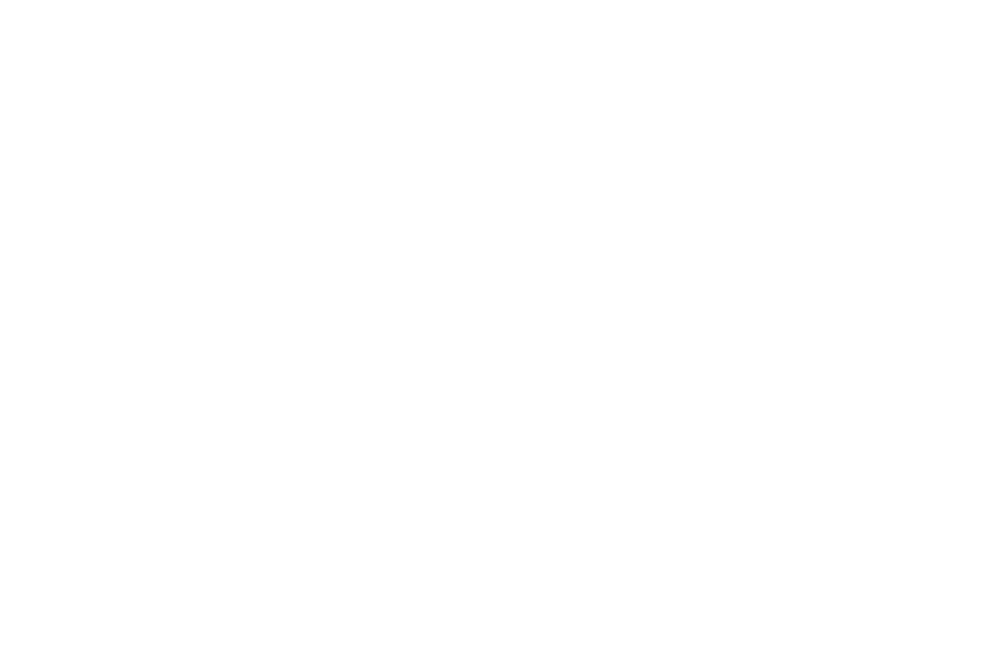

<IPython.core.display.Javascript object>


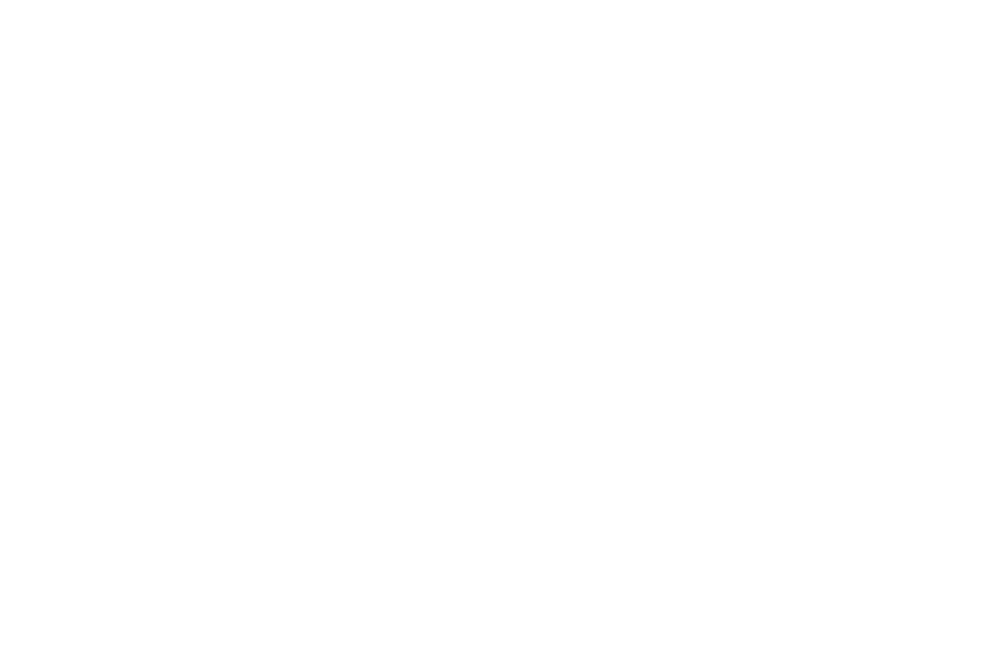

<IPython.core.display.Javascript object>


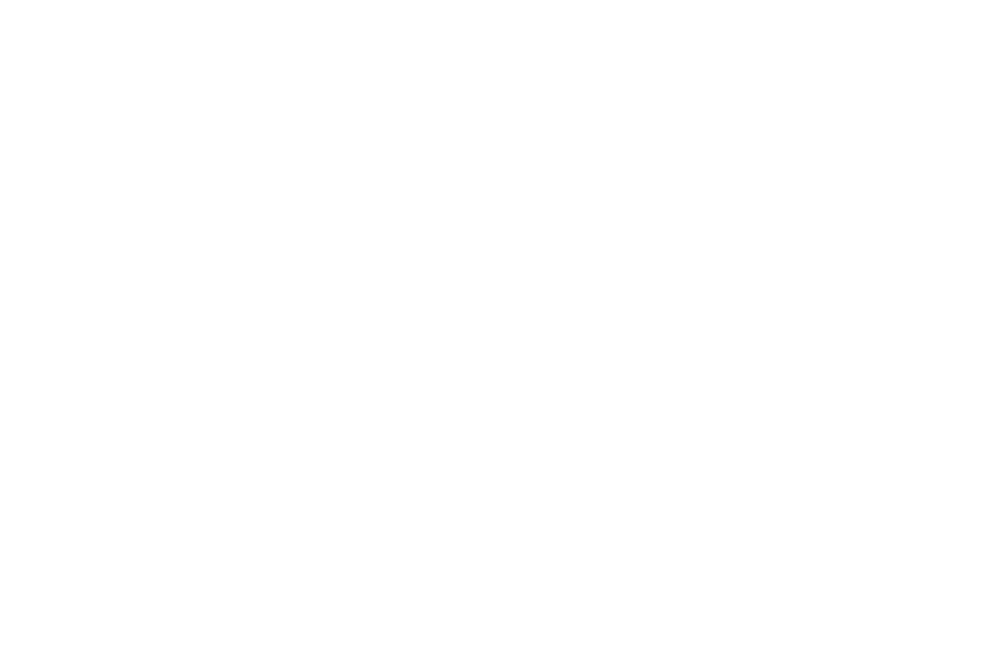

<IPython.core.display.Javascript object>


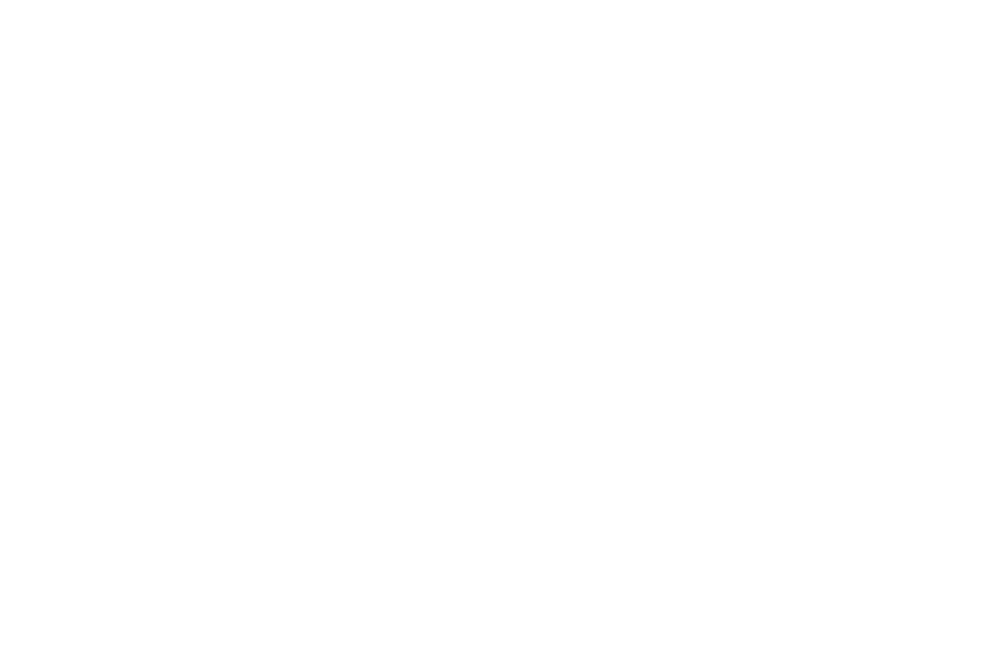

<IPython.core.display.Javascript object>


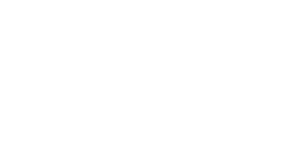

<IPython.core.display.Javascript object>


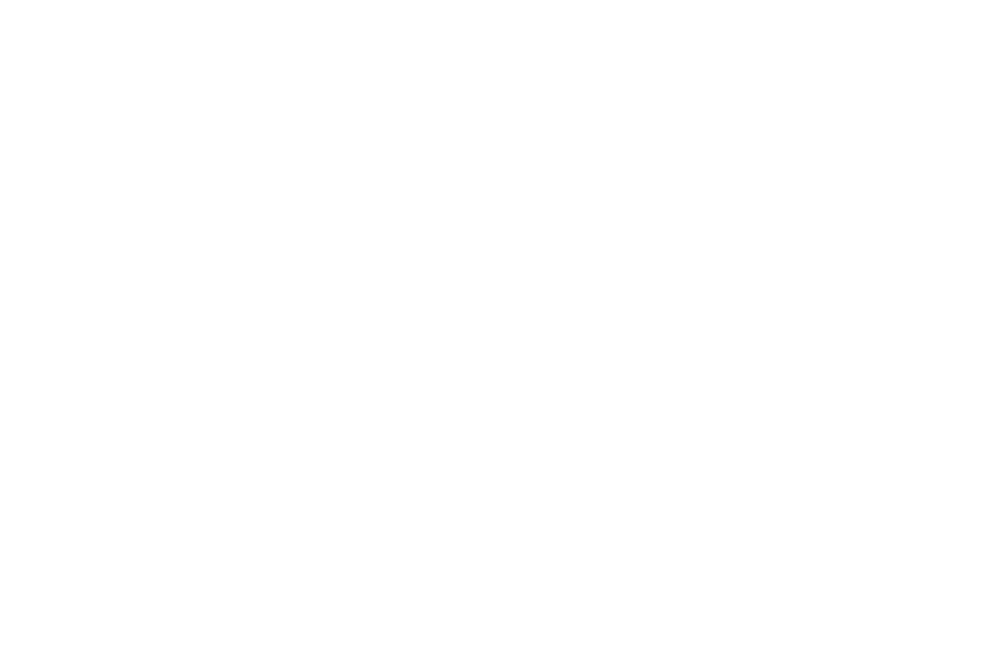

<IPython.core.display.Javascript object>


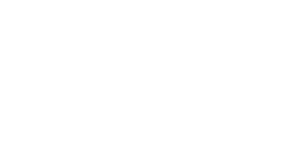

<IPython.core.display.Javascript object>


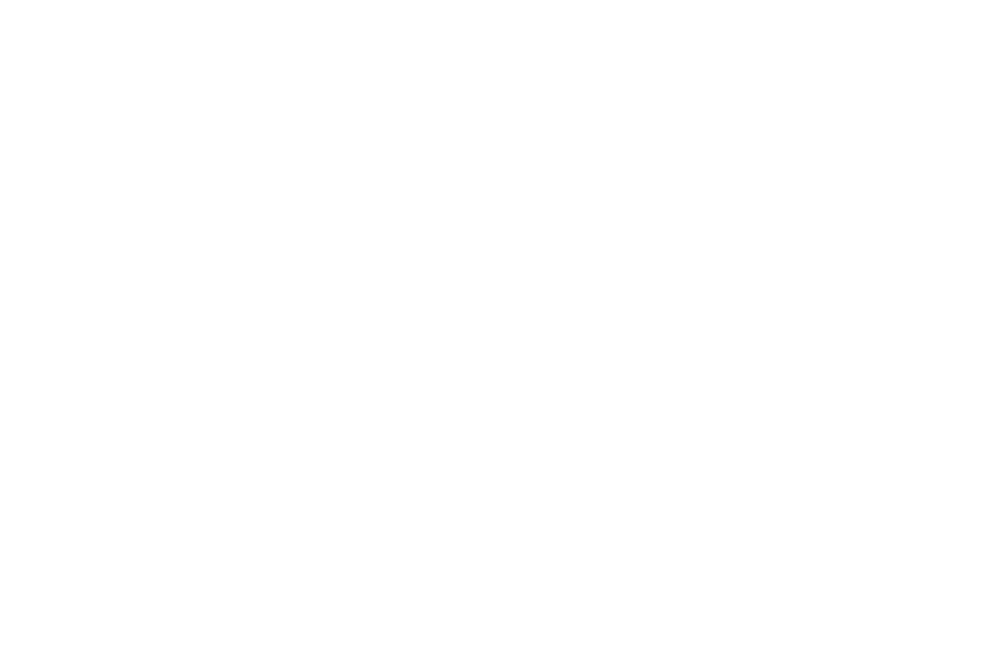

<IPython.core.display.Javascript object>


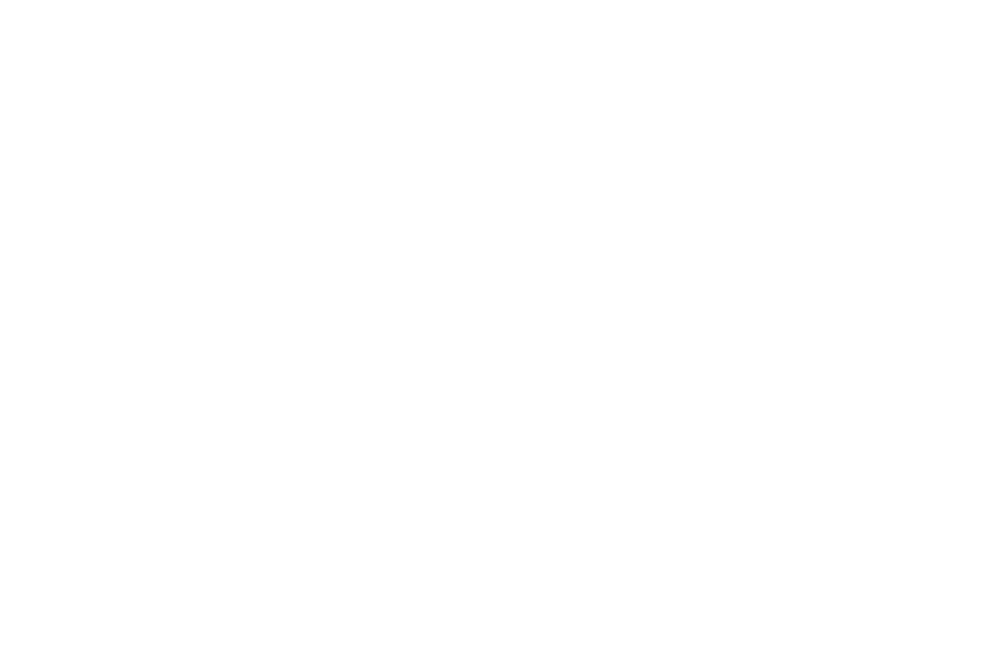

<IPython.core.display.Javascript object>


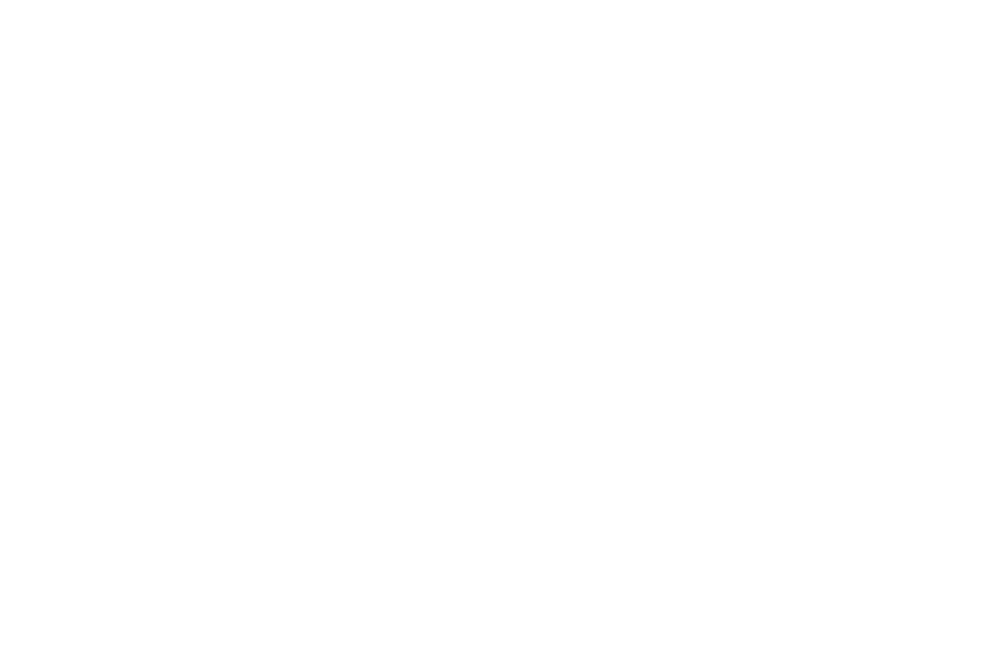

<IPython.core.display.Javascript object>


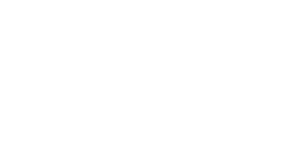

In [41]:
import matplotlib.backends.backend_pdf
pdf = matplotlib.backends.backend_pdf.PdfPages("output_ts.pdf")
for i, ts in enumerate(np.unique(clean_ts_tot)):
    fig, ax1, ax2 = plot_event_ts(ts, marocdata)
    
    pdf.savefig(fig)
    plt.close(fig)
    if i==100:
        break
pdf.close()
plt.close()

TS  0 

<IPython.core.display.Javascript object>


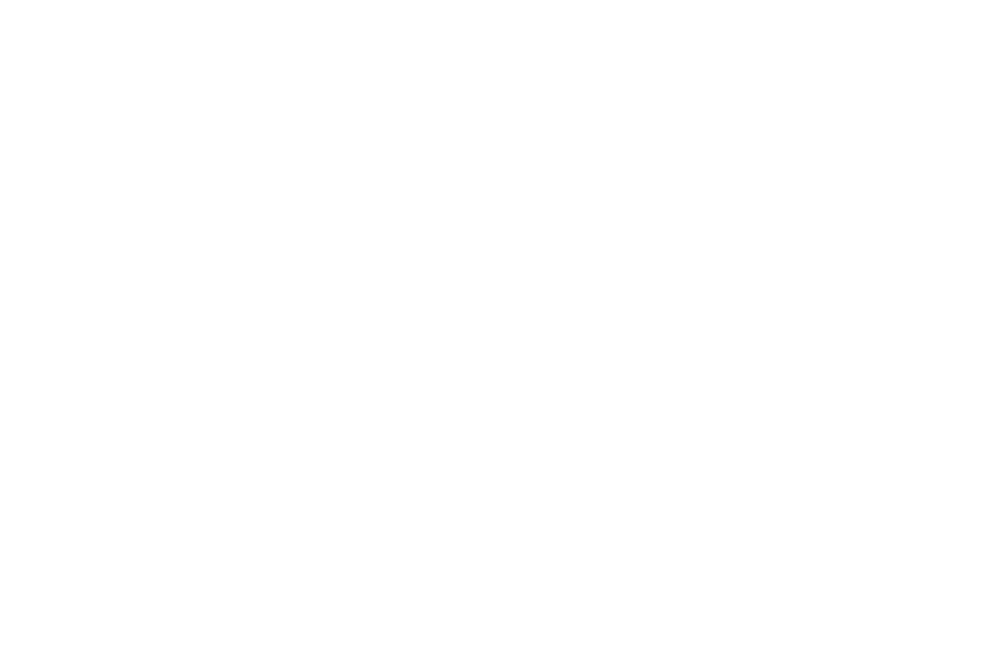

DONE
TS  560399 

<IPython.core.display.Javascript object>


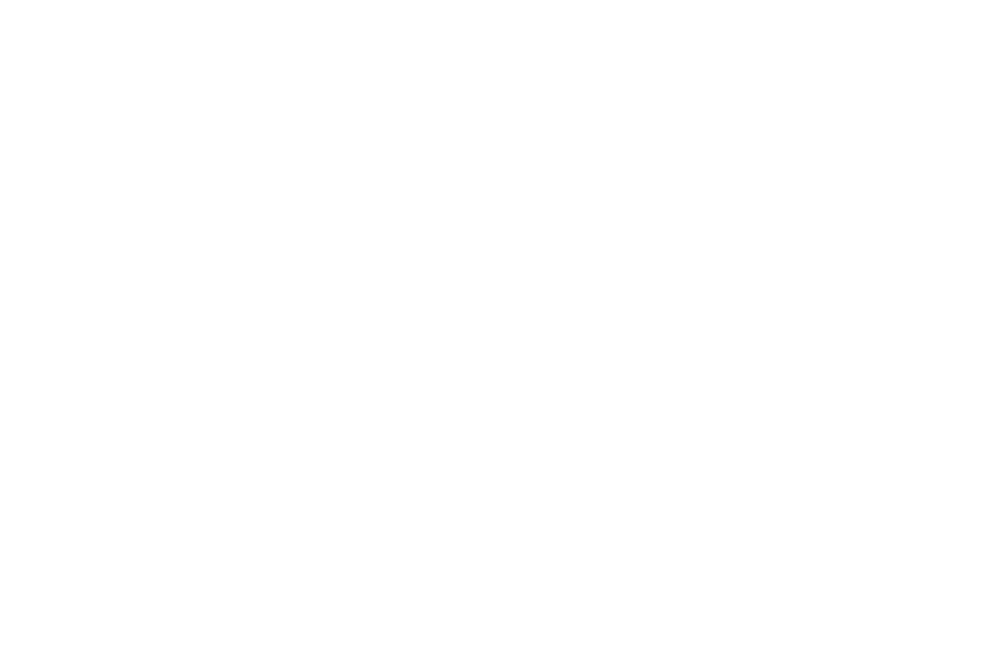

DONE
SKIPPING 560400
TS  5806702 

<IPython.core.display.Javascript object>


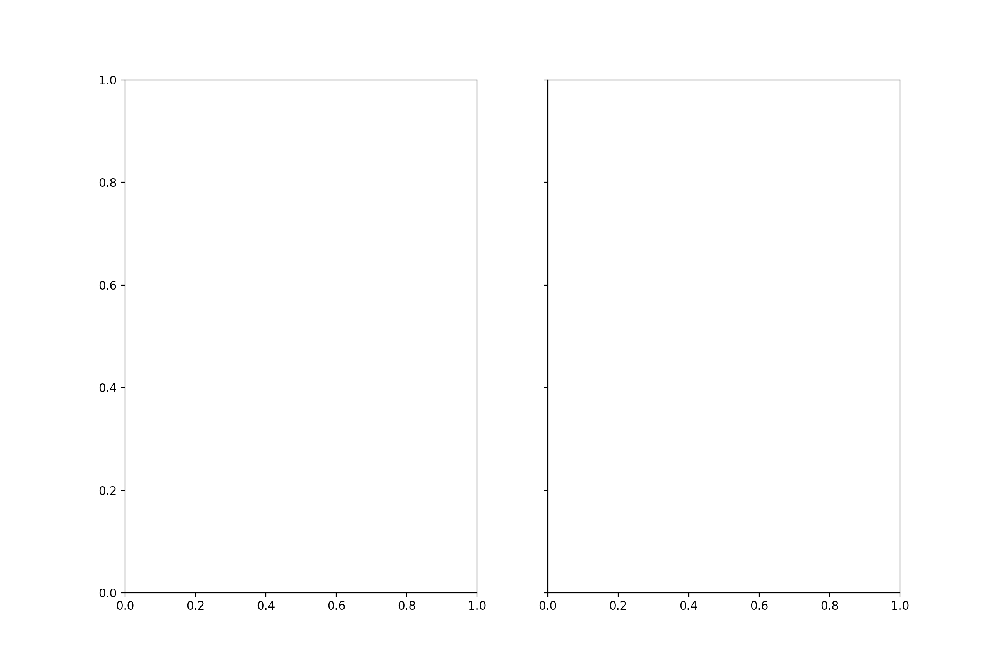

TS  6367101 

<IPython.core.display.Javascript object>


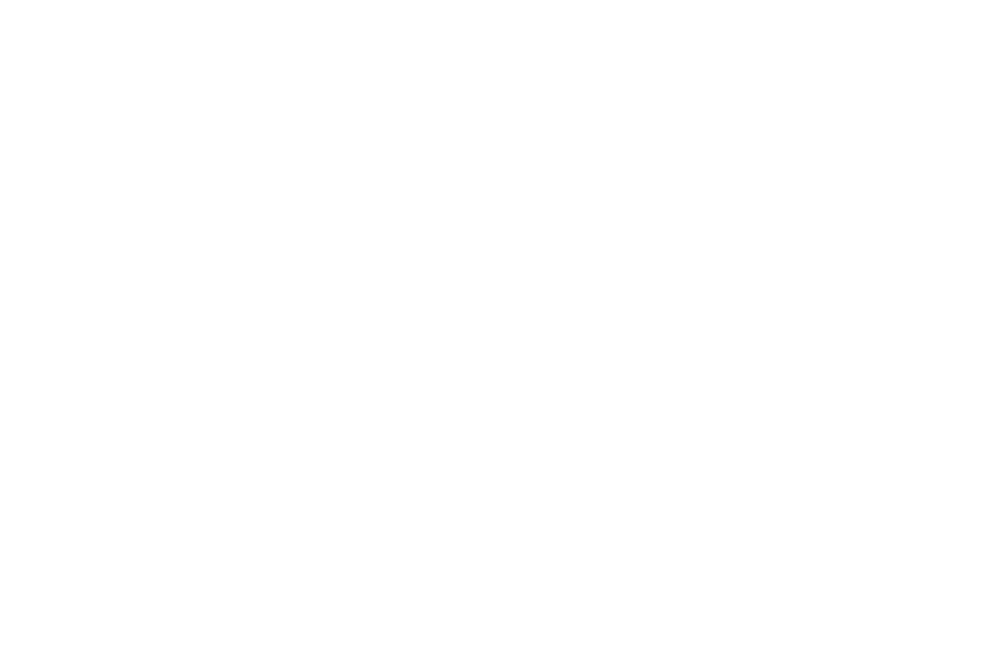

DONE
SKIPPING 6367102
TS  6873639 

<IPython.core.display.Javascript object>


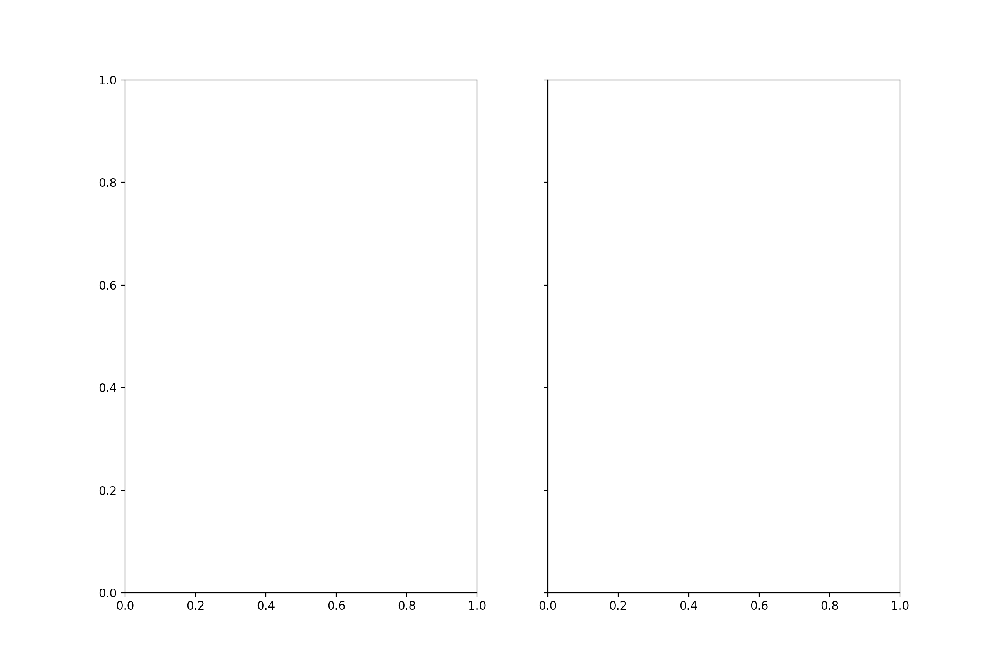

TS  7434038 

<ipython-input-84-0f38b4544f85>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,8), sharey=True, sharex=True)


<IPython.core.display.Javascript object>


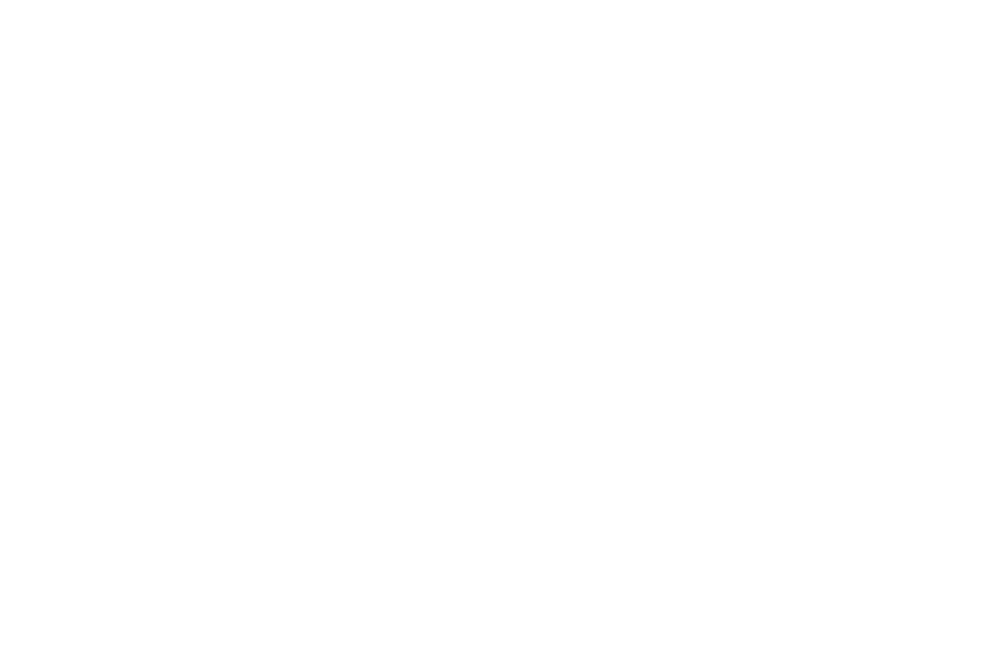

DONE
SKIPPING 7434039
TS  12703194 

<ipython-input-84-0f38b4544f85>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,8), sharey=True, sharex=True)


<IPython.core.display.Javascript object>


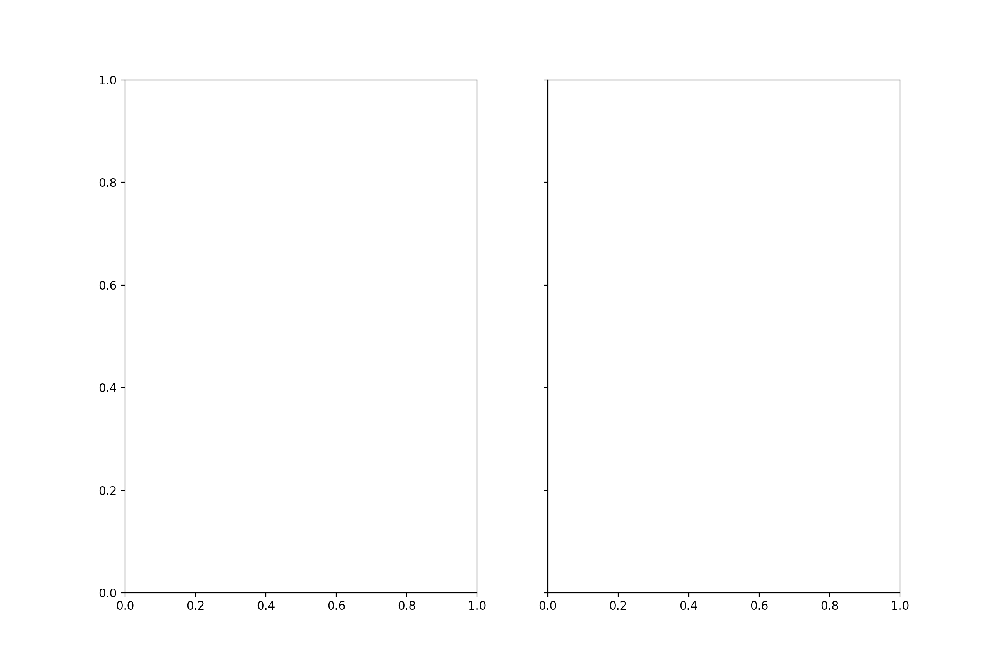

TS  13263593 

<IPython.core.display.Javascript object>


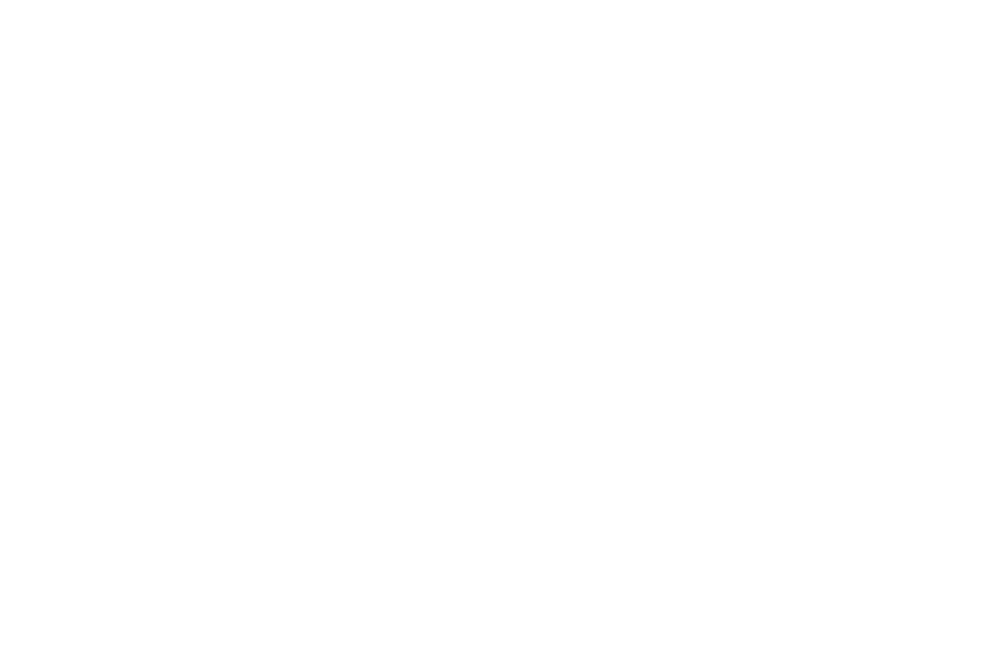

DONE
SKIPPING 13263594
TS  13275449 

<IPython.core.display.Javascript object>


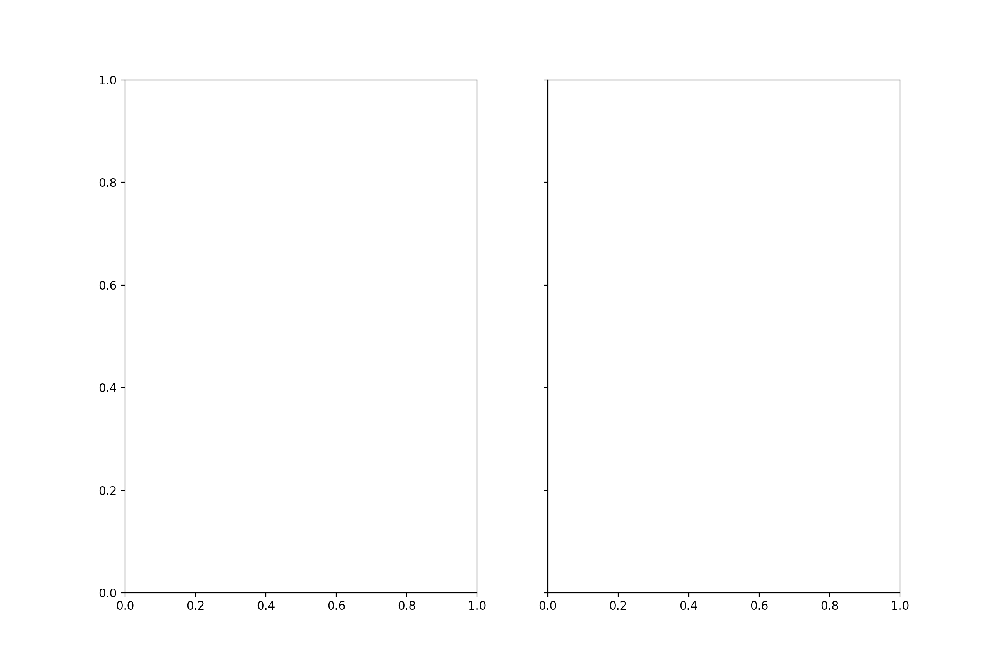

TS  13835848 

<IPython.core.display.Javascript object>


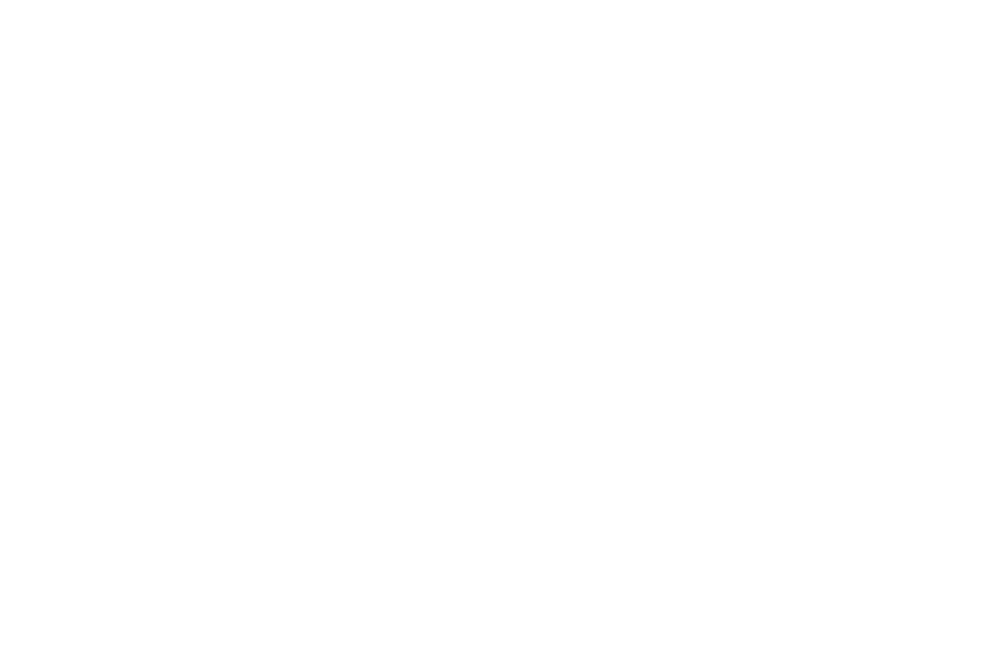

DONE
SKIPPING 13835849
TS  15894890 

<IPython.core.display.Javascript object>


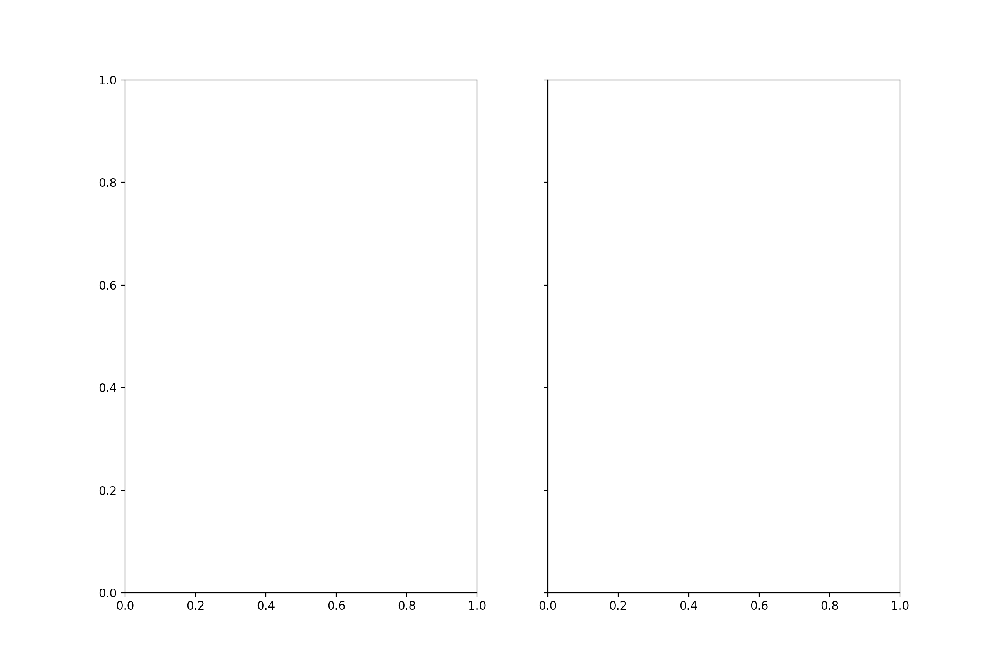

TS  16455289 

<IPython.core.display.Javascript object>


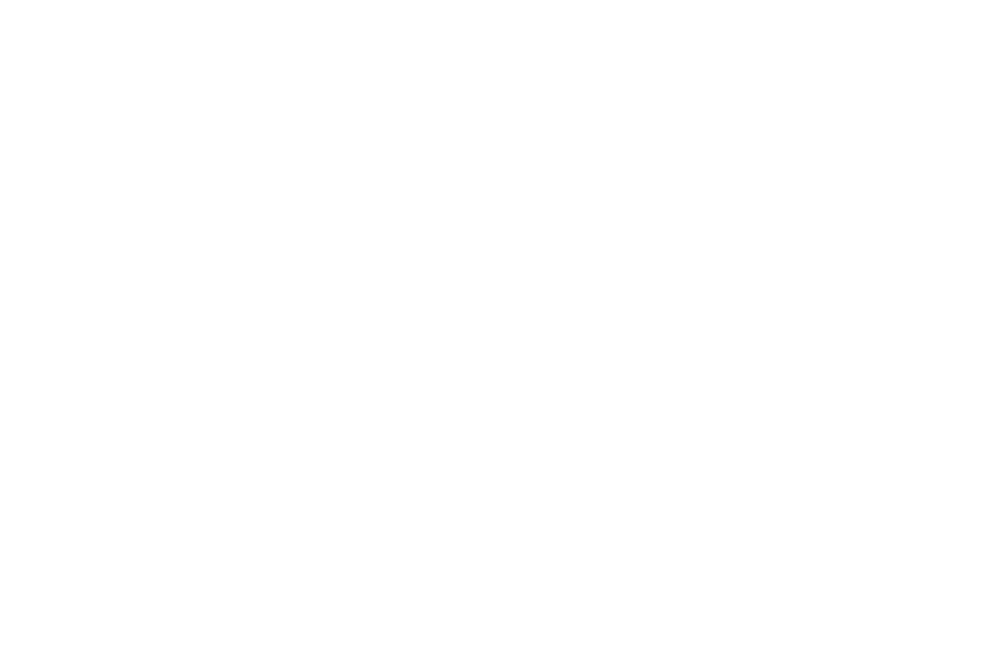

DONE
SKIPPING 16455290
TS  16921101 

<IPython.core.display.Javascript object>


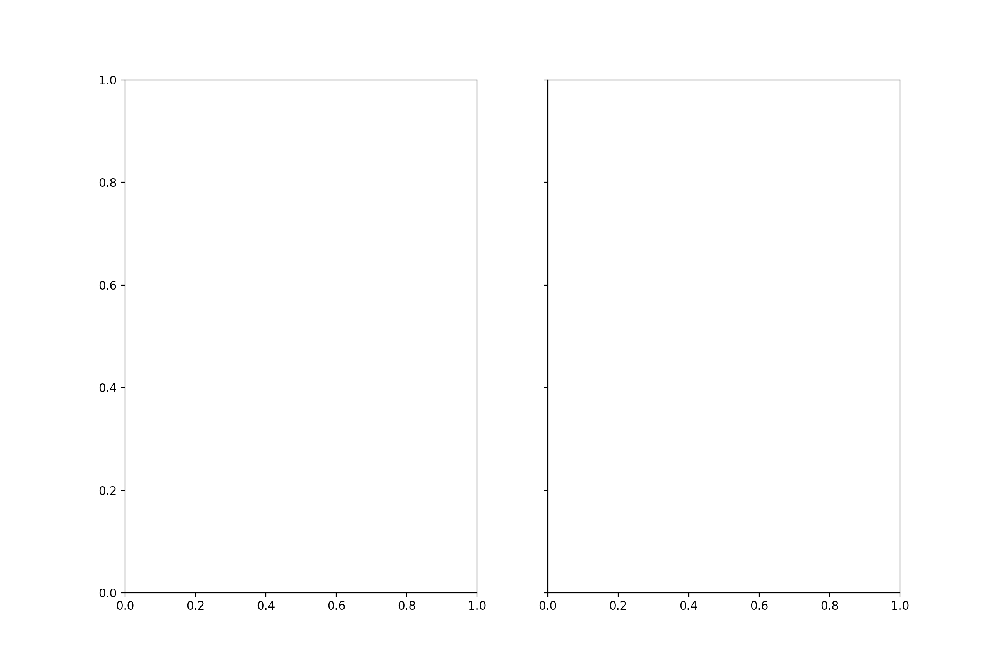

TS  17481501 

<IPython.core.display.Javascript object>


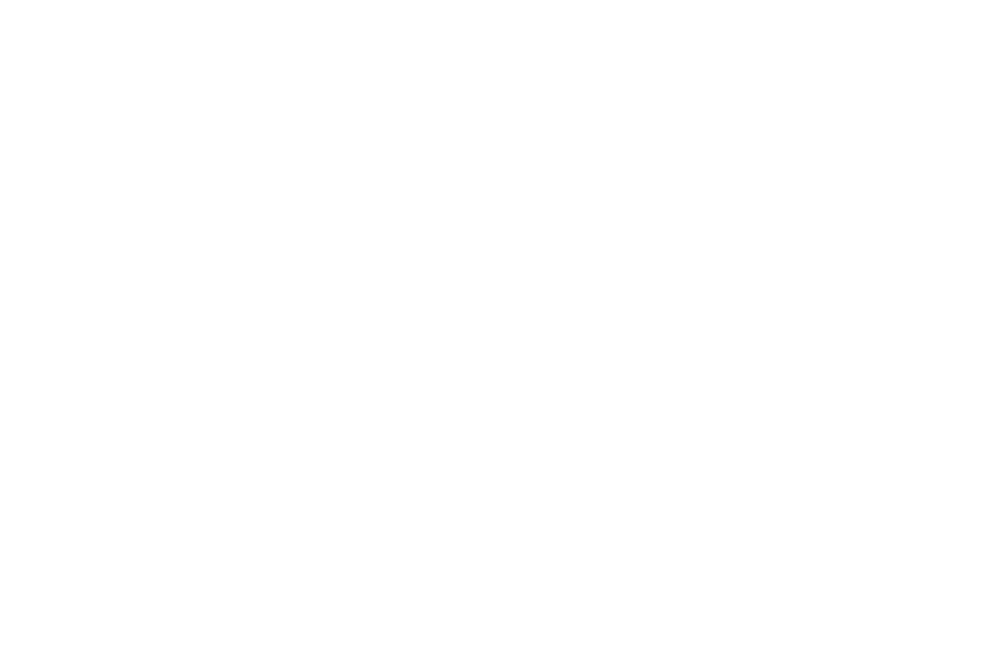

DONE
TS  21374521 

<IPython.core.display.Javascript object>


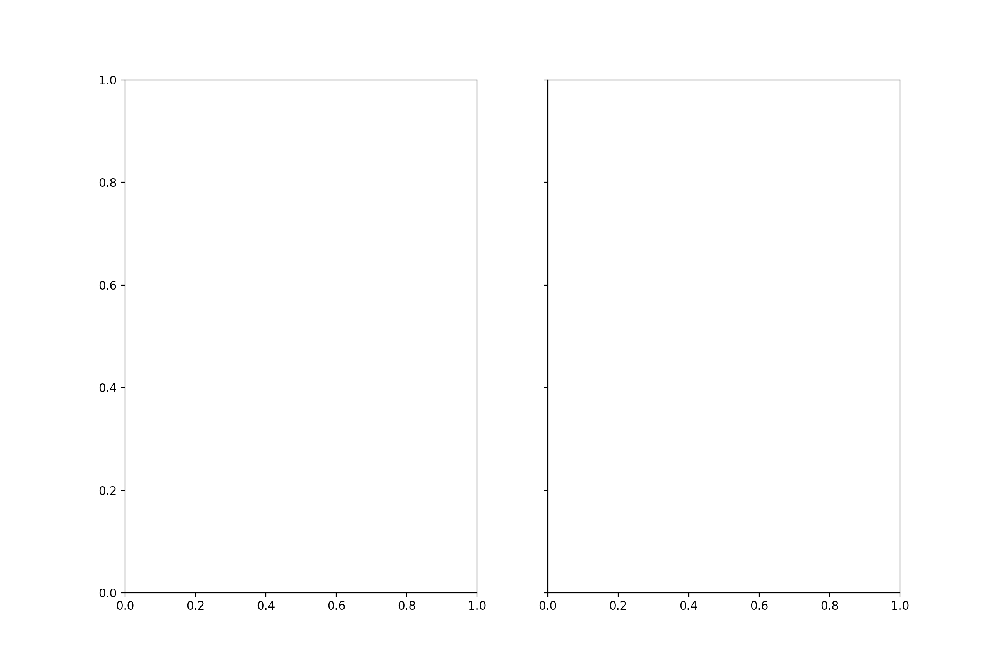

TS  21459403 

<IPython.core.display.Javascript object>


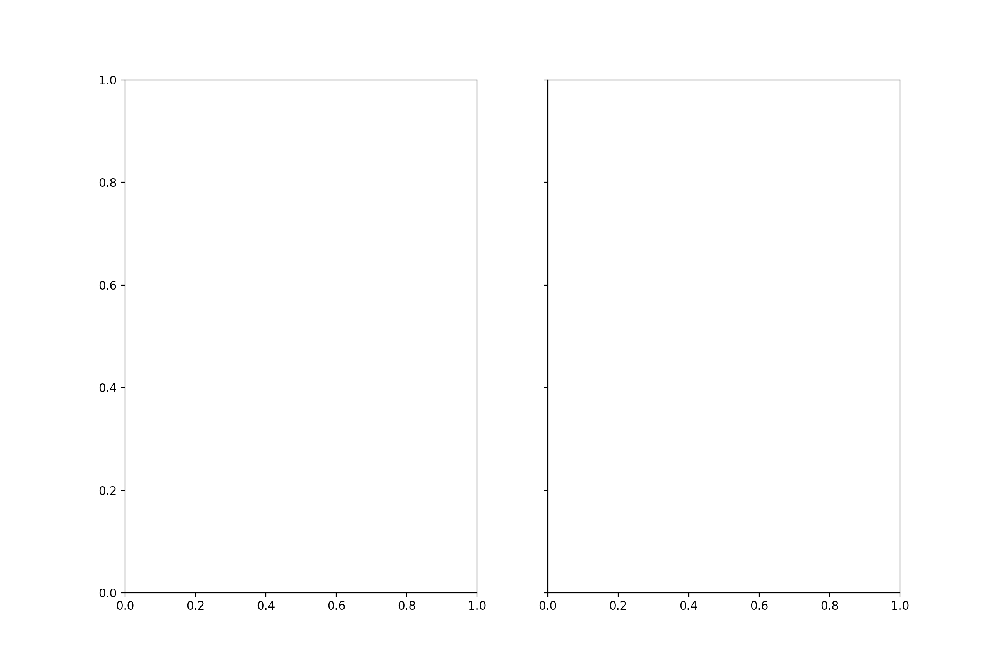

TS  21934921 

<IPython.core.display.Javascript object>


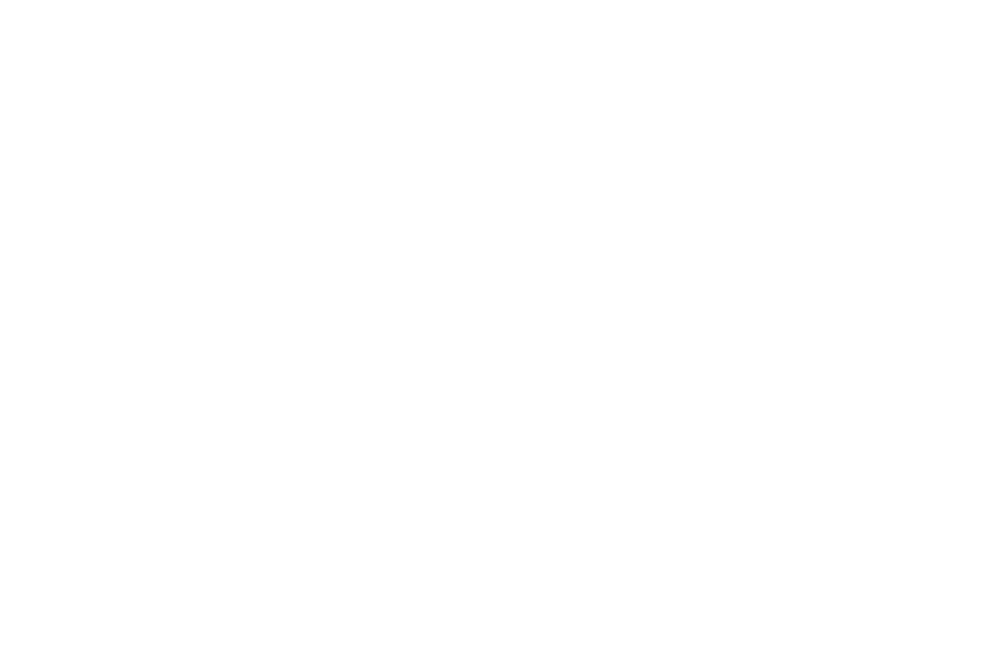

DONE
TS  22019802 

<IPython.core.display.Javascript object>


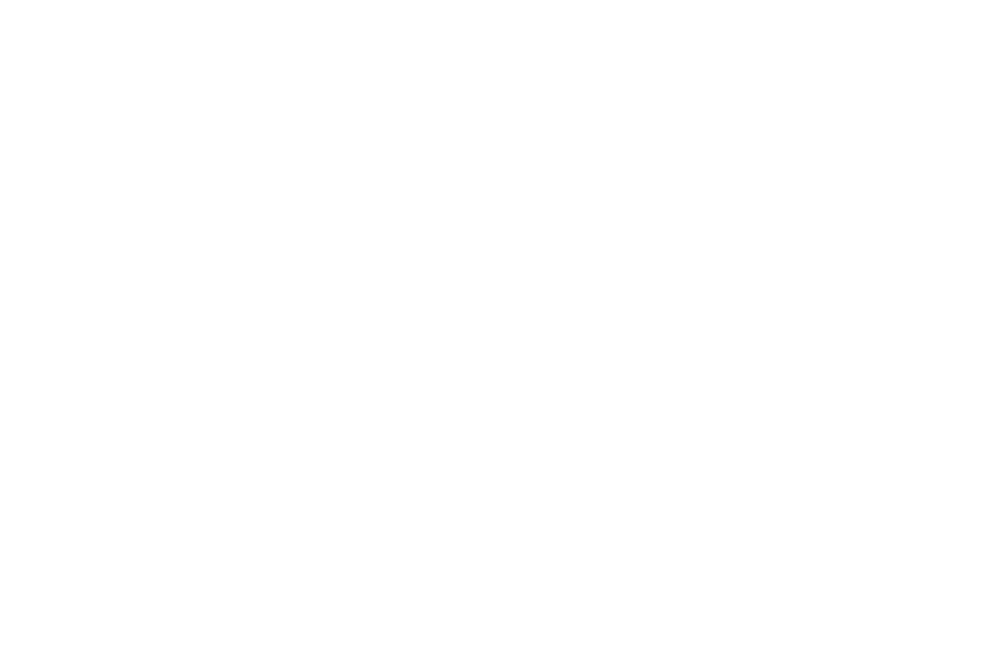

DONE
SKIPPING 22019803
TS  24354629 

<IPython.core.display.Javascript object>


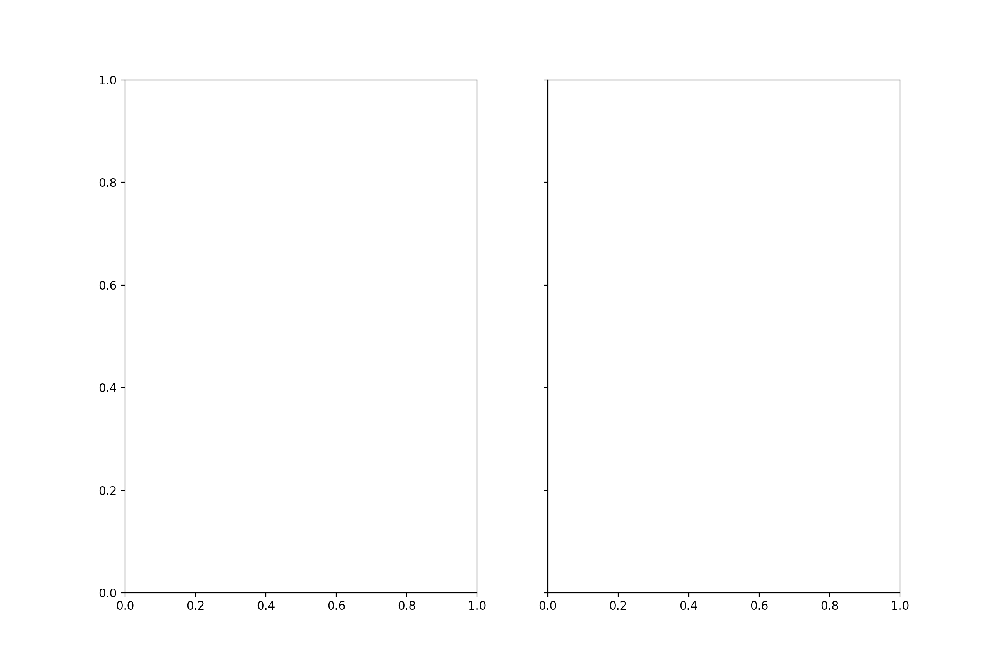

TS  24915028 

<IPython.core.display.Javascript object>


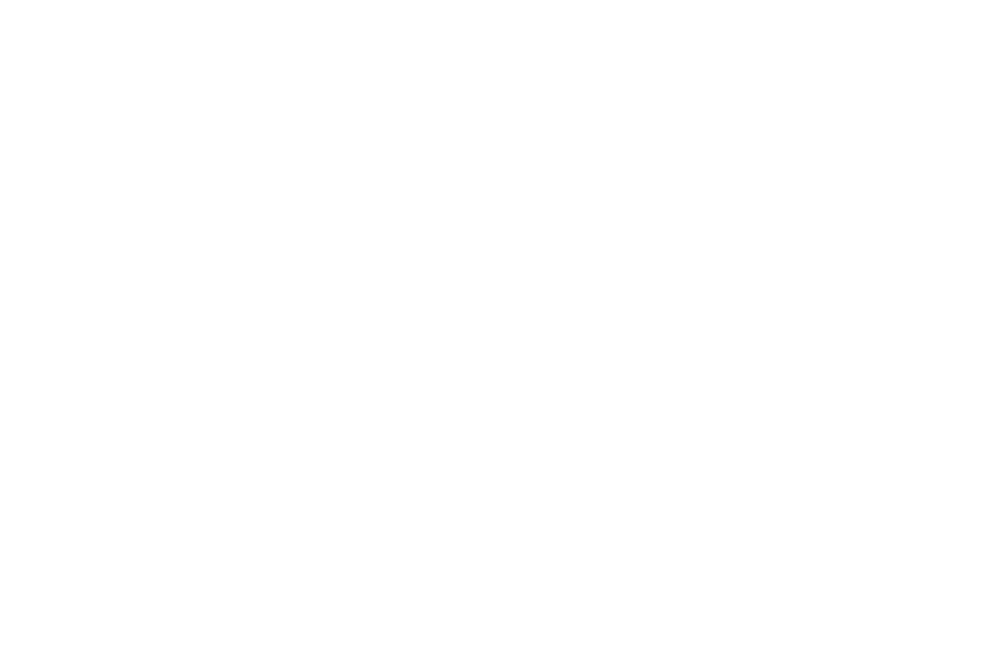

DONE
SKIPPING 24915029
TS  24996072 

<IPython.core.display.Javascript object>


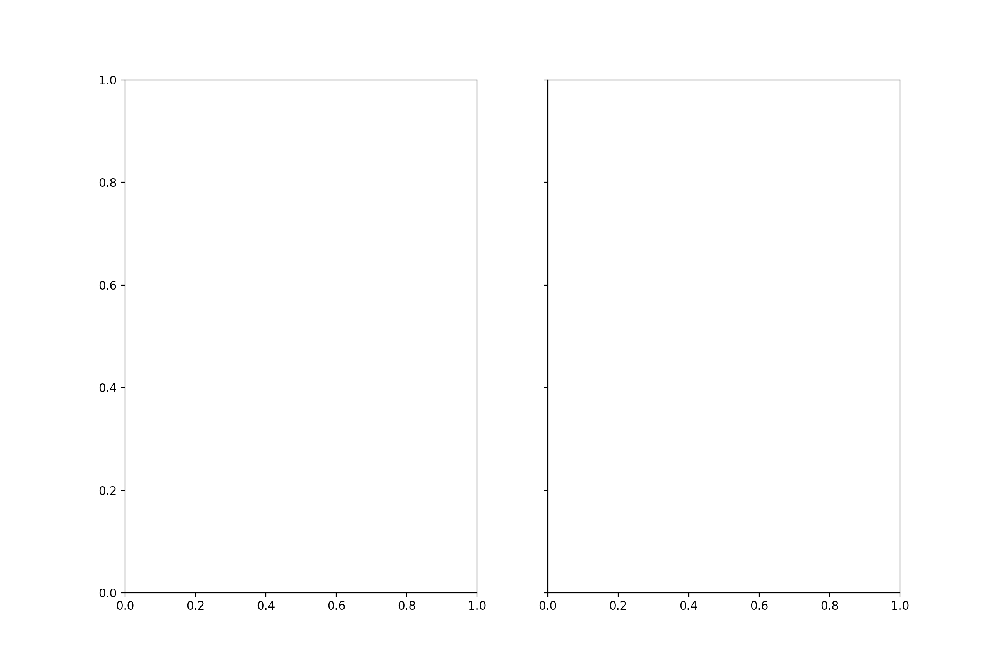

TS  25556471 

<IPython.core.display.Javascript object>


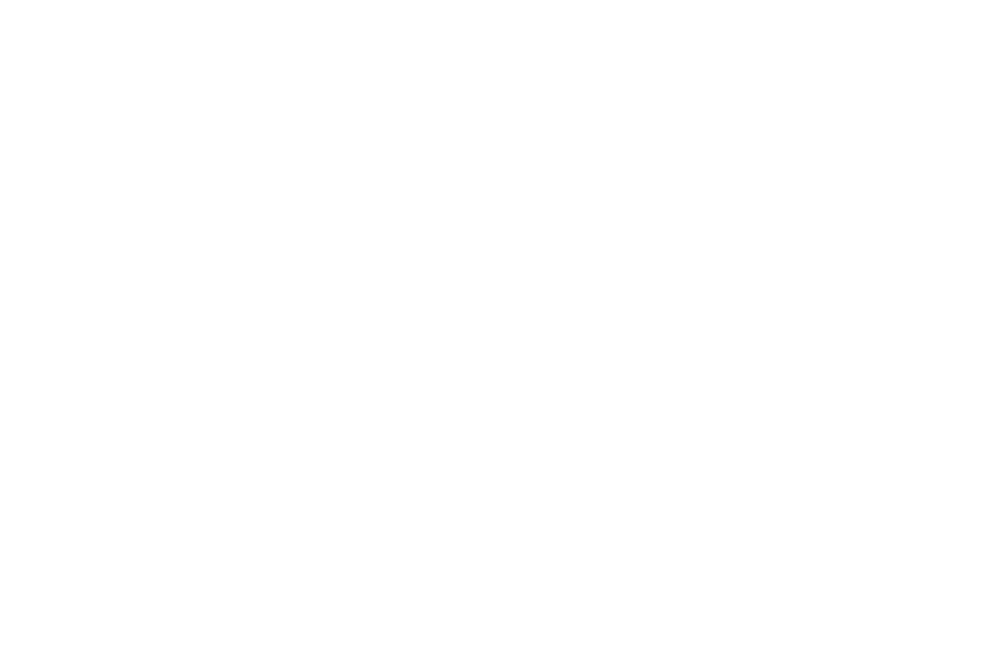

DONE
SKIPPING 25556472
TS  27606704 

<IPython.core.display.Javascript object>


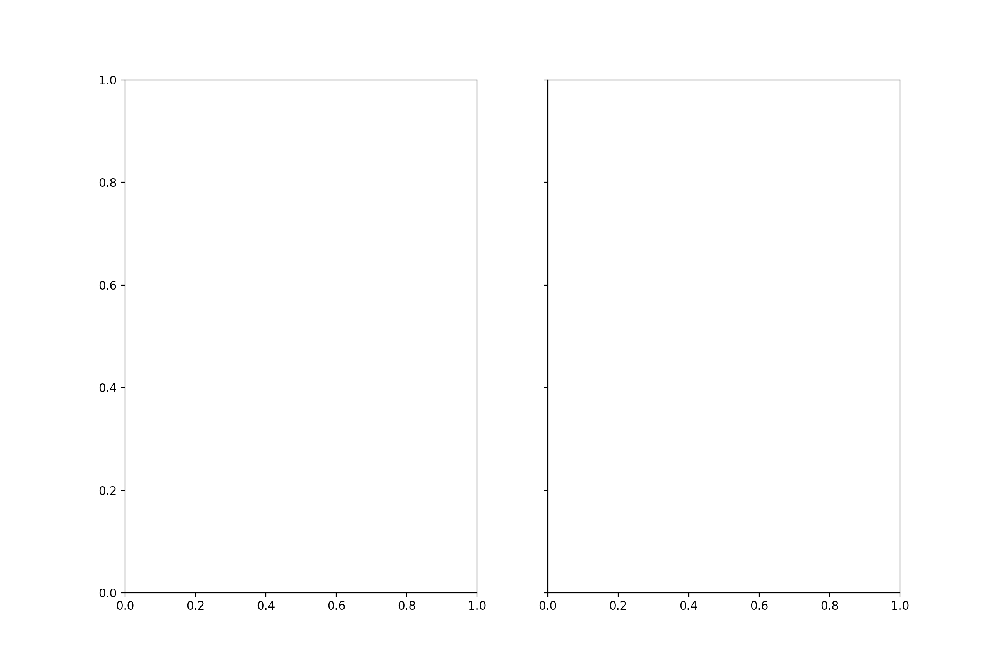

TS  28167103 

<IPython.core.display.Javascript object>


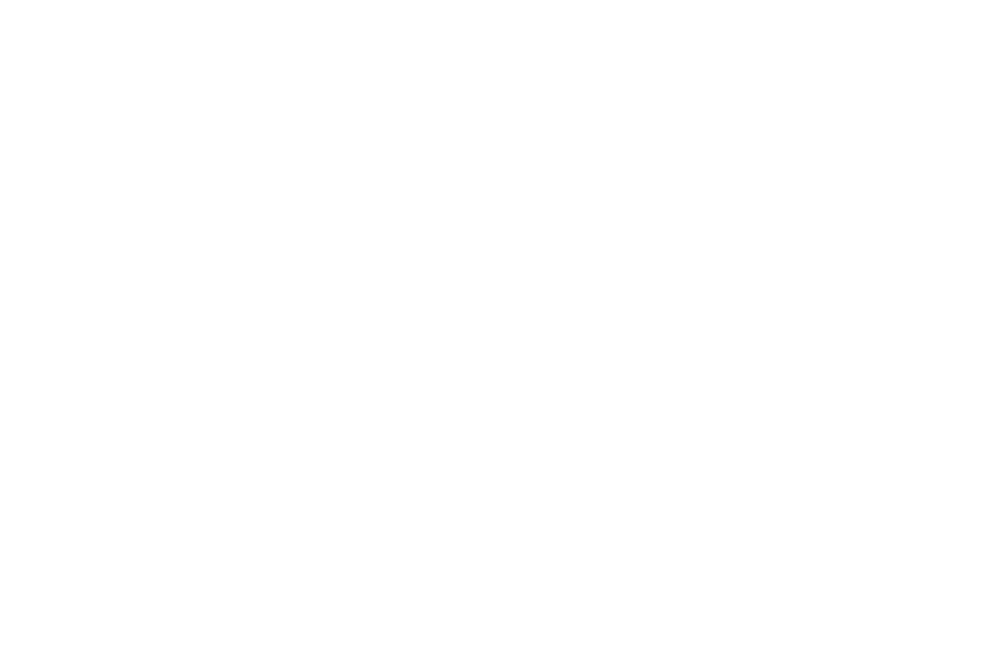

DONE
SKIPPING 28167104
TS  31426995 

<IPython.core.display.Javascript object>


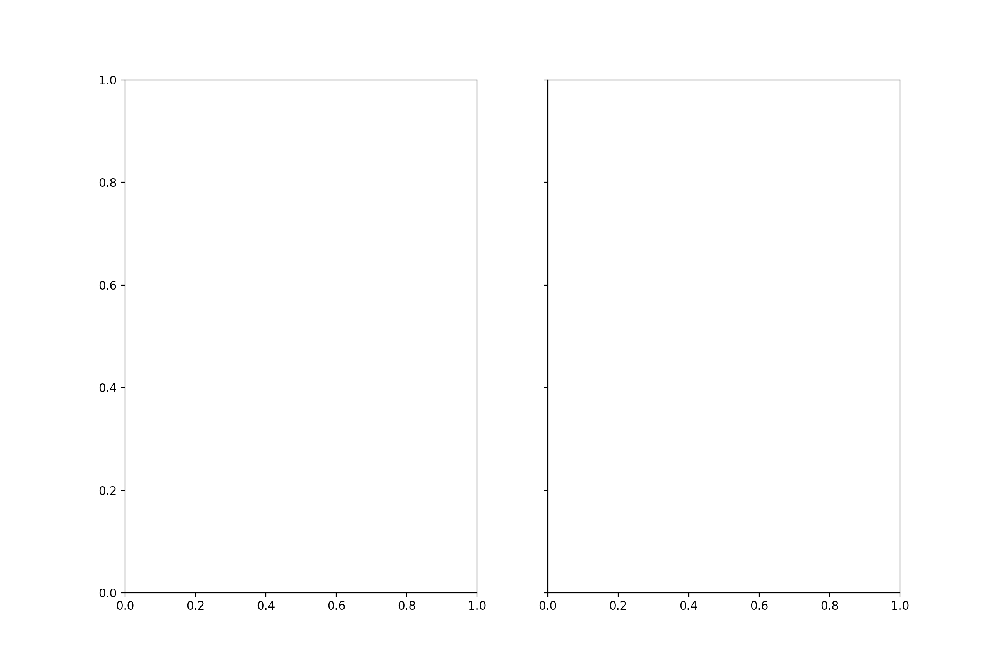

TS  31987394 

<IPython.core.display.Javascript object>


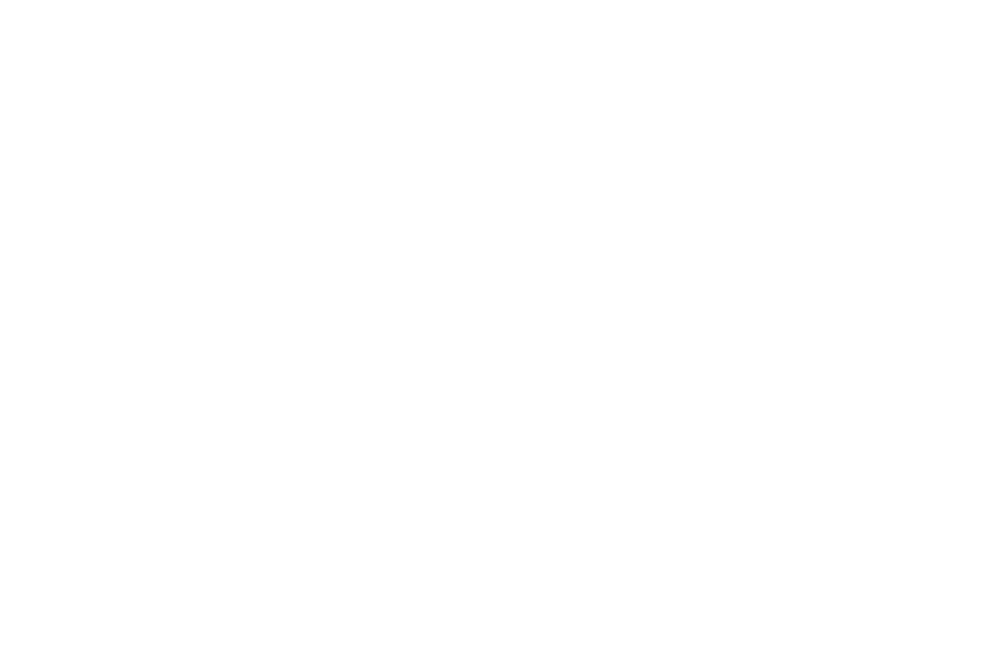

DONE
SKIPPING 31987395
TS  32265463 

<IPython.core.display.Javascript object>


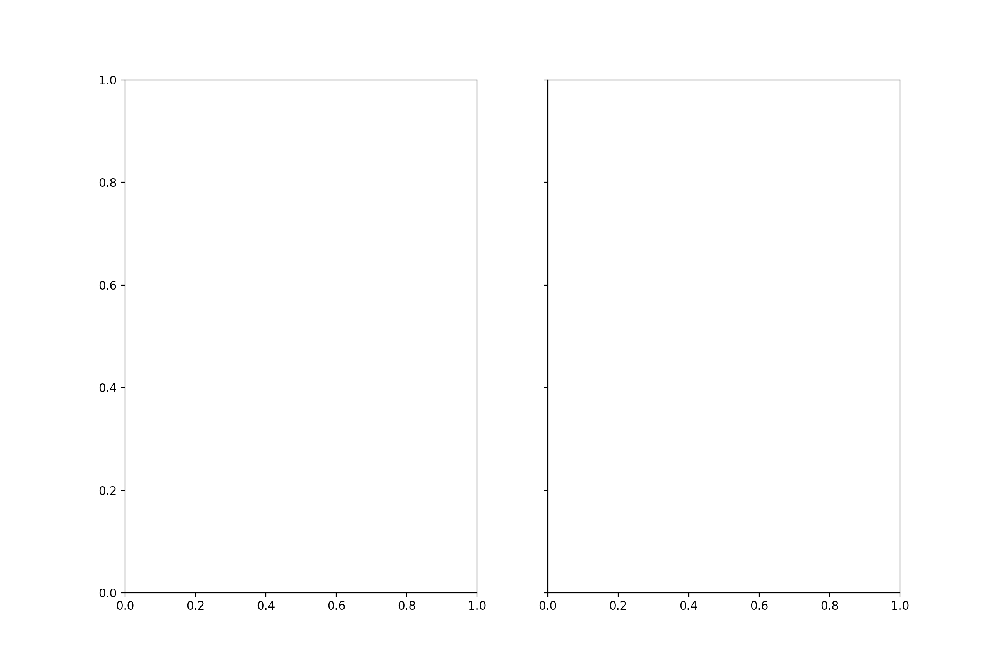

TS  32825862 

<IPython.core.display.Javascript object>


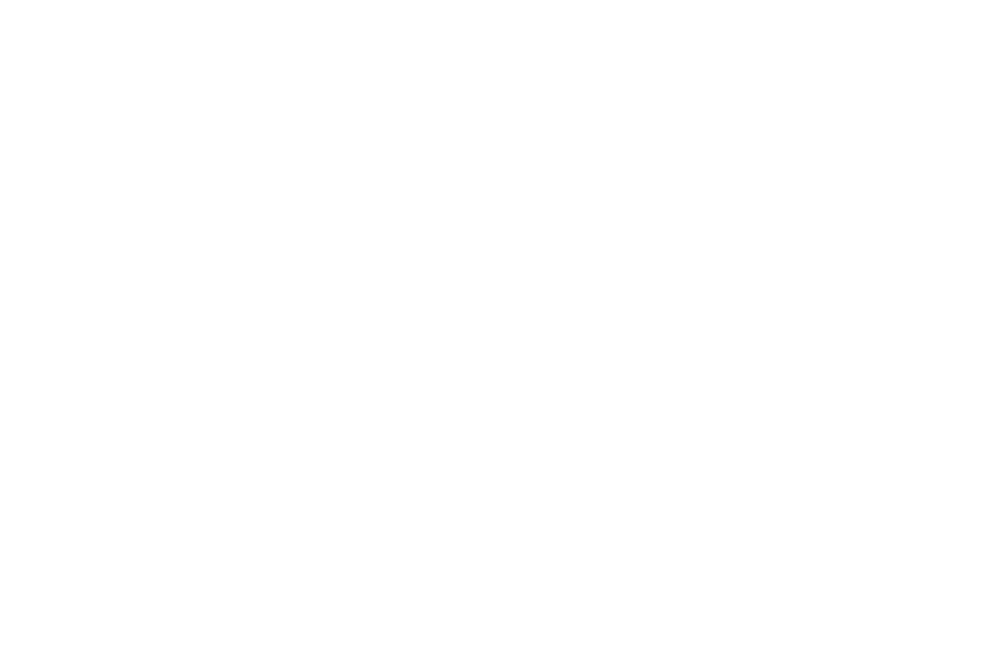

DONE
SKIPPING 32825863
TS  34264395 

<IPython.core.display.Javascript object>


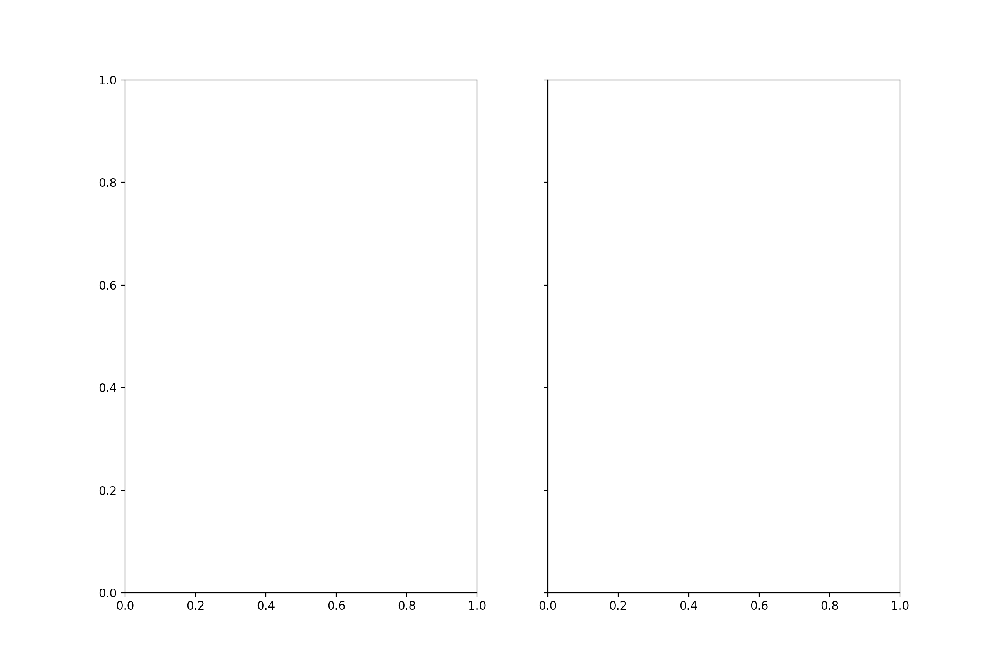

TS  34824794 

<IPython.core.display.Javascript object>


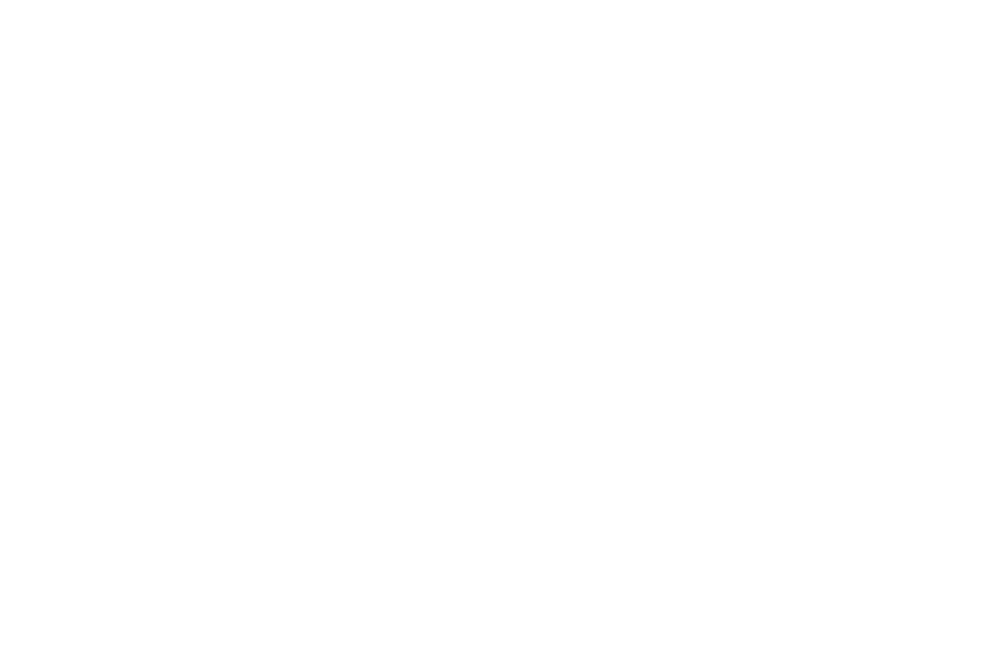

DONE
SKIPPING 34824795
TS  36877543 

<IPython.core.display.Javascript object>


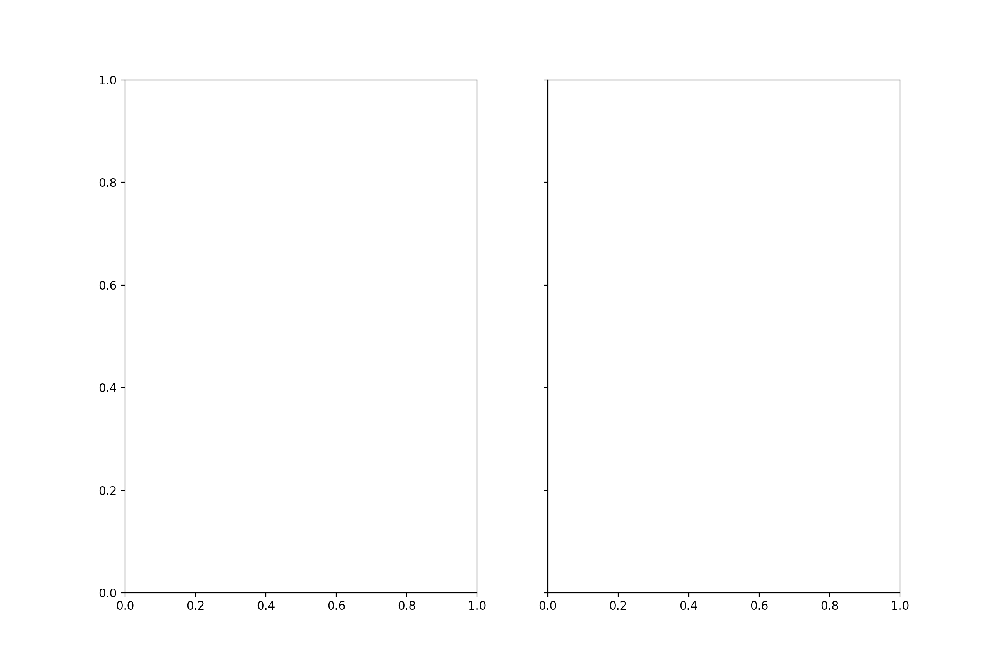

TS  37437943 

<IPython.core.display.Javascript object>


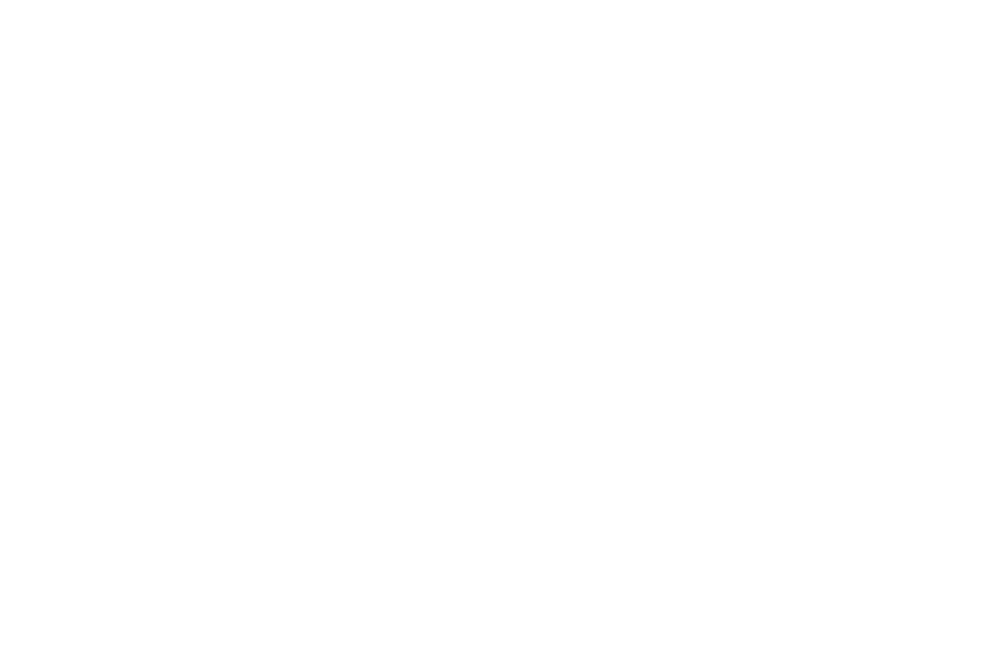

DONE
TS  42683474 

<IPython.core.display.Javascript object>


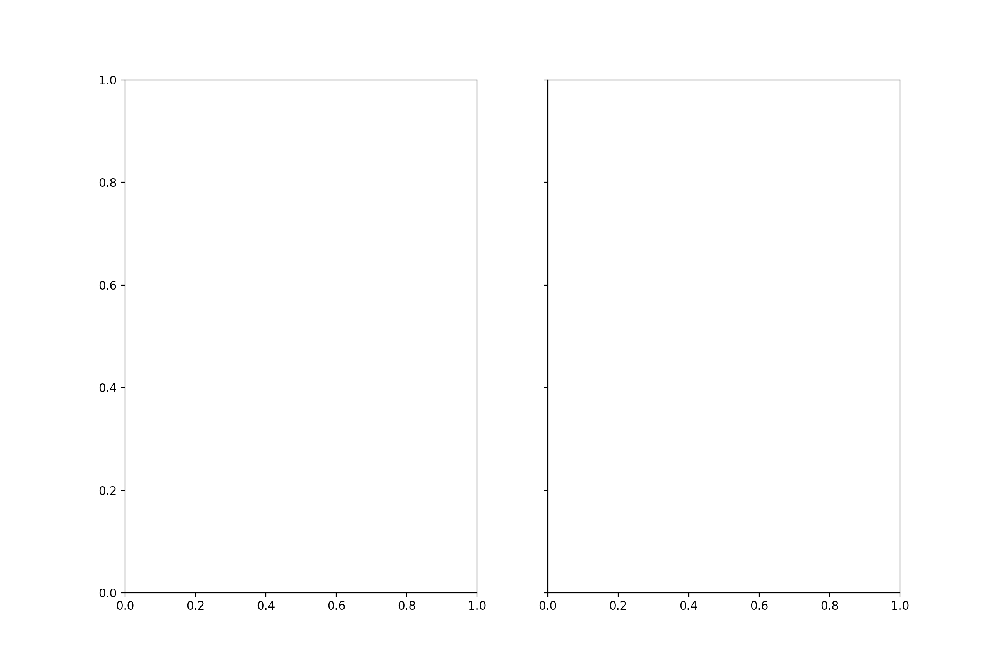

TS  43243874 

<IPython.core.display.Javascript object>


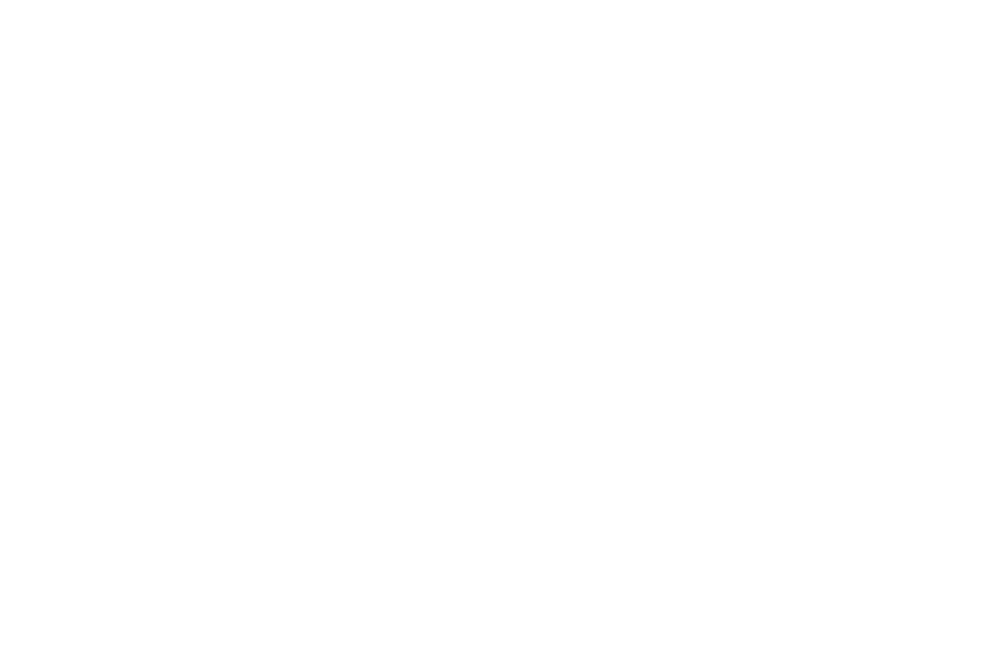

DONE
TS  44928303 

<IPython.core.display.Javascript object>


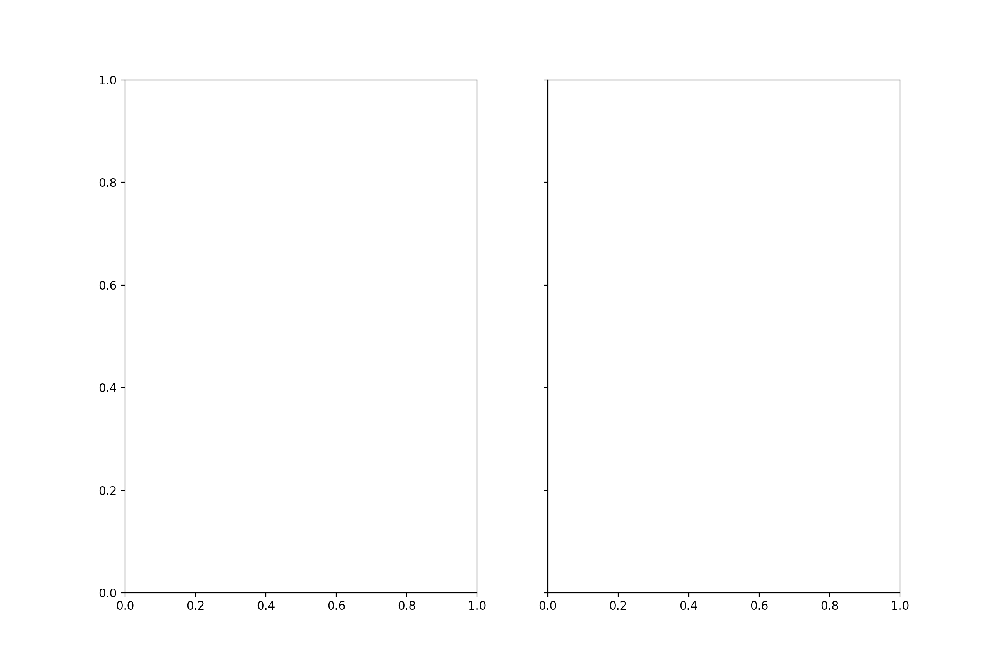

TS  45488702 

<IPython.core.display.Javascript object>


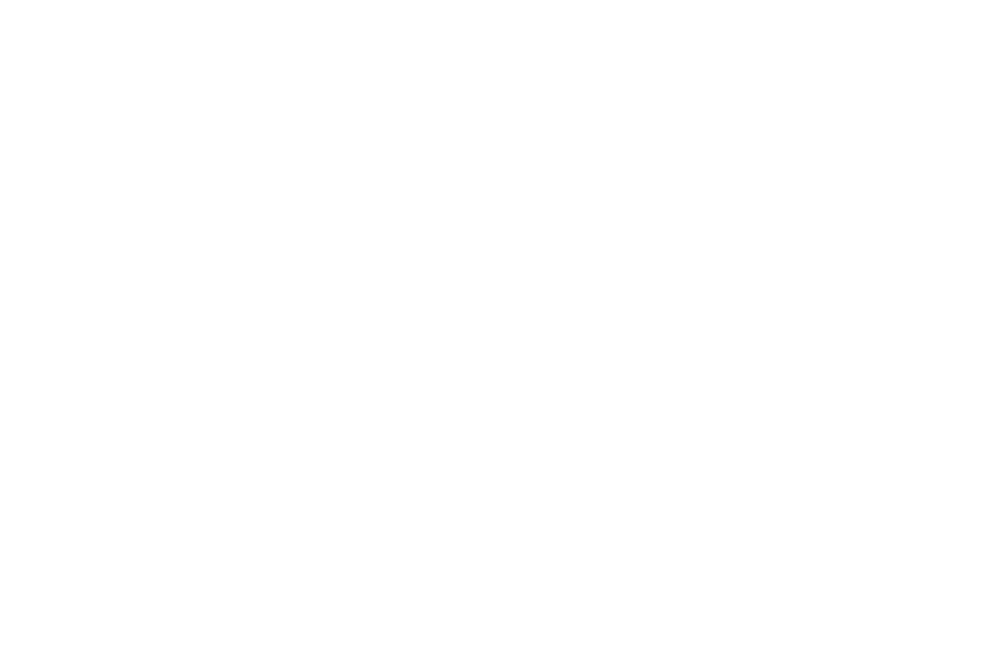

DONE
TS  46211816 

<IPython.core.display.Javascript object>


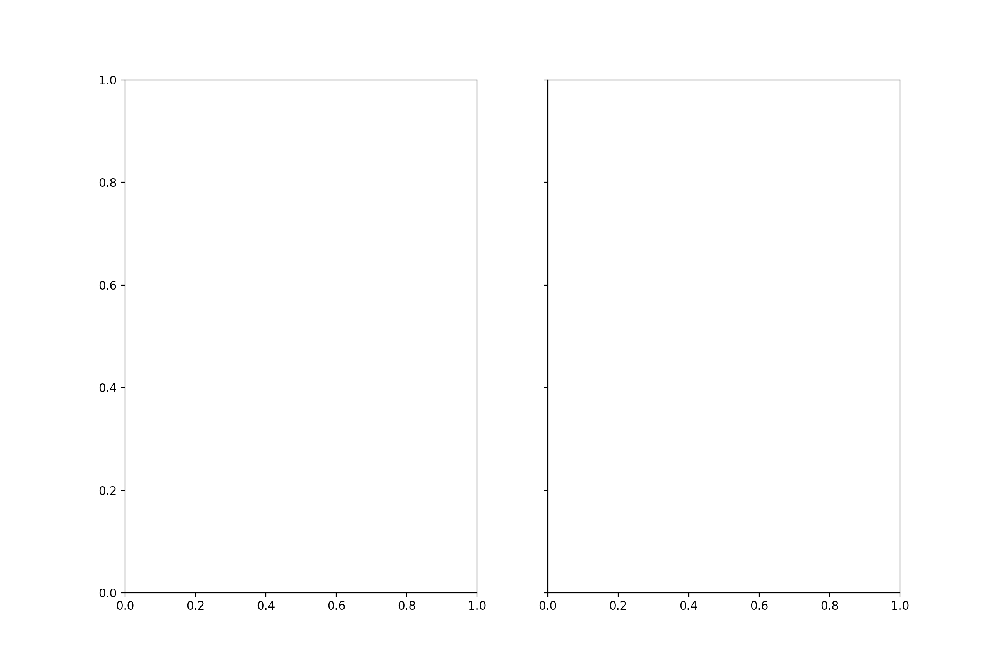

TS  46772215 

<IPython.core.display.Javascript object>


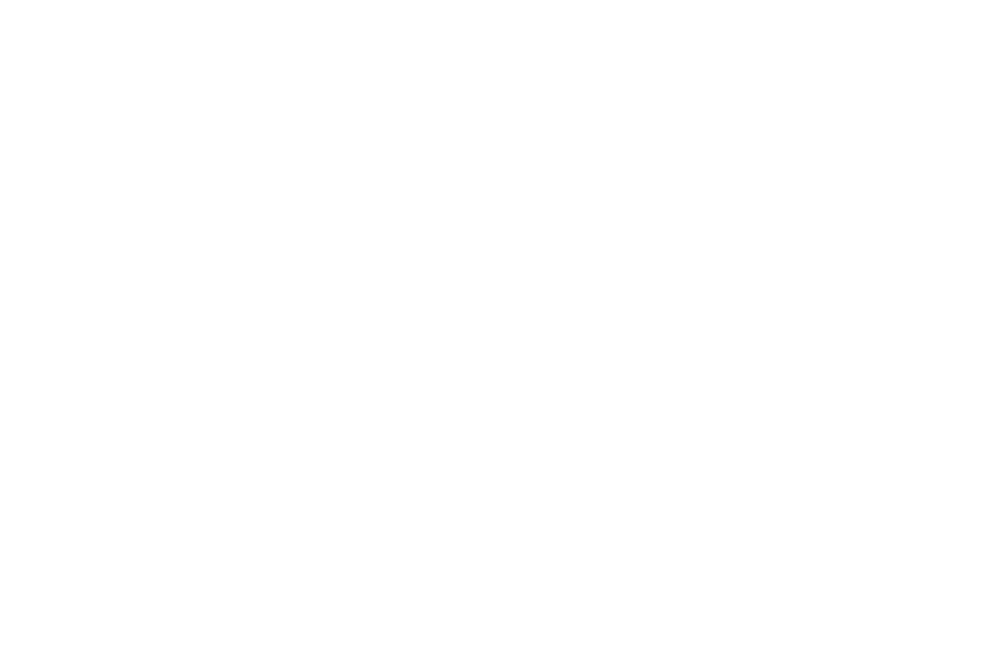

DONE
SKIPPING 46772216
TS  47098080 

<IPython.core.display.Javascript object>


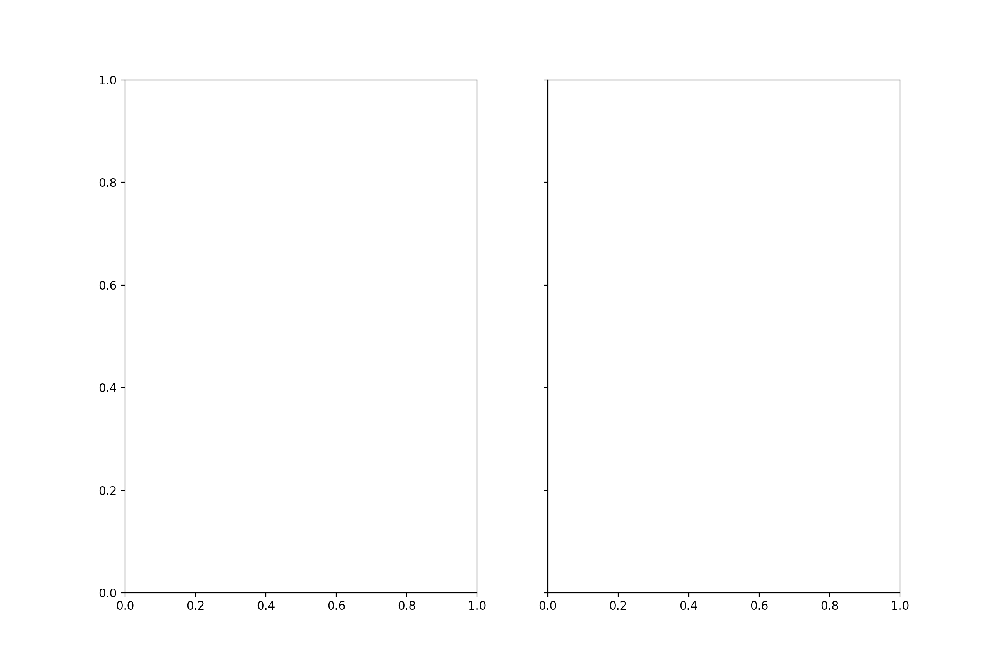

TS  47658480 

<IPython.core.display.Javascript object>


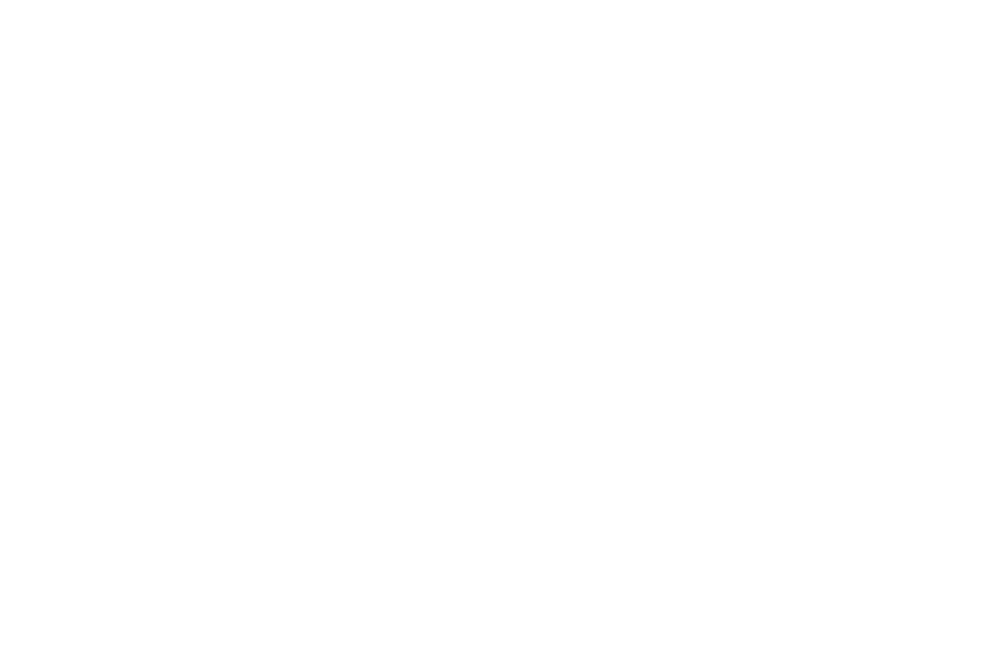

DONE
TS  50905616 

<IPython.core.display.Javascript object>


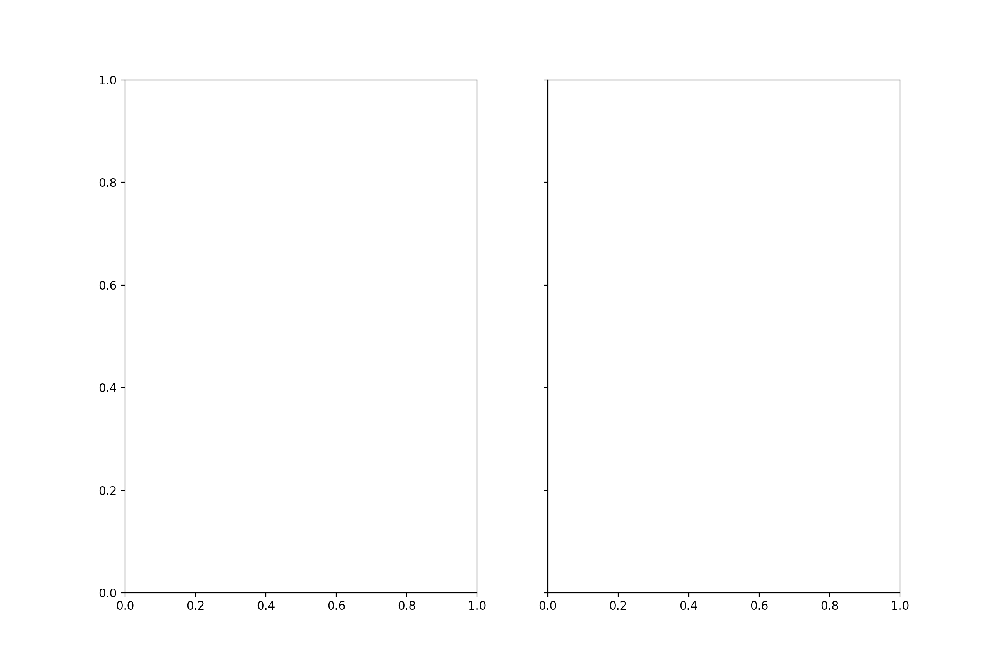

TS  51466016 

<IPython.core.display.Javascript object>


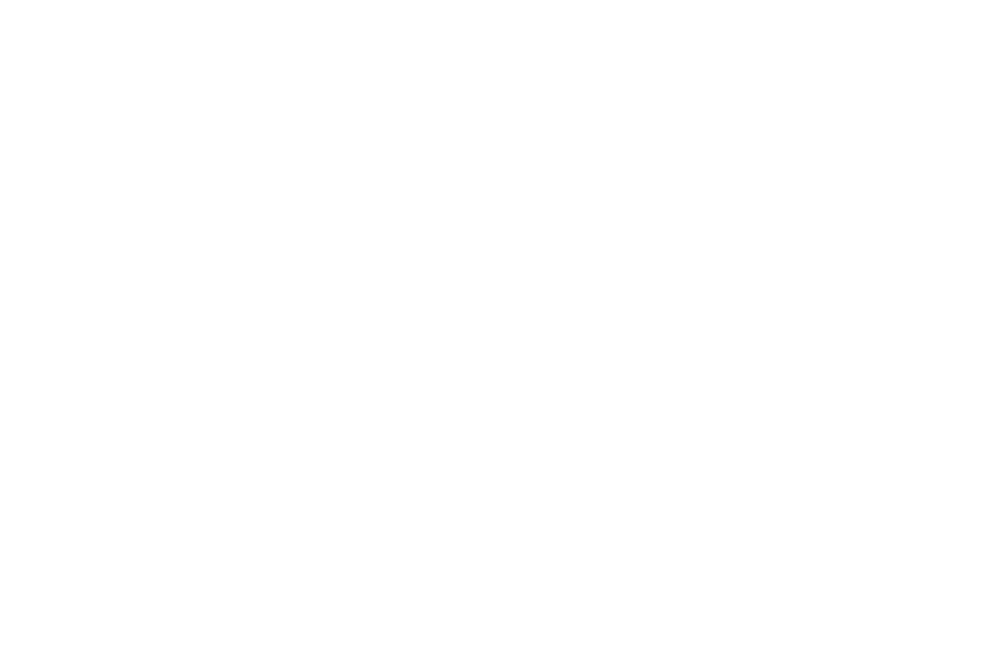

DONE
TS  54053252 

<IPython.core.display.Javascript object>


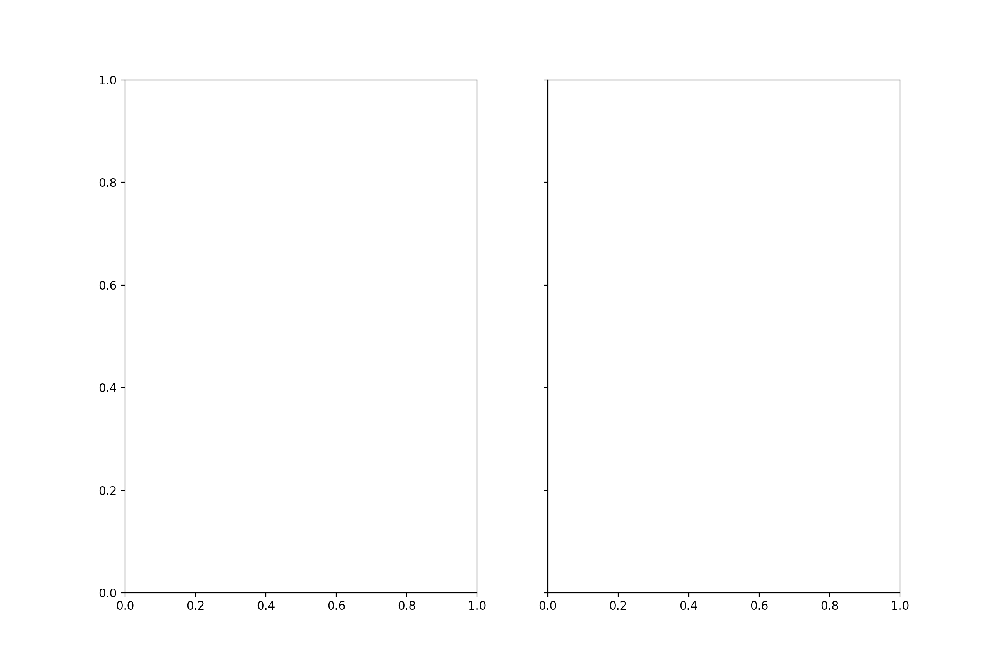

TS  54613651 

<IPython.core.display.Javascript object>


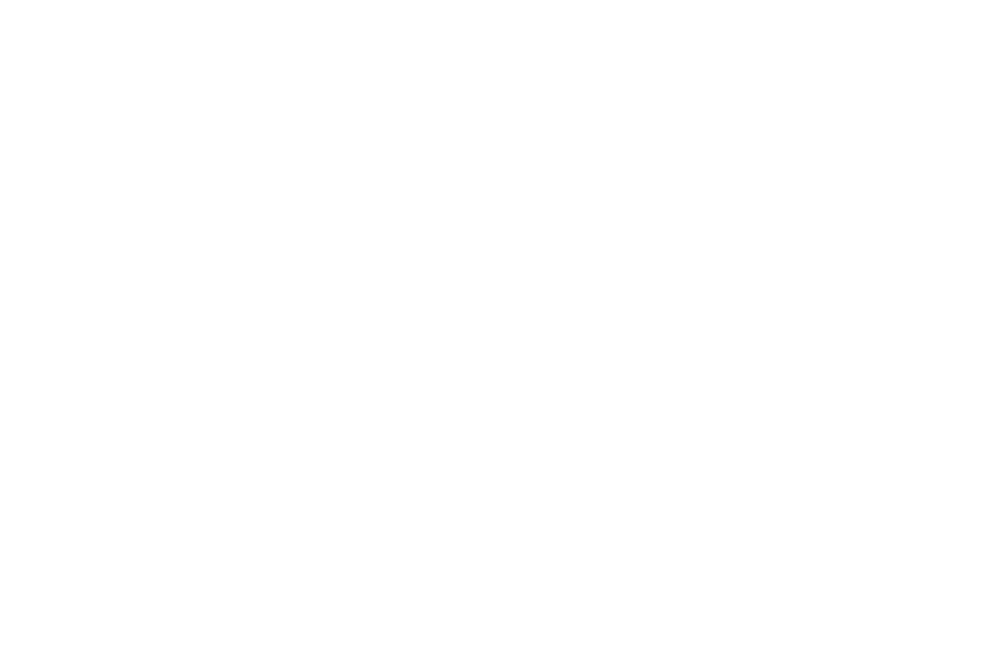

DONE
SKIPPING 54613652
TS  57758527 

<IPython.core.display.Javascript object>


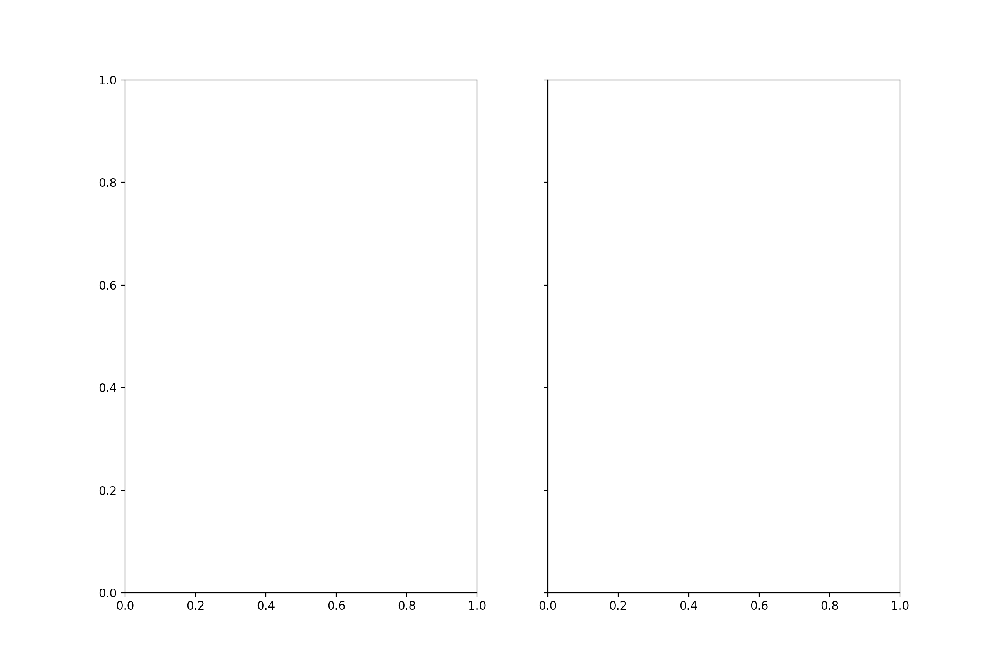

TS  58318926 

<IPython.core.display.Javascript object>


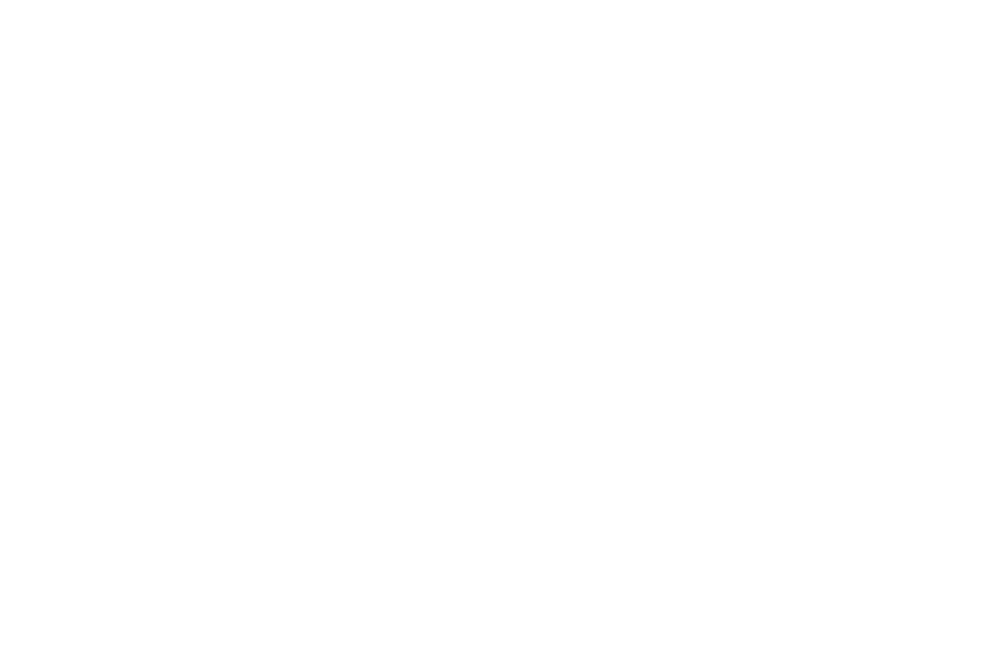

DONE
SKIPPING 58318927
TS  62768356 

<IPython.core.display.Javascript object>


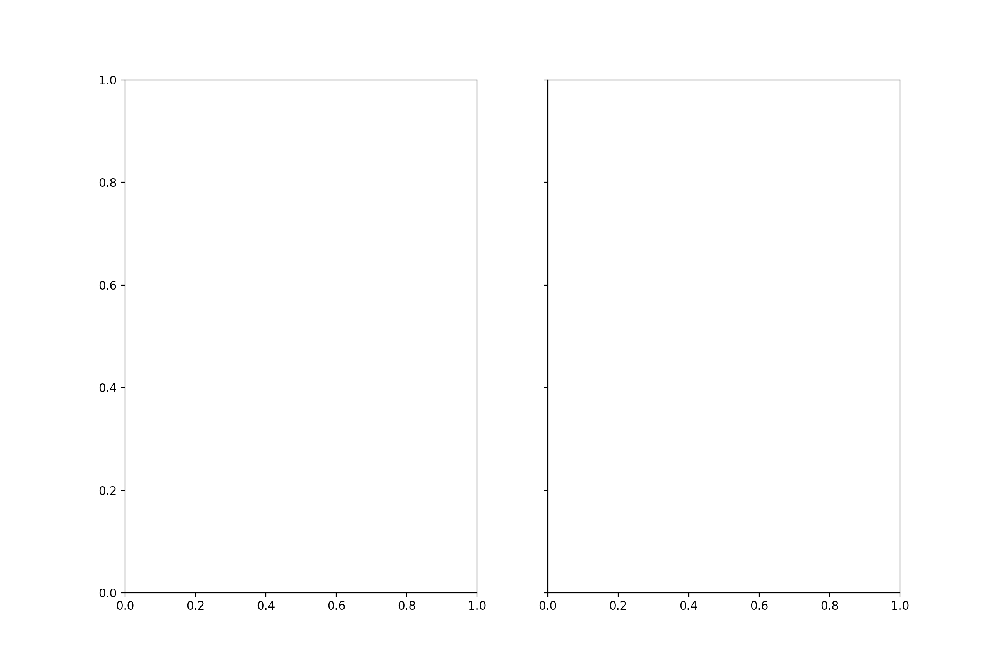

TS  63328755 

<IPython.core.display.Javascript object>


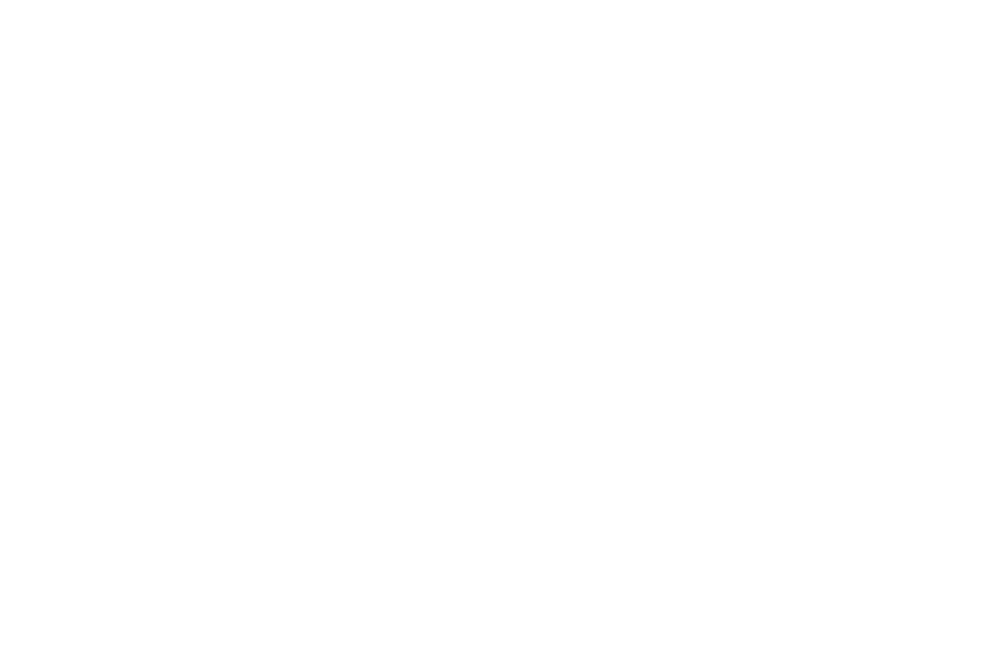

DONE
SKIPPING 63328756
TS  69416216 

<IPython.core.display.Javascript object>


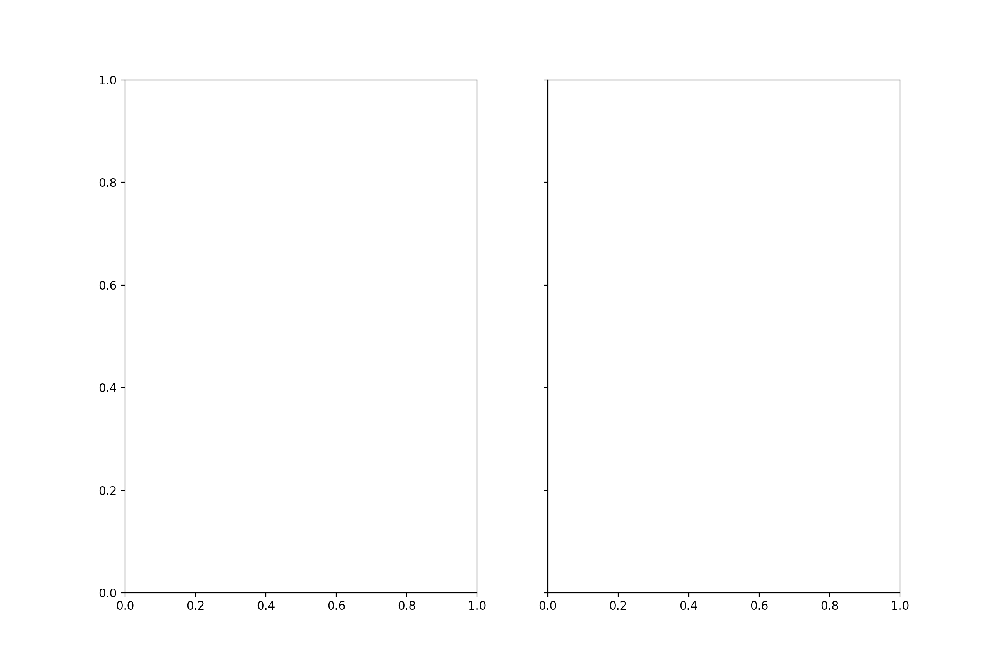

TS  69976615 

<IPython.core.display.Javascript object>


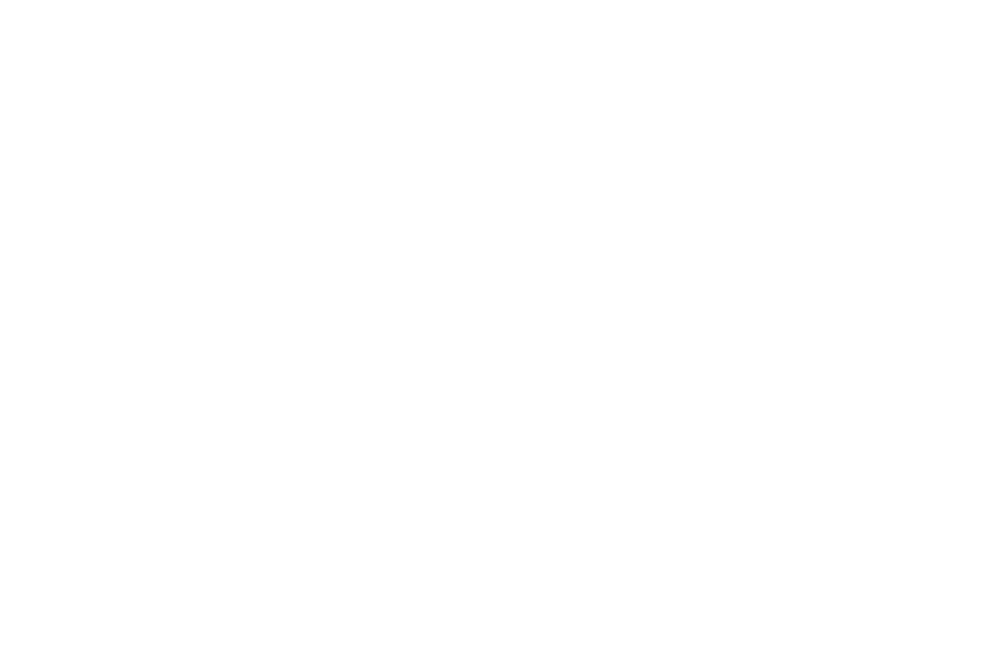

DONE
SKIPPING 69976616
TS  70484880 

<IPython.core.display.Javascript object>


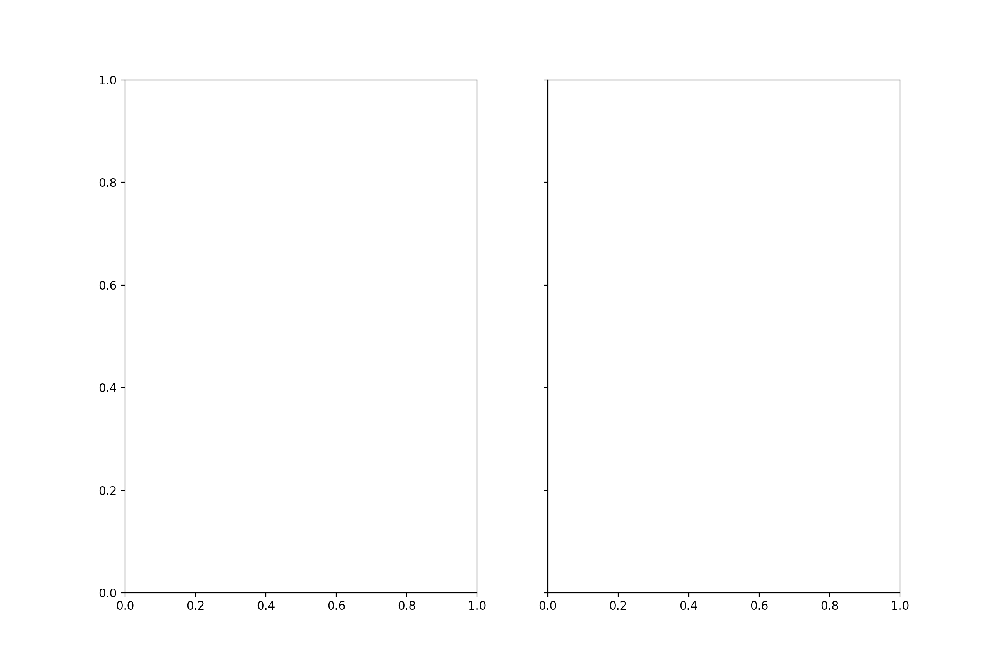

TS  70668345 

<IPython.core.display.Javascript object>


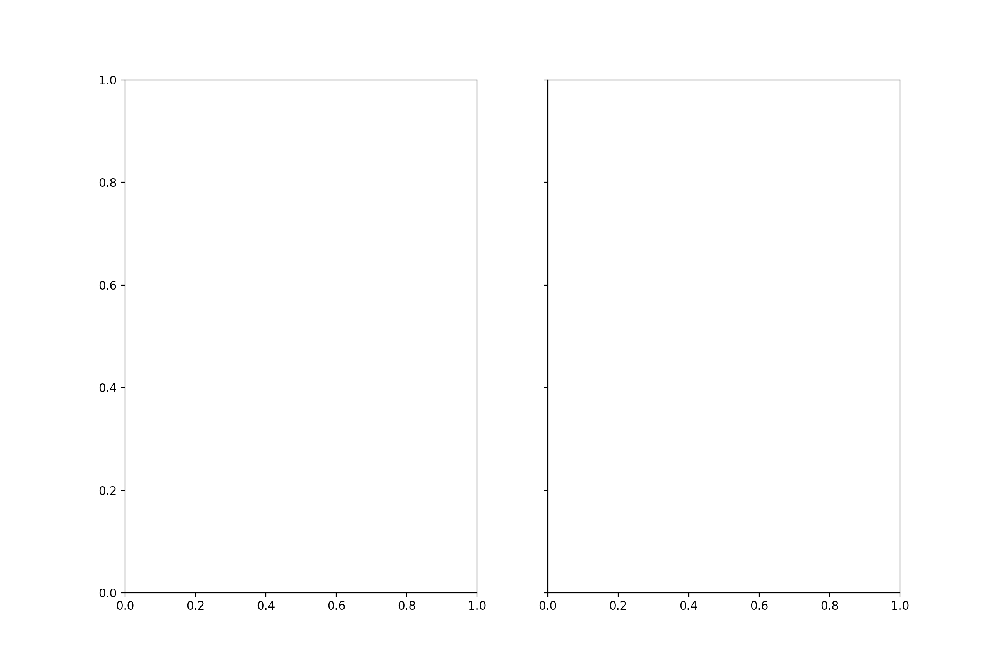

TS  70713434 

<IPython.core.display.Javascript object>


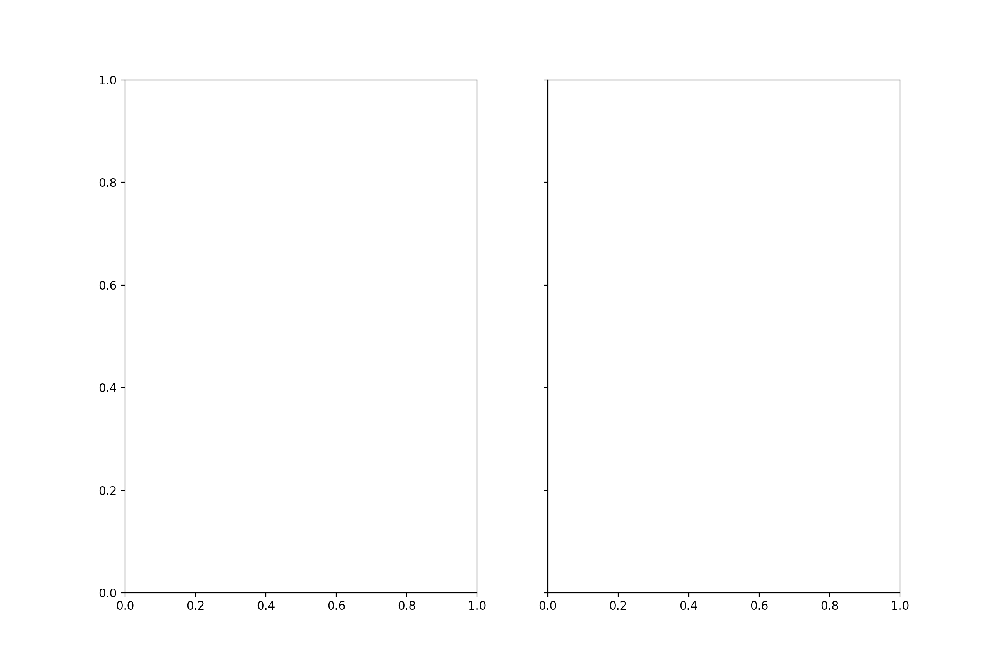

TS  70873850 

<IPython.core.display.Javascript object>


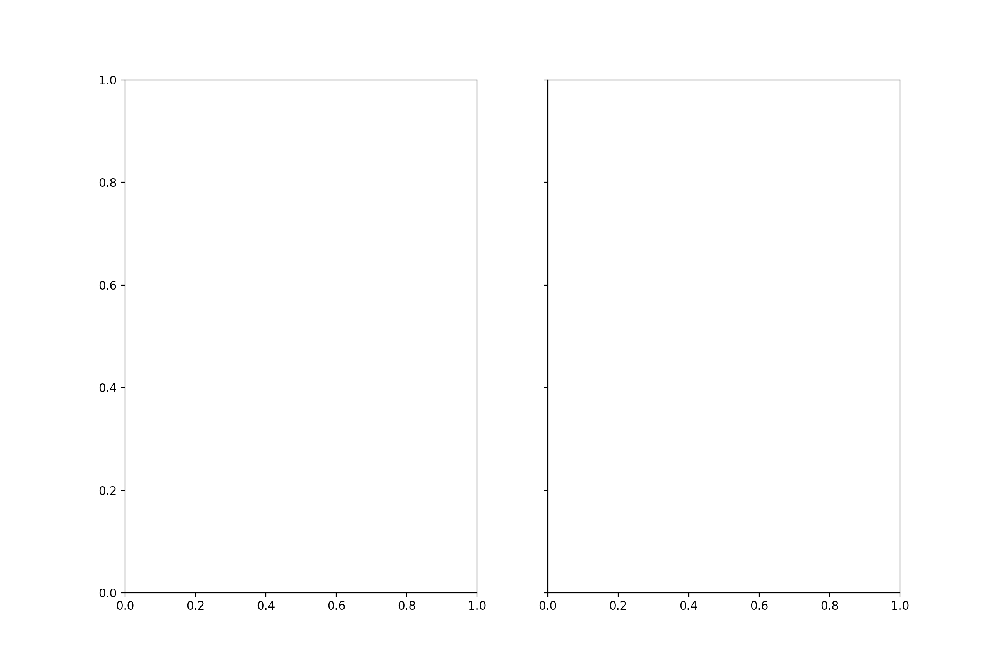

TS  71045279 

<IPython.core.display.Javascript object>


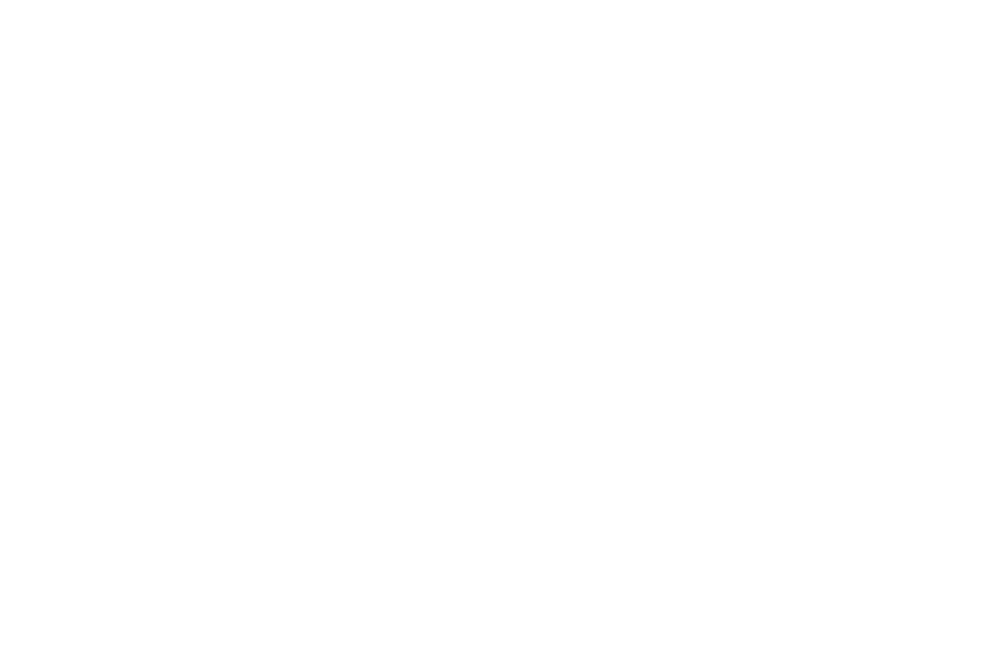

DONE
SKIPPING 71045280
TS  71228744 

<IPython.core.display.Javascript object>


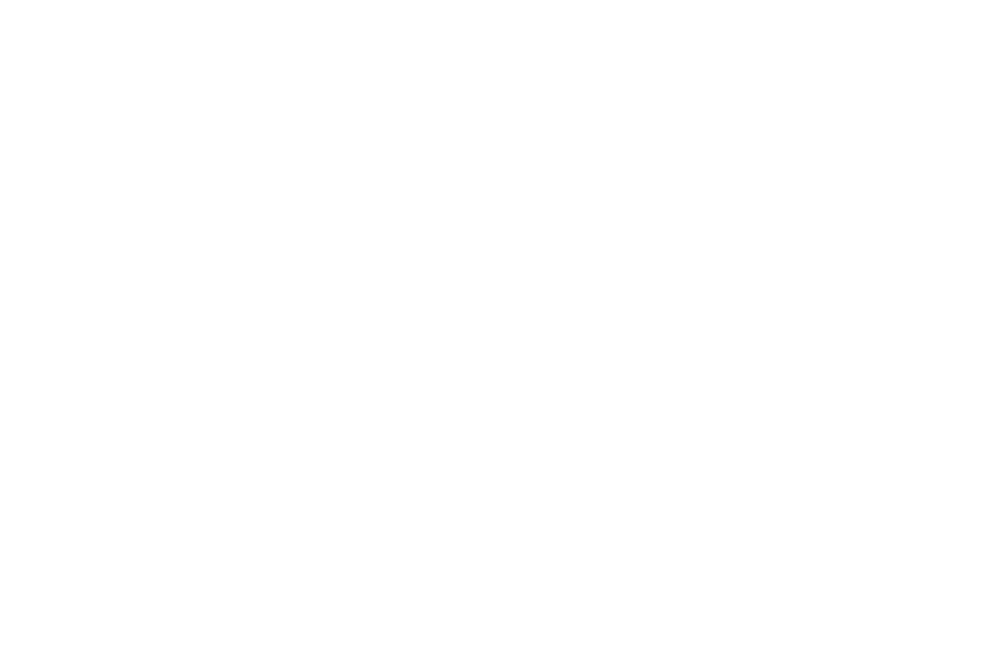

DONE
SKIPPING 71228745
TS  71273833 

<IPython.core.display.Javascript object>


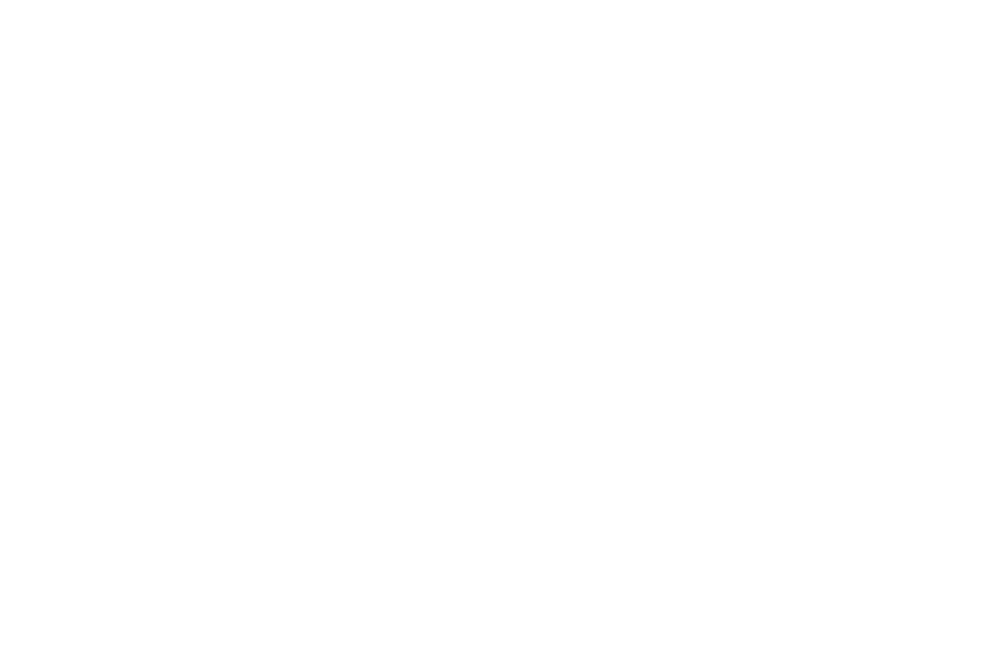

DONE
SKIPPING 71273834
TS  71434249 

<IPython.core.display.Javascript object>


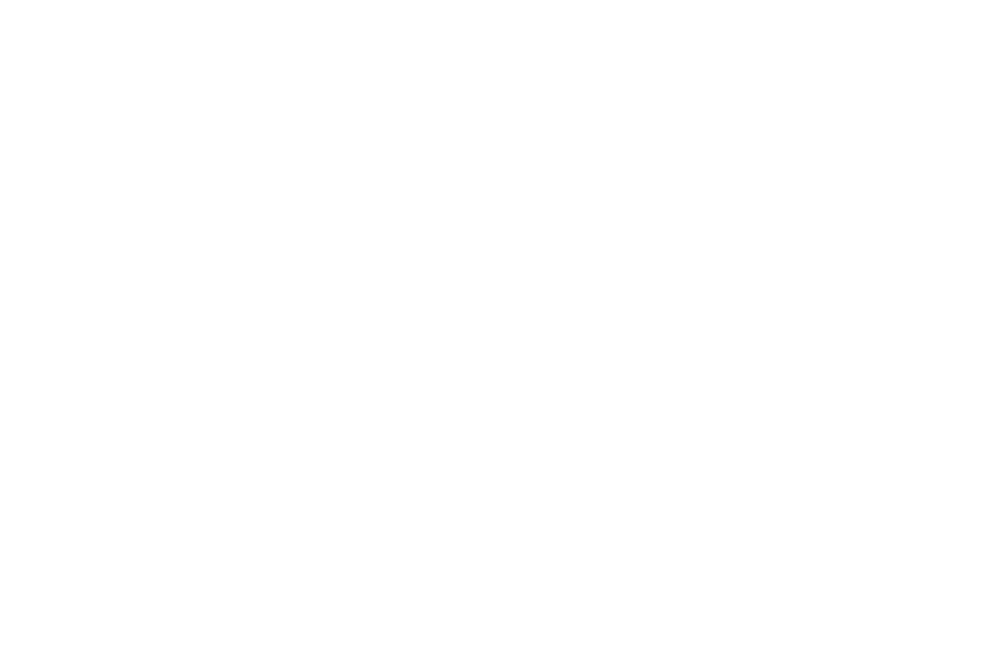

DONE
SKIPPING 71434250
TS  73020508 

<IPython.core.display.Javascript object>


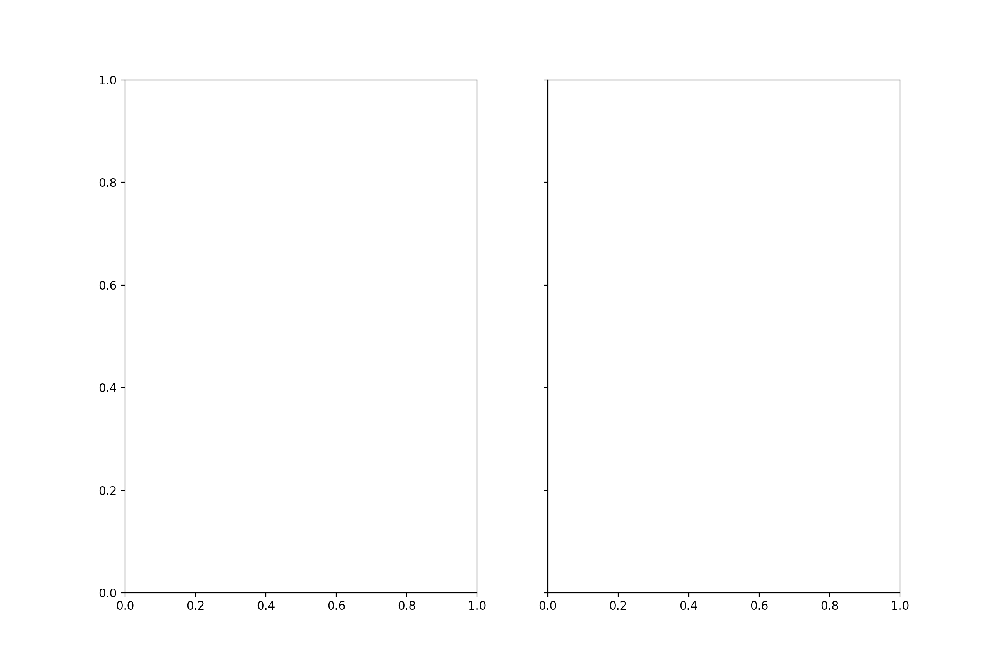

TS  73580907 

<IPython.core.display.Javascript object>


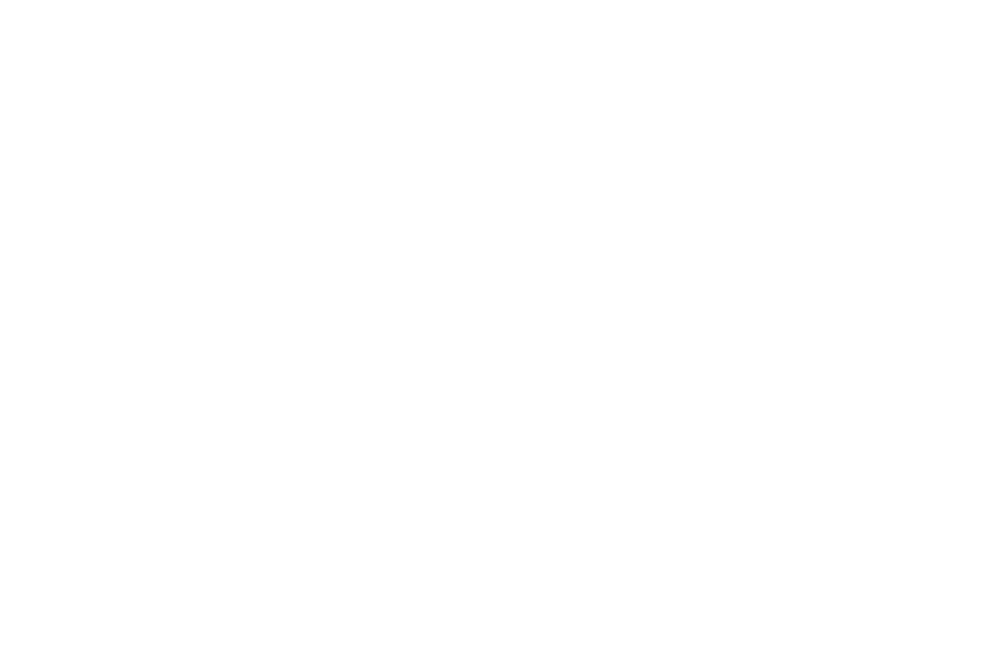

DONE
SKIPPING 73580908
TS  73998539 

<IPython.core.display.Javascript object>


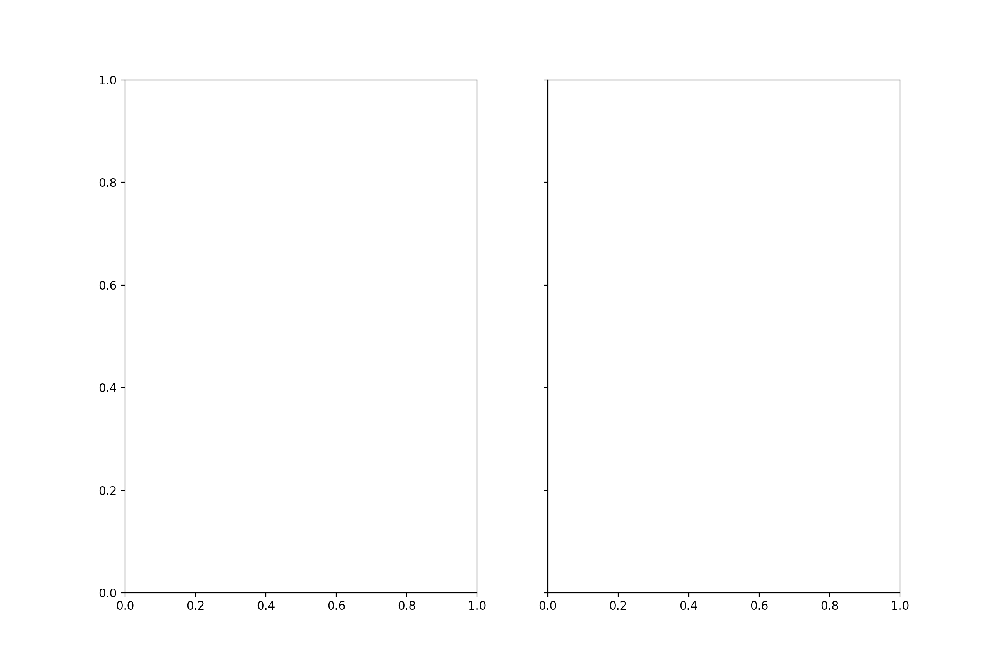

TS  74109048 

<IPython.core.display.Javascript object>


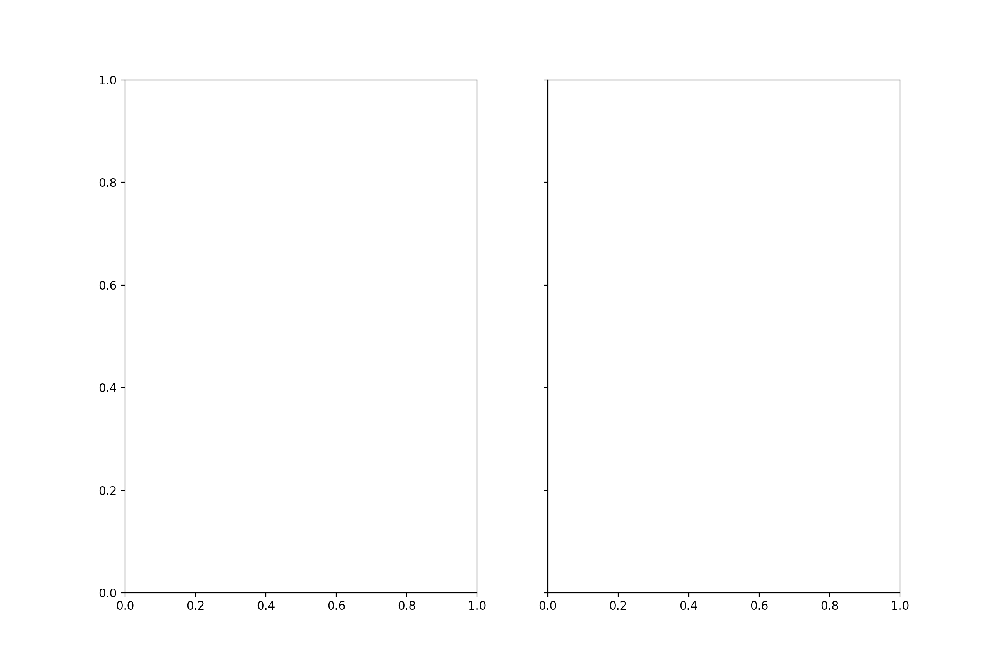

TS  74558938 

<IPython.core.display.Javascript object>


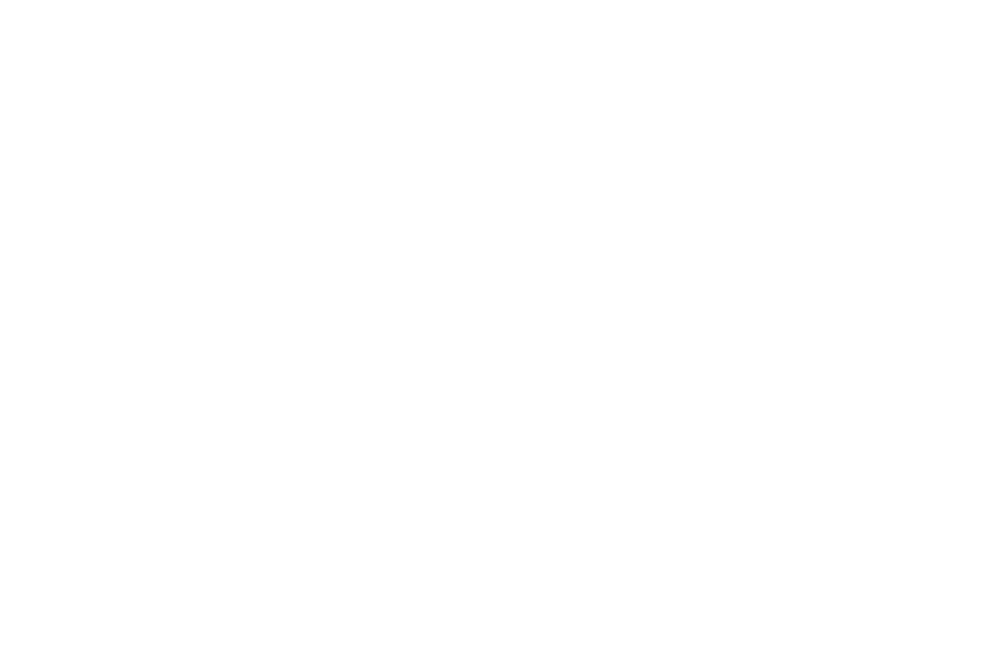

DONE
SKIPPING 74558939
TS  74669448 

<IPython.core.display.Javascript object>


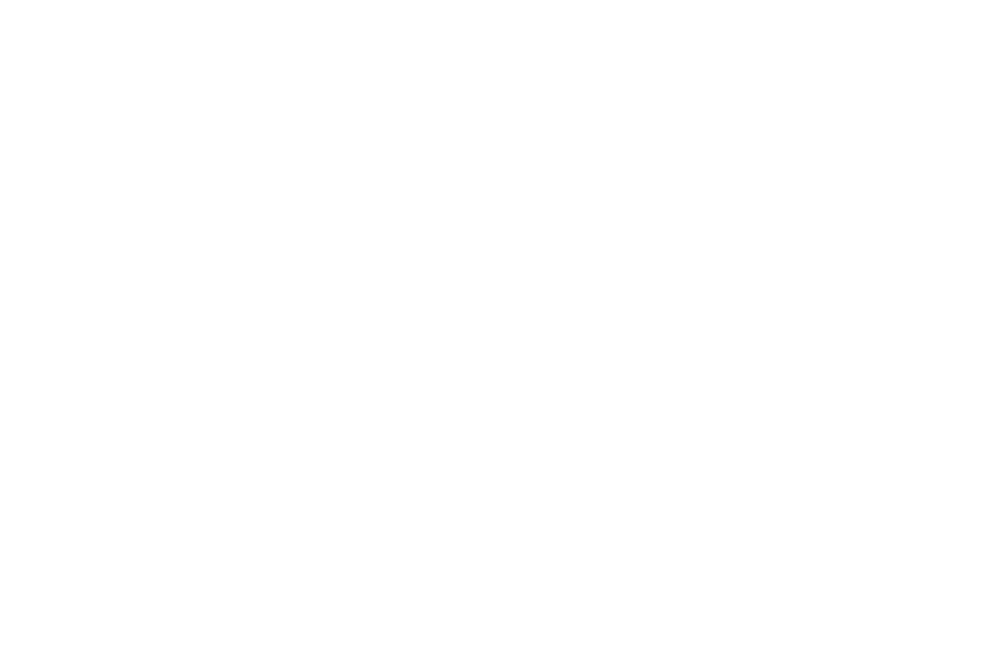

DONE
TS  74941680 

<IPython.core.display.Javascript object>


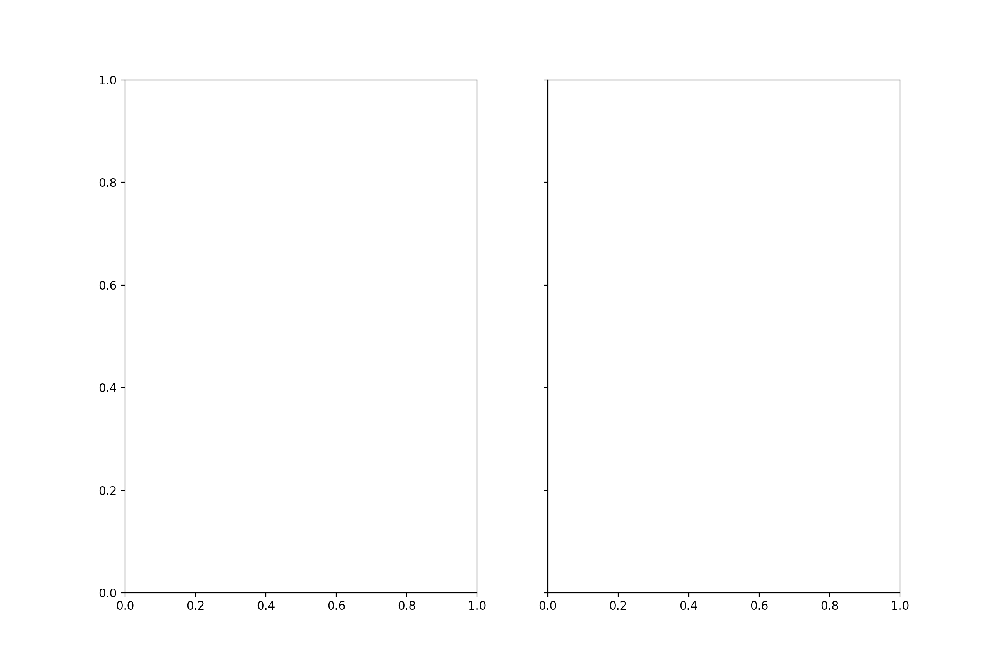

TS  75502079 

<IPython.core.display.Javascript object>


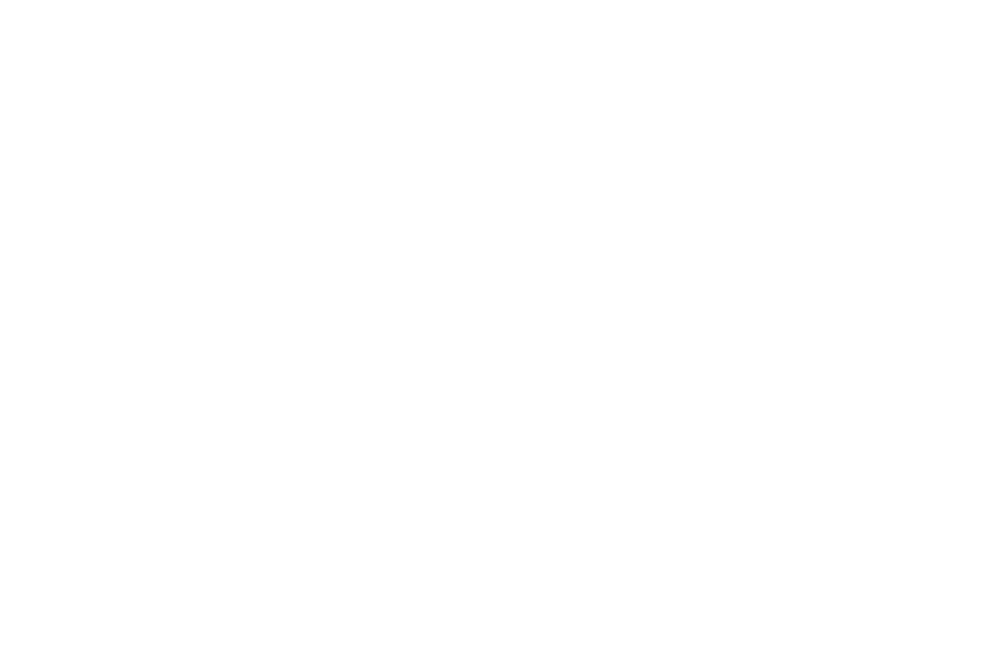

DONE
SKIPPING 75502080
TS  77618560 

<IPython.core.display.Javascript object>


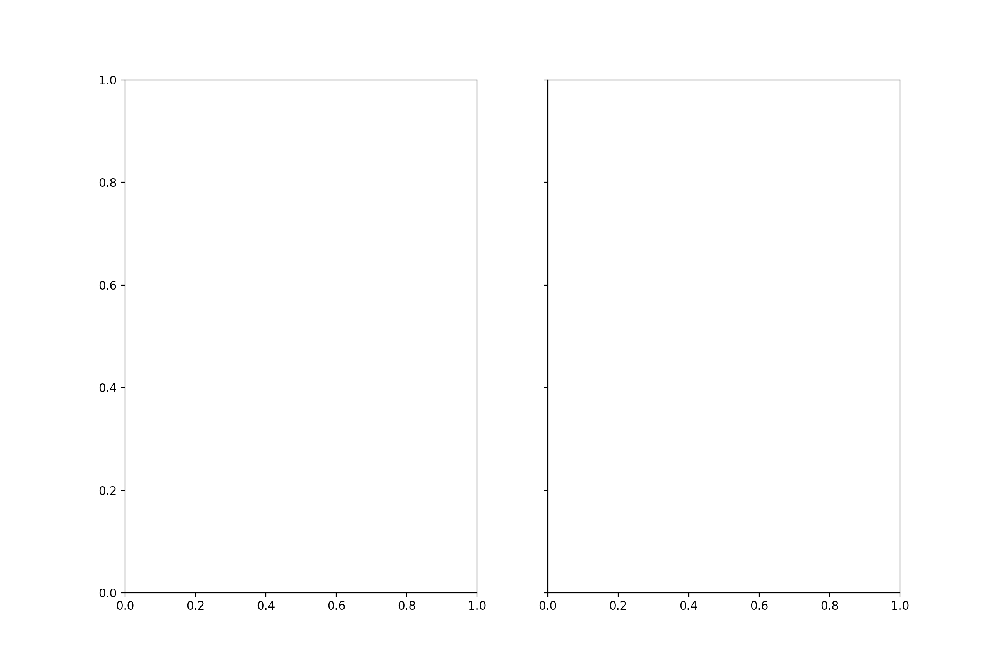

TS  78178959 

<IPython.core.display.Javascript object>


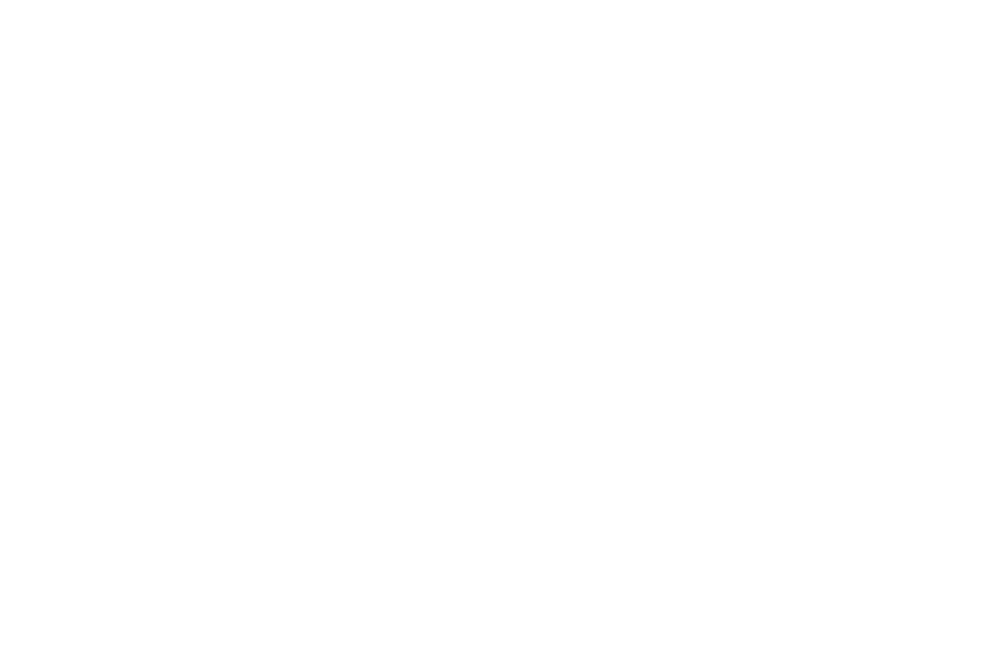

DONE
SKIPPING 78178960
TS  82061437 

<IPython.core.display.Javascript object>


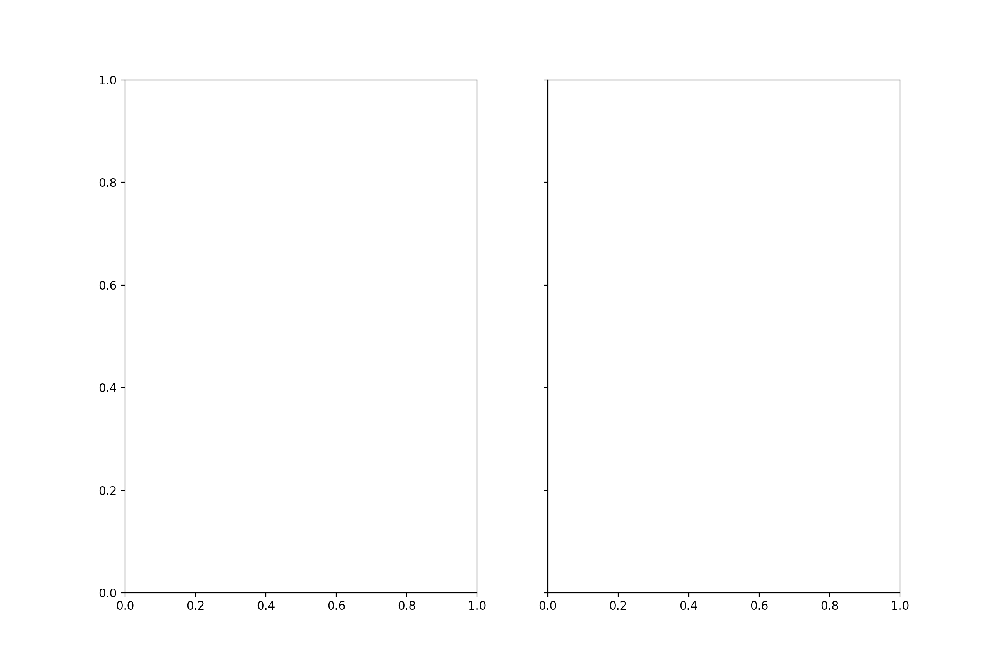

TS  82621836 

<IPython.core.display.Javascript object>


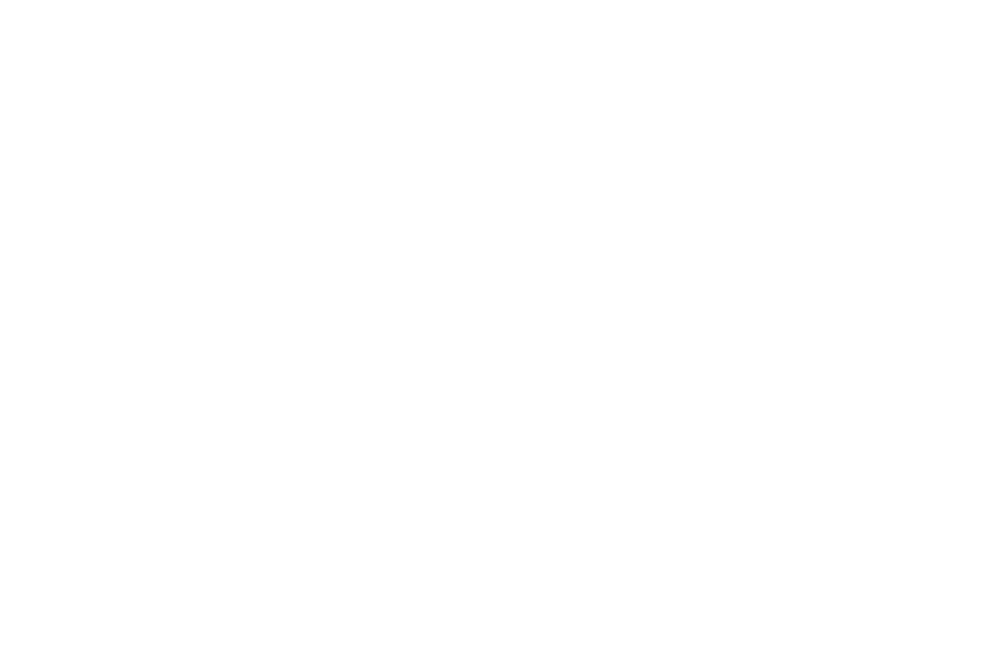

DONE
SKIPPING 82621837
TS  82973778 

<IPython.core.display.Javascript object>


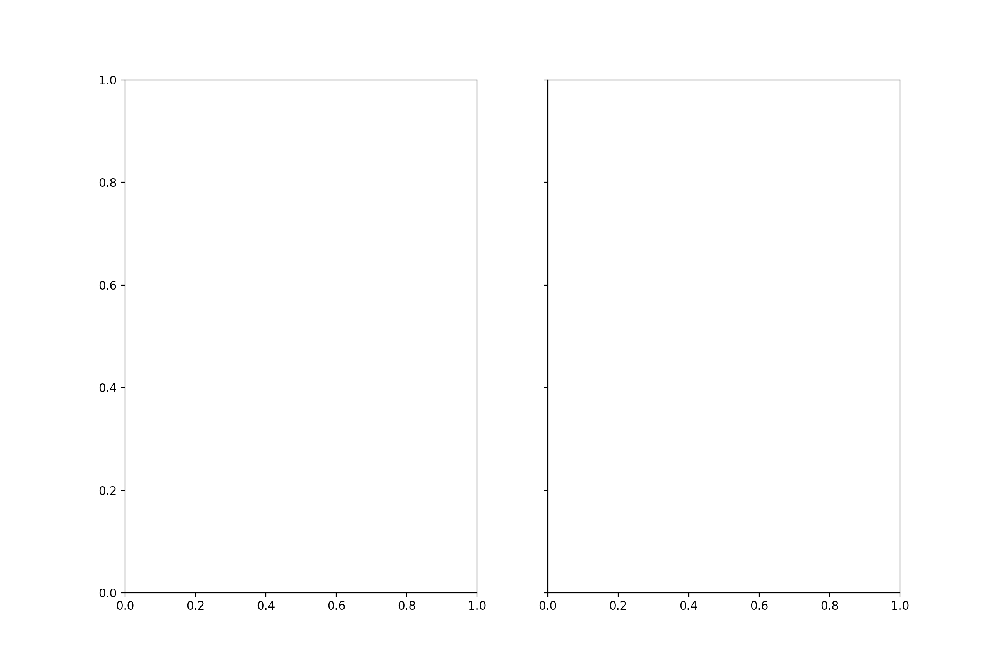

TS  83534177 

<IPython.core.display.Javascript object>


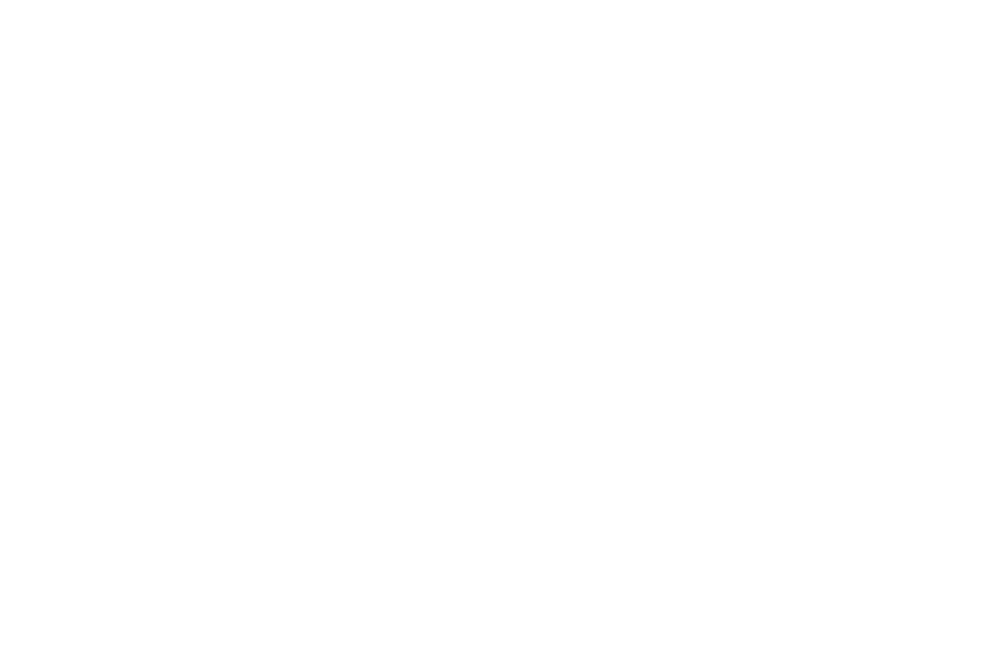

DONE
SKIPPING 83534178


In [89]:
pdf = matplotlib.backends.backend_pdf.PdfPages("output_ts.pdf")
last_ts = None
for i, ts in enumerate(np.unique(clean_ts_tot)):
    if (i == 100):
        break
    if (last_ts is not None and last_ts+1 == ts):
        print("SKIPPING {}".format(ts))
        continue
    print("TS ", ts, end=" ")
    plot_comps = plot_event_ts(ts, marocdata)
    if (plot_comps is None):    
        continue
    pdf.savefig(fig)
    plt.close(fig)
   
    fig, ax1, ax2 = plot_comps
    print("DONE")
    last_ts = ts
pdf.close()
plt.close()

In [113]:
b18 = marocdata.get_board(18)
for i in range(10):
    if i in b18:
        print(i, b18.get_event(i).TS-22951763)

2 560400
3 6367102
4 7434039
5 13263594
6 13835849
7 16455290
8 17481501
9 21934921


In [118]:
b18.get_event(2).TS-560400

22951763

In [108]:
b8 = marocdata.get_board(8)
for i in range(10):
    if i in b8:
        print(i, b8.get_event(i).TS-b8.get_event(1).TS)

1 0
2 560400
3 6367101
4 7434038
5 13263594
6 13835848
7 16455290
8 17481501
9 21934921


In [13]:
marocdata.get_board(8).events

{3892952924: Event(3892952924),
 1: Event(1),
 2: Event(2),
 3: Event(3),
 4: Event(4),
 5: Event(5),
 6: Event(6),
 7: Event(7),
 8: Event(8),
 9: Event(9),
 10: Event(10),
 11: Event(11),
 12: Event(12),
 13: Event(13),
 14: Event(14),
 15: Event(15),
 16: Event(16),
 17: Event(17),
 18: Event(18),
 19: Event(19),
 20: Event(20),
 21: Event(21),
 22: Event(22),
 23: Event(23),
 24: Event(24),
 25: Event(25),
 26: Event(26),
 27: Event(27),
 28: Event(28),
 29: Event(29),
 30: Event(30),
 31: Event(31),
 32: Event(32),
 33: Event(33),
 34: Event(34),
 35: Event(35),
 36: Event(36),
 37: Event(37),
 38: Event(38),
 39: Event(39),
 40: Event(40),
 41: Event(41),
 42: Event(42),
 43: Event(43),
 44: Event(44),
 45: Event(45),
 46: Event(46),
 47: Event(47),
 48: Event(48),
 49: Event(49),
 50: Event(50),
 51: Event(51),
 52: Event(52),
 53: Event(53),
 54: Event(54),
 55: Event(55),
 56: Event(56),
 57: Event(57),
 58: Event(58),
 59: Event(59),
 60: Event(60),
 61: Event(61),
 62: Event

In [12]:
marocdata.get_board(18)._timestamps

array([4273783853,          0,     560399, ..., 2569044612, 2569640801,
       2574019134], dtype=uint32)

In [99]:
 marocdata.get_board(8)._timestamps

array([3857454605,          0,     560400, ..., 2574851315, 2575447504,
       2579825837], dtype=uint32)

In [10]:
clean_ts = marocdata.get_clean_ts()

In [11]:
clean_ts

[(1,
  array([4192547028,          0,     560399, ..., 2572197710, 2574851315,
         2575447503], dtype=uint32)),
 (2,
  array([4155181435,          0,     560400, ..., 2572197711, 2574851315,
         2575447504], dtype=uint32)),
 (3,
  array([4250240749,          0,     560400, ..., 2572197711, 2574851315,
         2575447504], dtype=uint32)),
 (4,
  array([4055412391,          0,     560400, ..., 2572197711, 2574851315,
         2575447504], dtype=uint32)),
 (5,
  array([4010752061,          0,     560400, ..., 2572197711, 2574851315,
         2575447504], dtype=uint32)),
 (6,
  array([3948555251,          0,     560400, ..., 2572197711, 2574851315,
         2575447504], dtype=uint32)),
 (7,
  array([3902555260,          0,     560400, ..., 2575447504, 2579825837,
         2581979960], dtype=uint32)),
 (8,
  array([3857454605,          0,     560400, ..., 2574851315, 2575447504,
         2579825837], dtype=uint32)),
 (9,
  array([3431225627,          0,     560399, ..., 257219771

In [13]:
clean_ts[17][1][1]=0

In [14]:
clean_ts[17][1]

array([4268537550,          0,     560399, ..., 2569044612, 2569640801,
       2574019134], dtype=uint32)

In [21]:
for bid, tss in clean_ts[1:]:
    if tss[2]==clean_ts[0][1][2] or tss[2]==clean_ts[0][1][2]+1 or tss[2]==clean_ts[0][1][2]-1:
        print(tss)
        continue
    else:
        start = tss[2]-clean_ts[0][1][2]
        tss_corrected = tss-start
        print(tss_corrected)
        

[4155181435          0     560400 ... 2572197711 2574851315 2575447504]
[4250240749          0     560400 ... 2572197711 2574851315 2575447504]
[4055412391          0     560400 ... 2572197711 2574851315 2575447504]
[4010752061          0     560400 ... 2572197711 2574851315 2575447504]
[3948555251          0     560400 ... 2572197711 2574851315 2575447504]
[3902555260          0     560400 ... 2575447504 2579825837 2581979960]
[3857454605          0     560400 ... 2574851315 2575447504 2579825837]
[3431225627          0     560399 ... 2572197710 2574851315 2575447503]
[3725026357          0     560399 ... 2575447504 2579825837 2581979960]
[3716435925          0     560399 ... 2575447504 2579825837 2581979960]
[3659253725          0     560399 ... 2575447503 2579825837 2581979960]
[3621061356          0     560400 ... 2575447504 2579825837 2581979960]
[3565828275          0     560400 ... 2575447504 2579825837 2581979960]
[3491695956          0     560400 ... 2575447504 2579825837 2581

In [10]:
marocdata.get_board(8).get_event(1).TS

38605119

In [11]:
marocdata.get_board(8).clean_timestamps

KeyError: 0